In [ ]:
from obspy import UTCDateTime
from obspy.clients.fdsn import Client
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from heterogeneities.processing import  compute_spectrogram
from obspy import UTCDateTime
from obspy import Trace
from heterogeneities.io import plot_spectrogram_title

In [ ]:
from obspy import UTCDateTime
from obspy.clients.fdsn import Client
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from heterogeneities.processing import  compute_spectrogram
from obspy import UTCDateTime
from obspy import Trace
from heterogeneities.io import plot_spectrogram_title
def linear_interpolation(trace, interpolation_limit: int | None = 1):
    data = np.asarray(trace.data, dtype=float)
    is_gap = (data == -1.0)
    data[is_gap] = np.nan

    s = pd.Series(data)
    s.interpolate(
        method="linear",
        limit=interpolation_limit,
        limit_direction="both",
        limit_area="inside",
        inplace=True,
    )
    s.fillna(method="ffill", inplace=True)
    s.fillna(method="bfill", inplace=True)
    s.fillna(0.0, inplace=True)

    trace.data = s.to_numpy(dtype=float)  
    return is_gap

# --- 0) INPUTS ----------------------------------------------------------
station = "S14"
channel = "SHZ"
starttime = UTCDateTime("1975-01-03T01:36:00")
endtime   = UTCDateTime("1975-01-03T01:59:00")
output_physical = "VEL"  # "DISP" | "VEL" | "ACC"

# --- 1) FDSN download --------------------------------------------------------
client = Client("IRIS")

inv = client.get_stations(
    starttime=starttime, endtime=endtime,
    network="XA", station=station, location="*", channel="SHZ",
    level="response"
)

st = client.get_waveforms(
    network="XA", station=station, location="*", channel=channel,
    starttime=starttime, endtime=endtime
)
tr = st[0].copy()
_ = linear_interpolation(tr, interpolation_limit=None)
tr_raw = tr.copy()
#tr.taper(max_percentage=0.05, type="cosine")
# --- 2) Detrend (no taper) ---------------------------------------------------
tr.detrend("demean")
tr.detrend("linear")
#tr.filter('highpass', freq=0.1, corners=4, zerophase=True)
#tr.taper(max_percentage=0.05, type='hann')

fs = tr.stats.sampling_rate
n  = tr.stats.npts
t  = np.arange(n) / fs

data = tr.data.astype(np.float64, copy=False)

# --- 3) FFT of detrended data -----------------------------------------------
nfft = n
D = np.fft.rfft(data, n=nfft)  
freqs_rfft = np.fft.rfftfreq(nfft, d=1/fs)    # Hz

# --- 4) Instrument transfer function T(f) -----------------------------------
resp = inv.get_response(tr.id, tr.stats.starttime)
H, response_freqs = resp.get_evalresp_response(
    t_samp=1.0/fs, nfft=nfft, output=output_physical, 
)  


U = (D / (H ))                                # corrected spectrum
# Example: Zero out frequencies below a threshold (e.g., 0.2 Hz)
#freq_threshold = 0.1  # Hz

mask = (response_freqs >10) | (response_freqs <0.1)
#mask = response_freqs < freq_threshold
U_filtered = U.copy()
U_filtered[mask] = 0


u = np.fft.irfft(U_filtered, n=n)
tr_u = Trace(data=u, header=tr.stats)
#tr_u.filter('bandpass',freqmin=0.1, freqmax=12, corners=4, zerophase=True)




# --- 6) Plotting -------------------------------------------------------------
fig, axes = plt.subplots(6, 1, figsize=(12, 13), constrained_layout=True)

# Raw counts
axes[0].plot(t, tr_raw.data, color="gray")
axes[0].set_title("Raw Trace (Digital Units)")
axes[0].set_xlabel("Time [s]")
axes[0].set_ylabel("DU")

# Detrended counts
axes[1].plot(t, tr.data, color="blue")
axes[1].set_title("Detrended Trace (Digital Units)")
axes[1].set_xlabel("Time [s]")
axes[1].set_ylabel("DU")

# Data spectrum overlaid with instrument magnitude (log–log)
ax = axes[2]
ax.loglog(freqs_rfft[1:], np.abs(D)[1:], label="|D(f)| [DU]", alpha=0.9)
ax.set_title("FFT Spectrum of Detrended Data ")
ax.set_xlabel("Frequency [Hz]")
ax.set_ylabel("|D(f)| [DU]")

# Corrected spectrum 
axes[3].loglog(response_freqs[1:], np.abs(U)[1:], color="tab:green")
axes[3].set_title(f"FFT/(Transfer Function) (Response Transfer is Instr Response) ({output_physical})")
axes[3].set_xlabel("Frequency [Hz]")
axes[3].set_ylabel("|U(f)| [target units]")

# Corrected spectrum 
axes[4].loglog(response_freqs[1:], np.abs(U_filtered)[1:], color="tab:green")
axes[4].set_title(f"FFT/(Transfer Function) (Response Transfer is Instr Response) ({output_physical})")
axes[4].set_xlabel("Frequency [Hz]")
axes[4].set_ylabel("|U(f)| [target units]")


axes[5].plot(t, tr_u.data, color="orange")
axes[5].set_title(f"Corrected Trace IFFT ({output_physical})")
axes[5].set_xlabel("Time [s]")
axes[5].set_ylabel({"DISP":"DISP","VEL":"VEL","ACC":"ACC"}[output_physical])

plt.show()
# Plot |H| (instrument response magnitude)
plt.figure(figsize=(10, 4))
plt.loglog(np.abs(response_freqs), np.abs(H), color='purple')
plt.title('Instrument Response Magnitude |H(f)|')
plt.xlabel('Frequency [Hz]')
plt.ylabel('|H(f)|')
plt.grid(True)
plt.show()



[Row 0] Station S14 | Request 1972-12-06T23:03:33.400000 → 1972-12-06T23:30:13.400000 | Dist=70.75760648688035 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1972-12-06T23:03:33.400000Z to 1972-12-06T23:30:13.400000Z  |  Event 1972-12-06T23:08:33.400000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


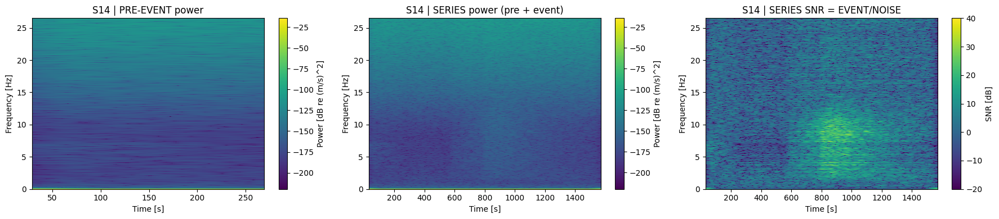

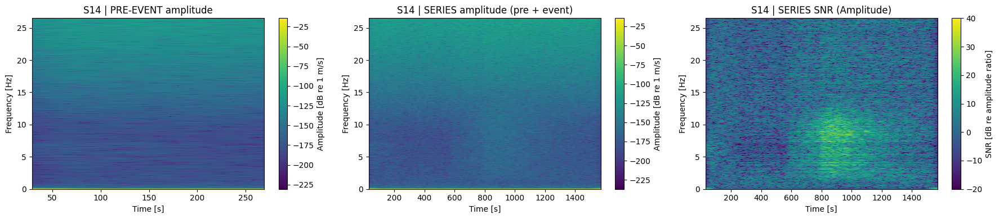

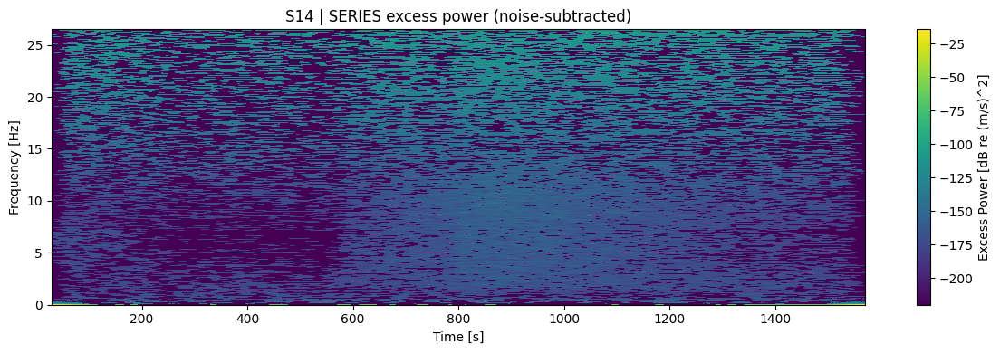

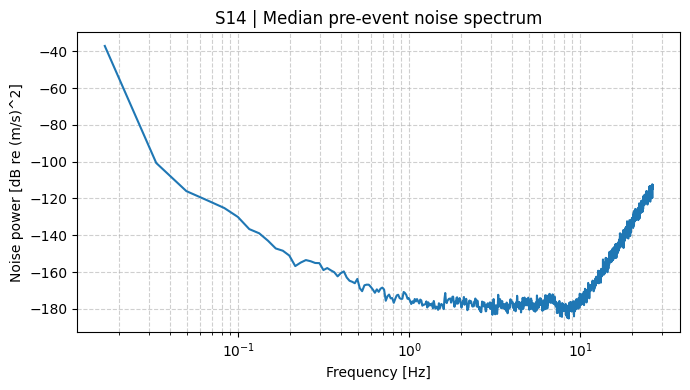

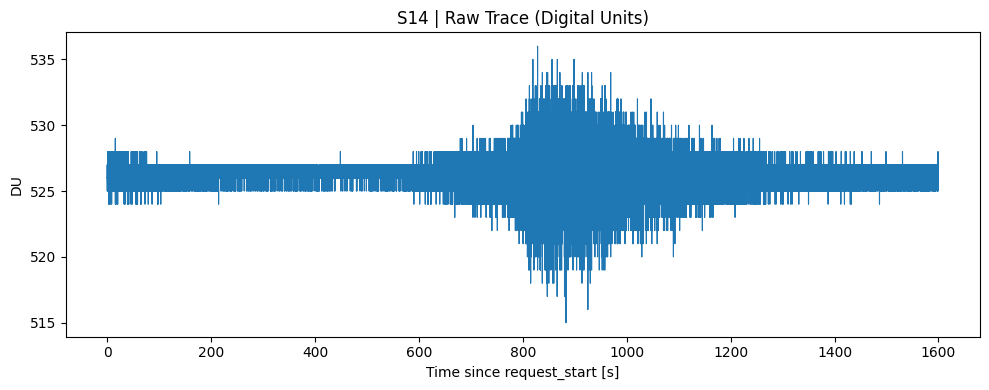

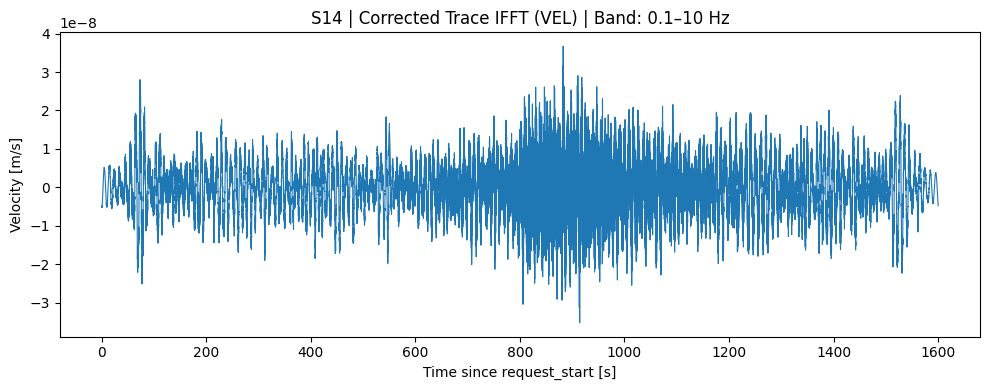

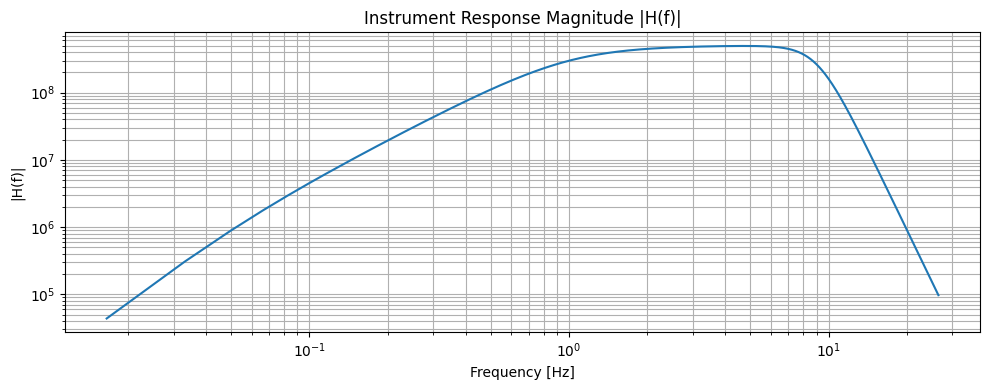

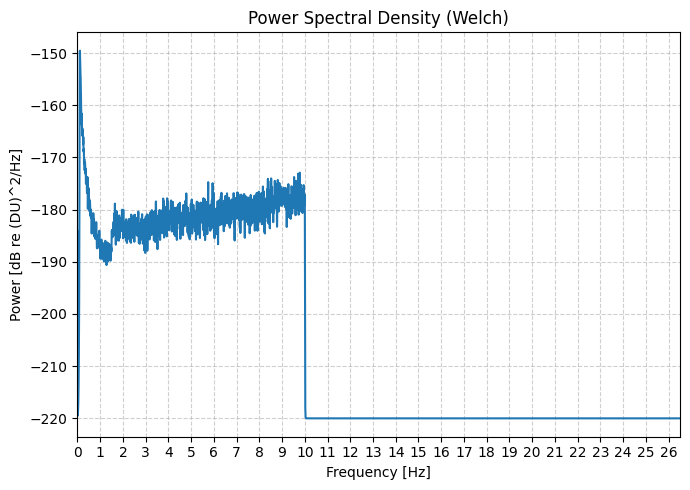

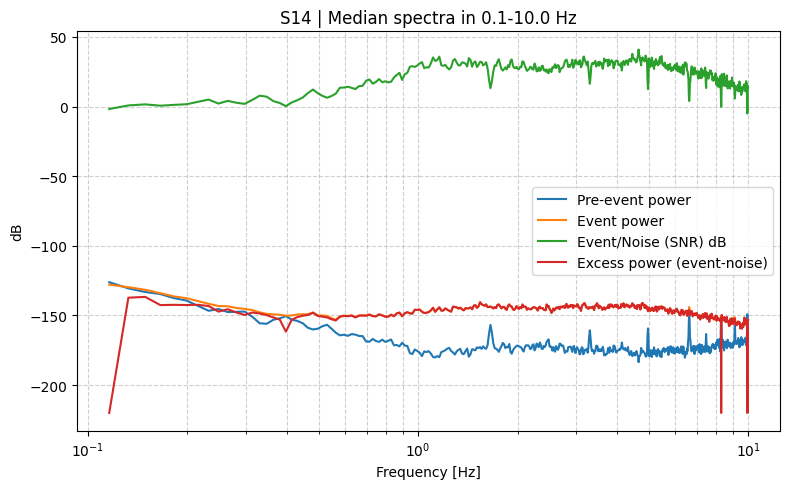


[Row 0] Station S15 | Request 1972-12-06T23:03:33.400000 → 1972-12-06T23:30:13.400000 | Dist=34.71520336495027 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84798, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1972-12-06T23:03:33.400000Z to 1972-12-06T23:30:13.400000Z  |  Event 1972-12-06T23:08:33.400000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 620


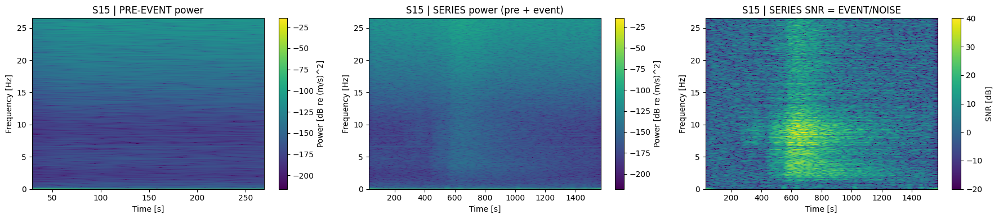

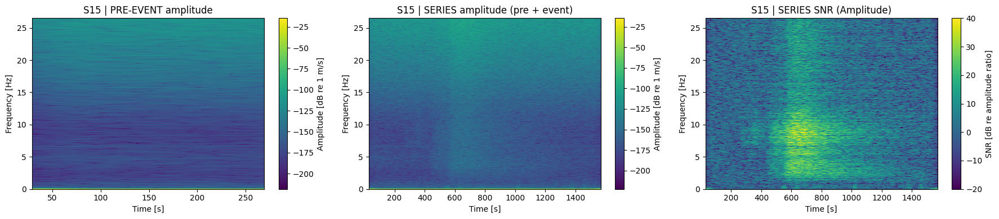

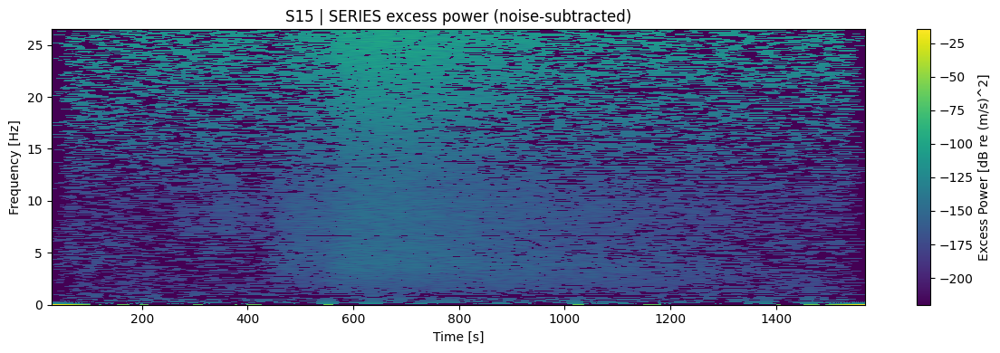

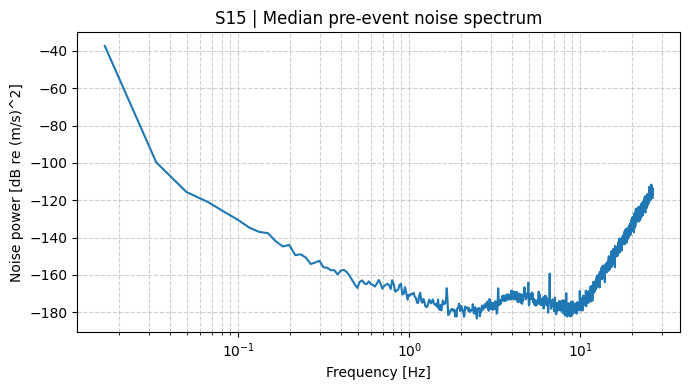

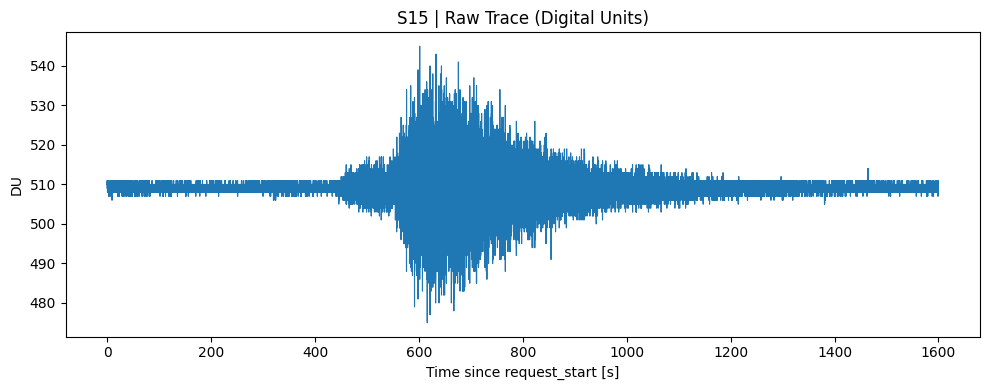

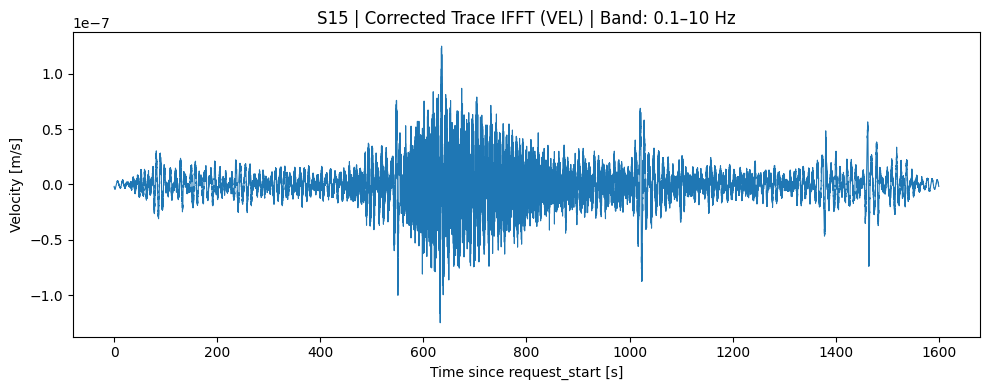

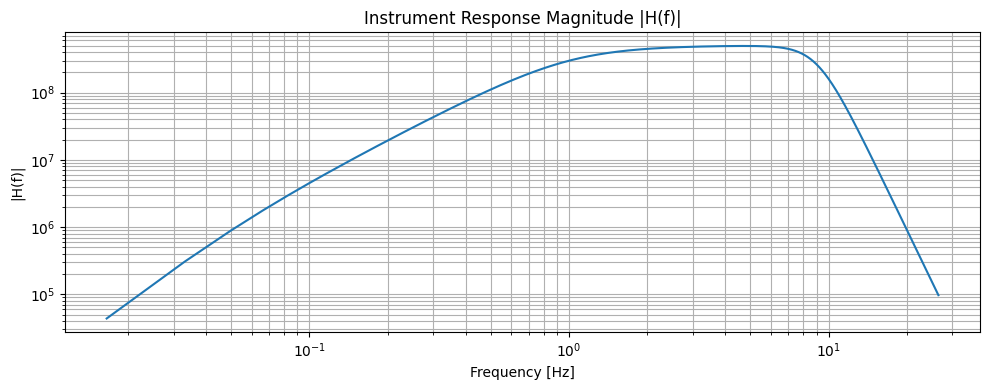

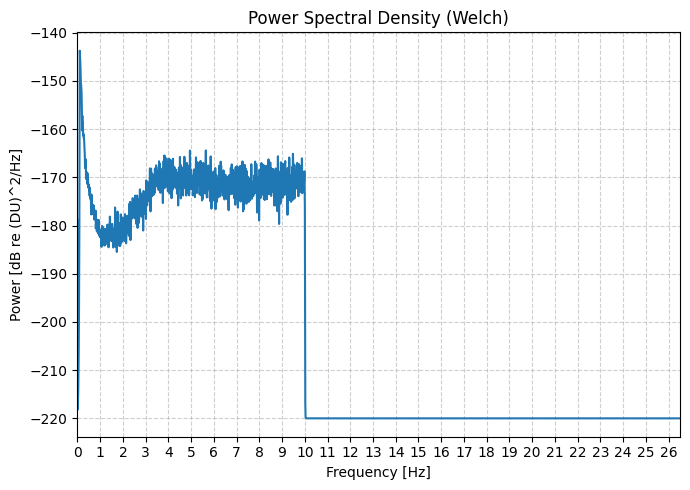

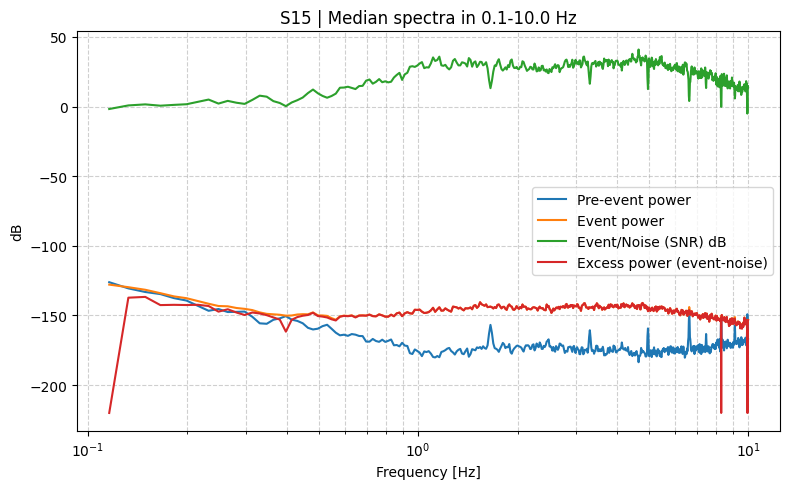


[Row 0] Station S16 | Request 1972-12-06T23:03:33.400000 → 1972-12-06T23:30:13.400000 | Dist=60.41010898371444 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1972-12-06T23:03:33.400000Z to 1972-12-06T23:30:13.400000Z  |  Event 1972-12-06T23:08:33.400000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


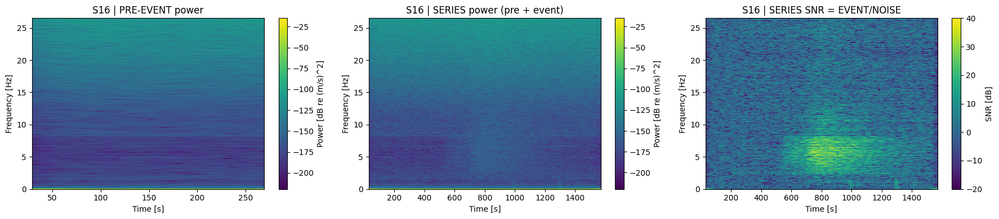

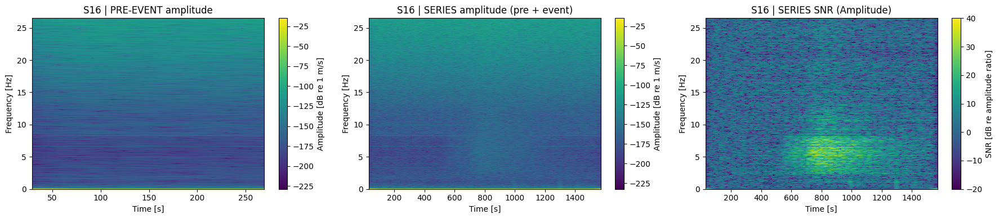

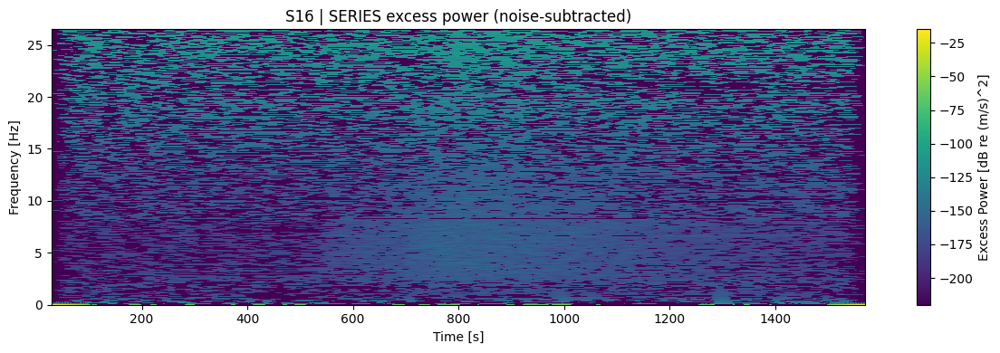

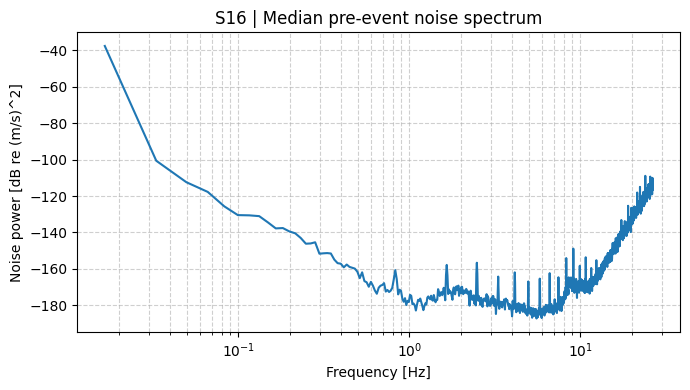

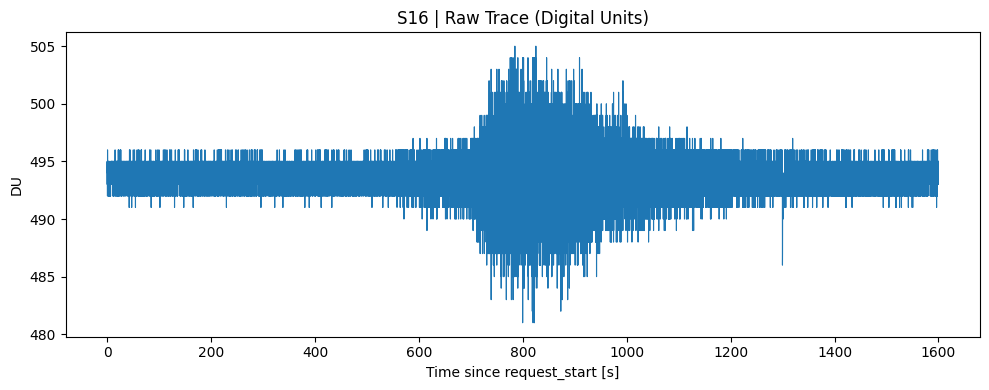

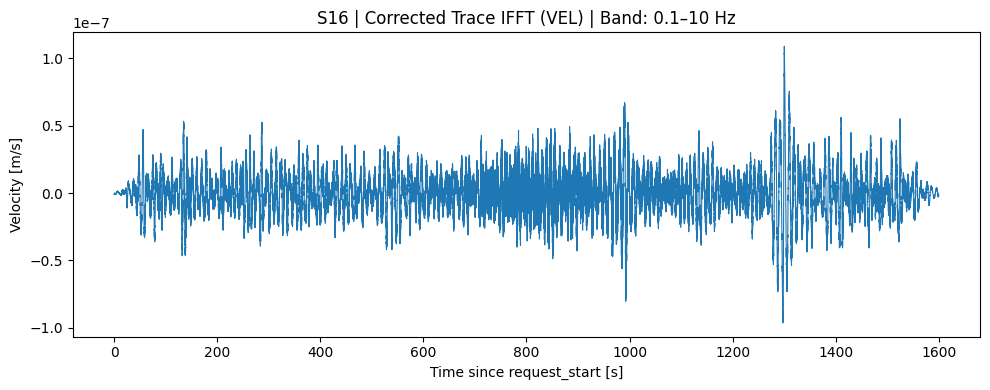

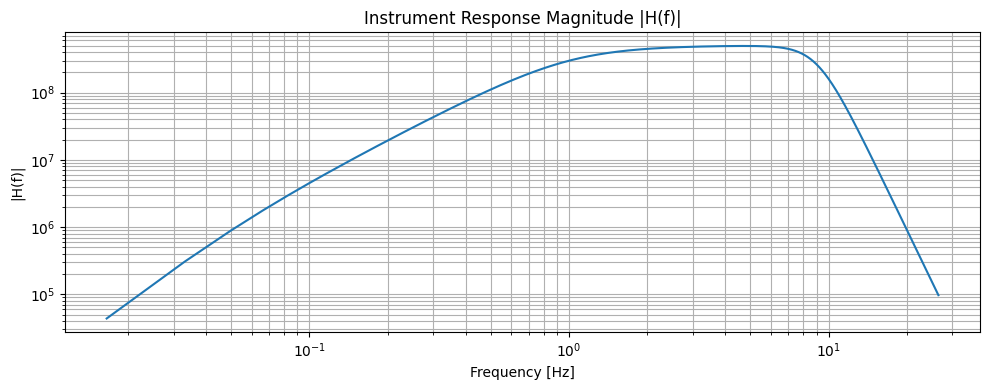

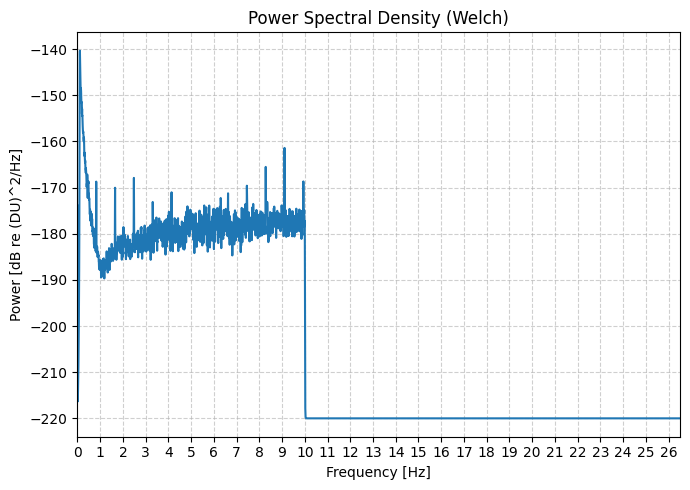

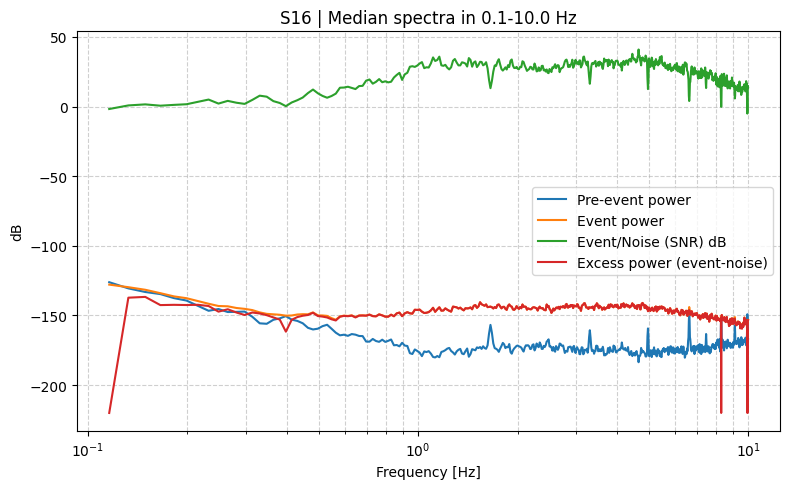


[Row 1] Station S14 | Request 1974-07-11T00:41:18.260000 → 1974-07-11T01:07:58.260000 | Dist=100.67672835090306 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1974-07-11T00:41:18.260000Z to 1974-07-11T01:07:58.260000Z  |  Event 1974-07-11T00:46:18.260000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


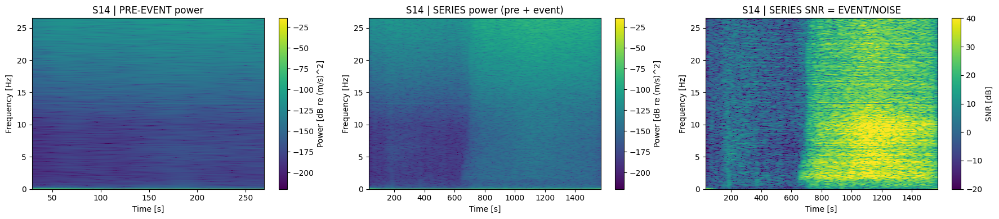

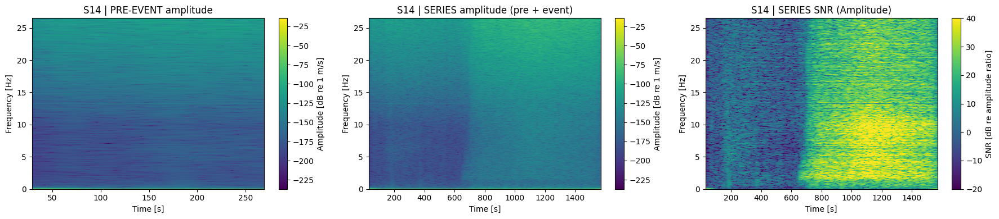

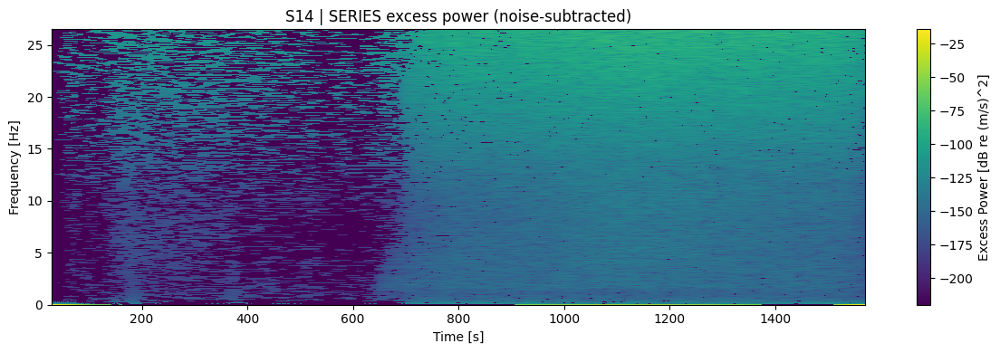

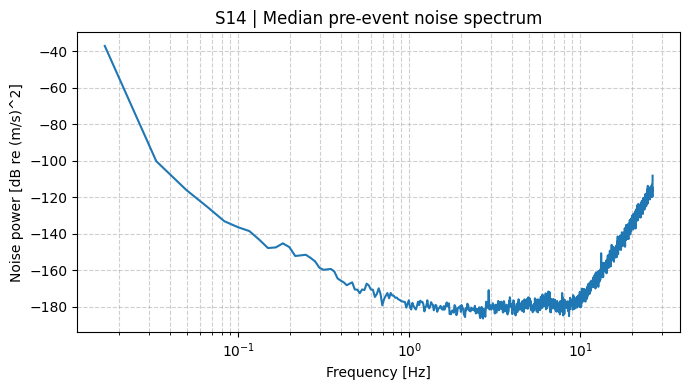

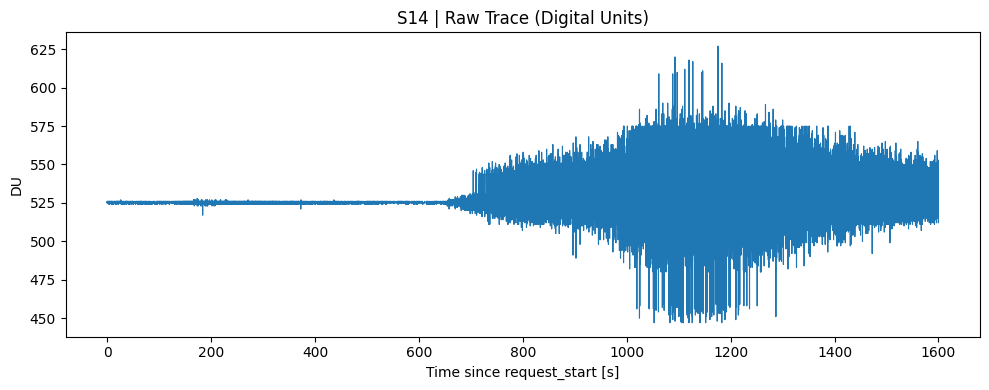

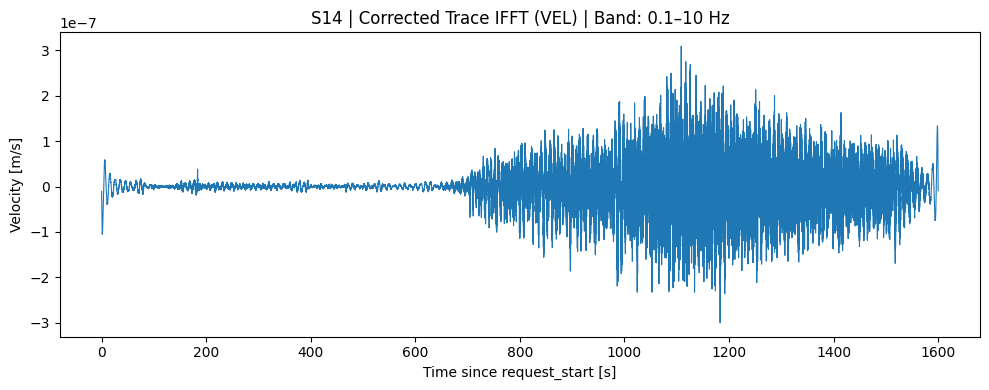

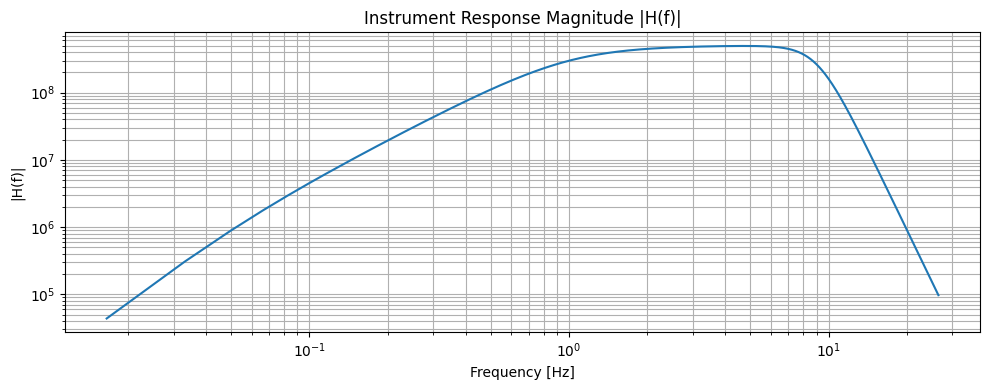

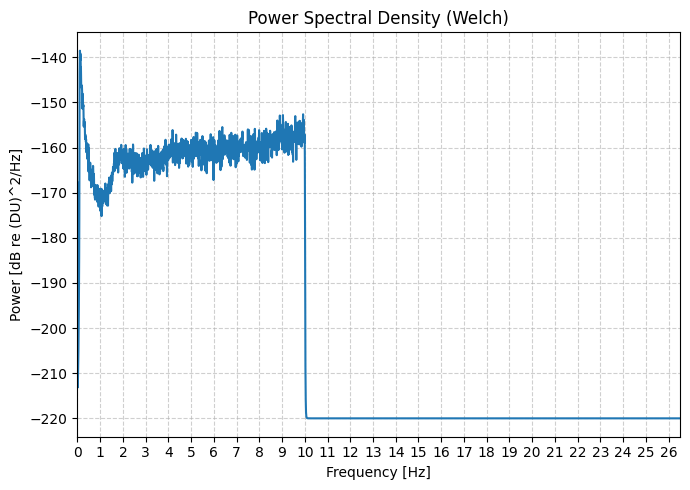

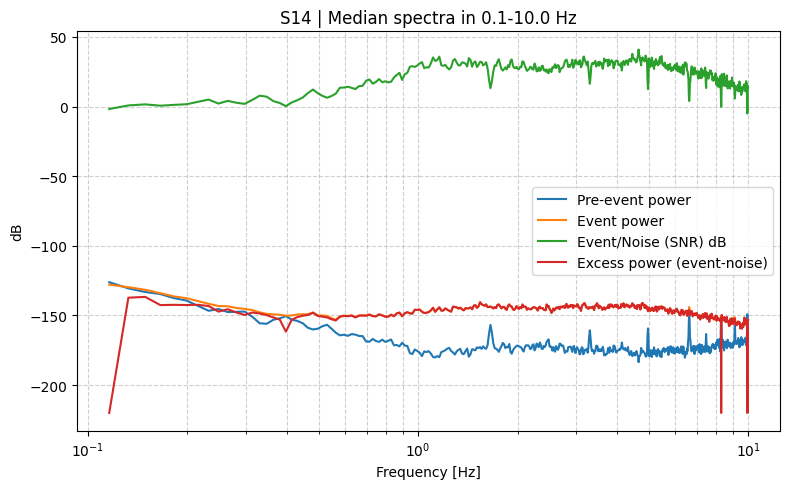


[Row 1] Station S15 | Request 1974-07-11T00:41:18.260000 → 1974-07-11T01:07:58.260000 | Dist=71.11360594723389 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1974-07-11T00:41:18.260000Z to 1974-07-11T01:07:58.260000Z  |  Event 1974-07-11T00:46:18.260000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


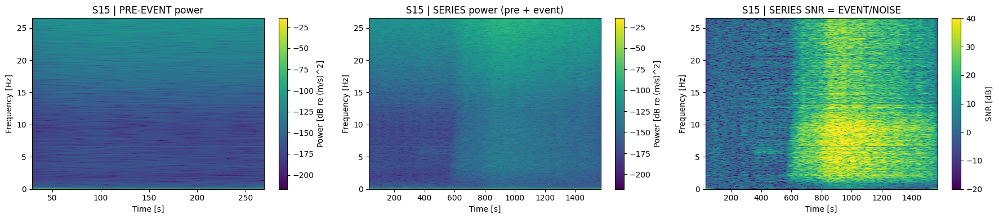

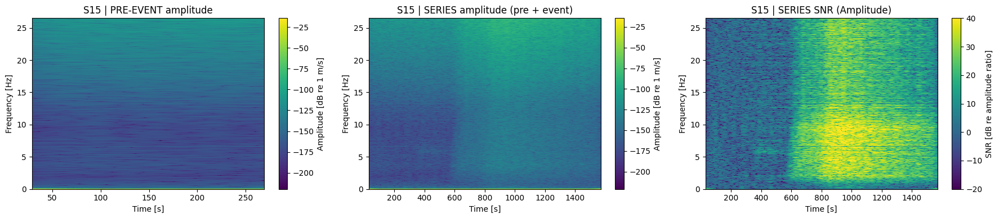

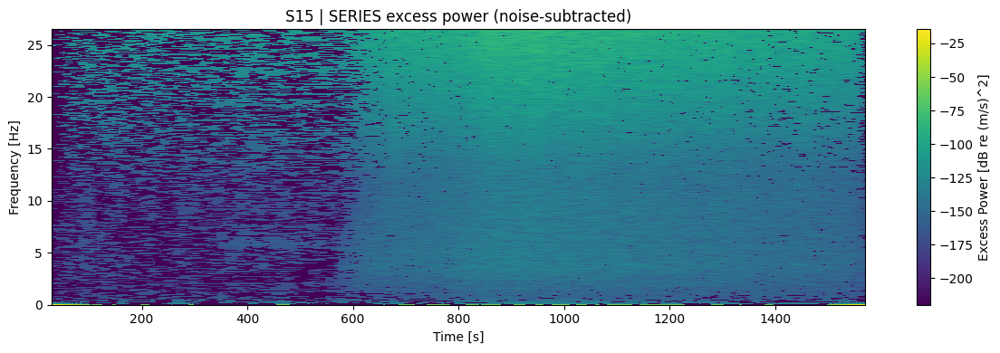

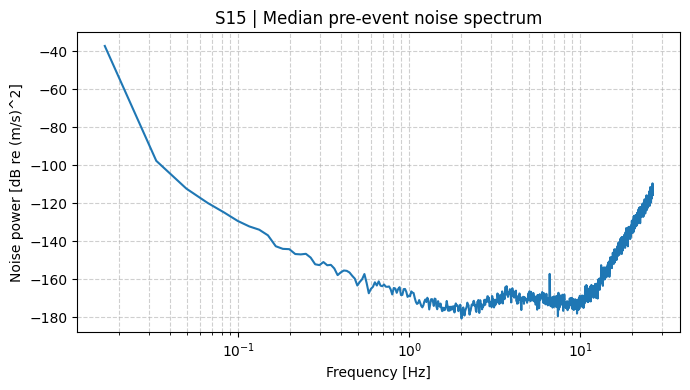

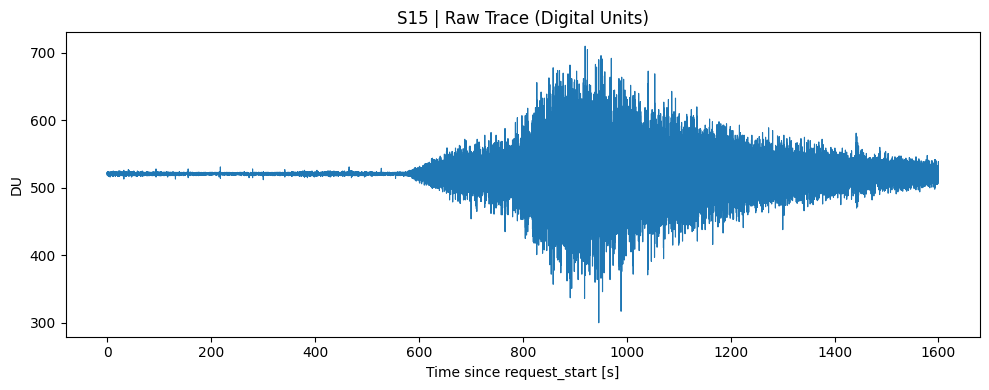

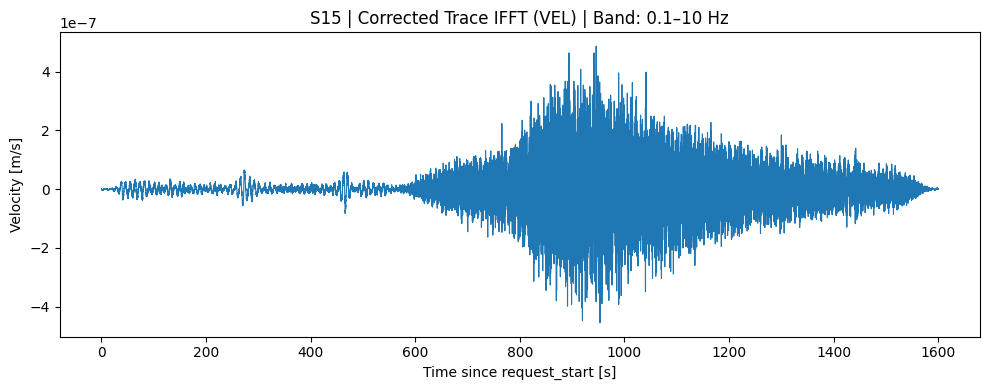

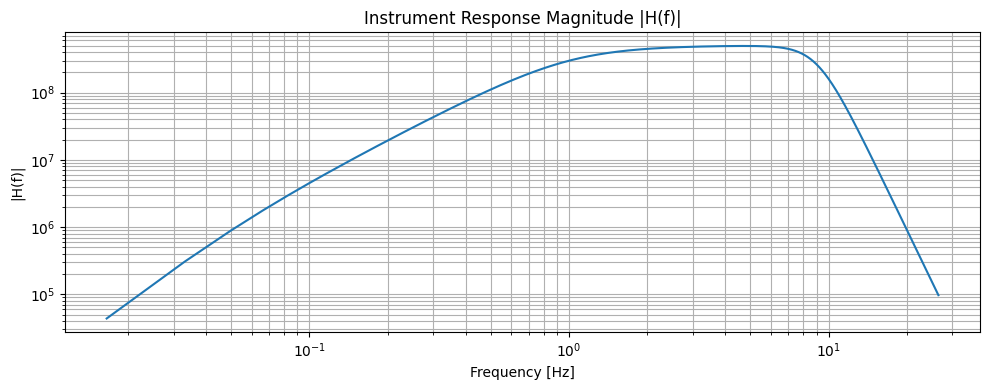

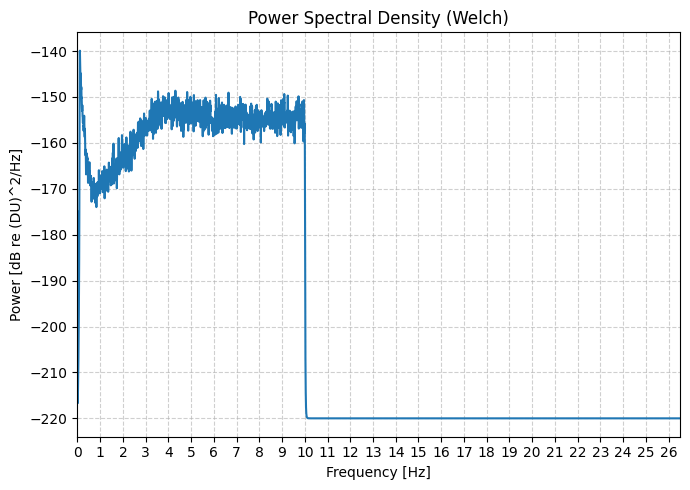

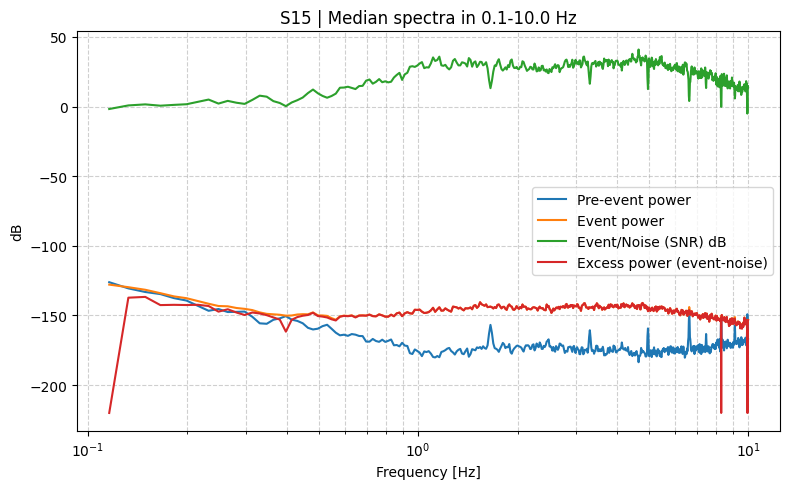


[Row 1] Station S16 | Request 1974-07-11T00:41:18.260000 → 1974-07-11T01:07:58.260000 | Dist=72.6376709306856 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1974-07-11T00:41:18.260000Z to 1974-07-11T01:07:58.260000Z  |  Event 1974-07-11T00:46:18.260000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


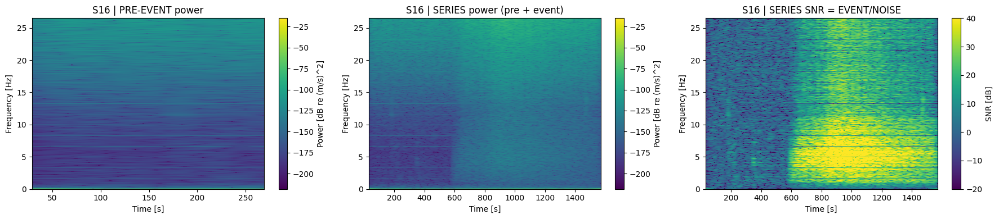

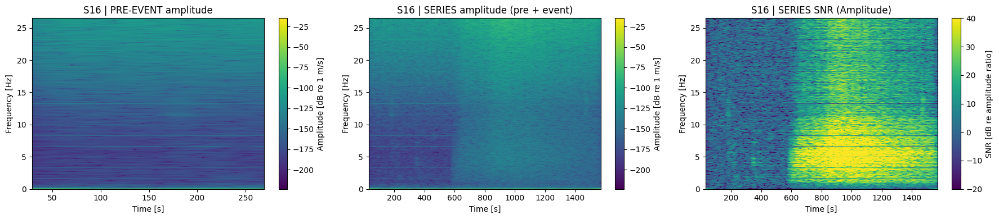

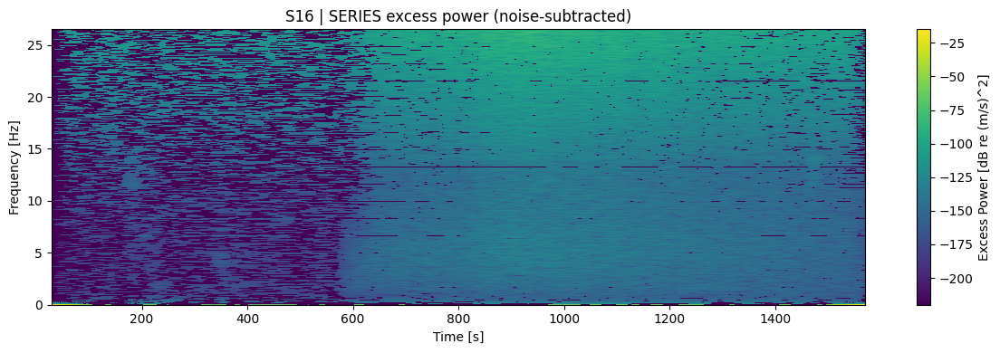

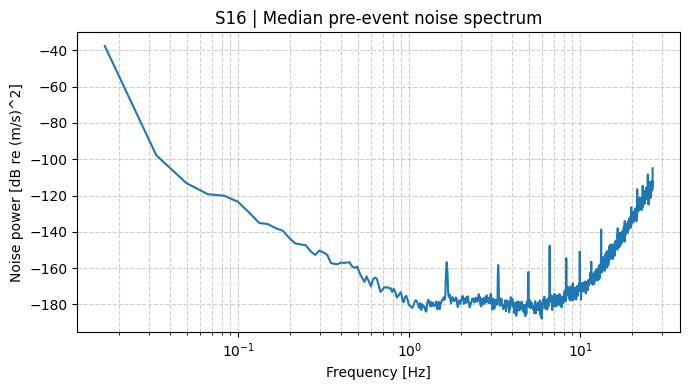

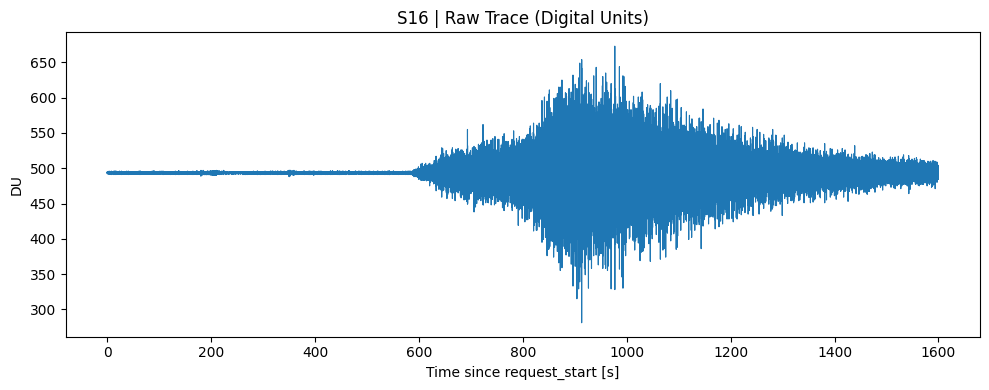

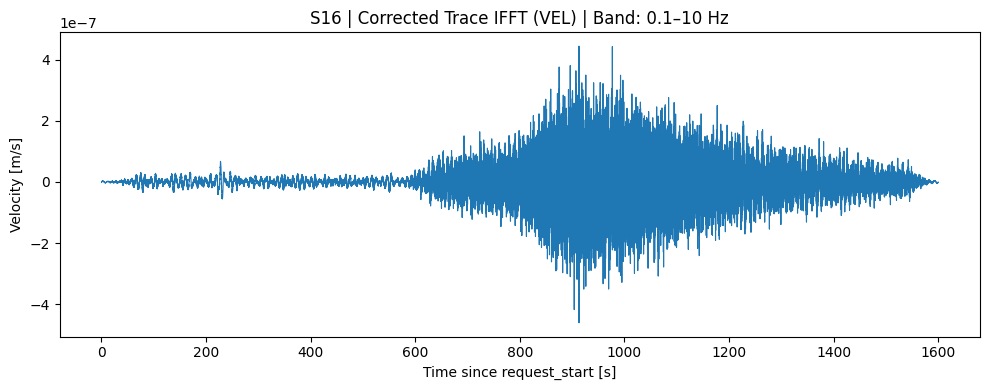

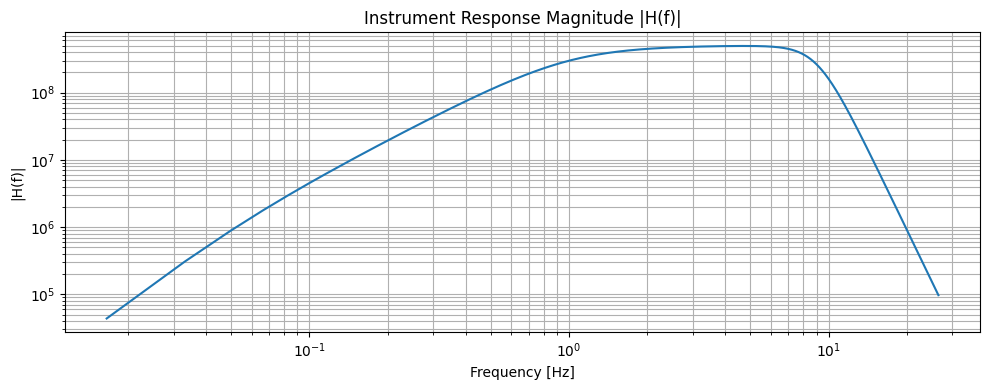

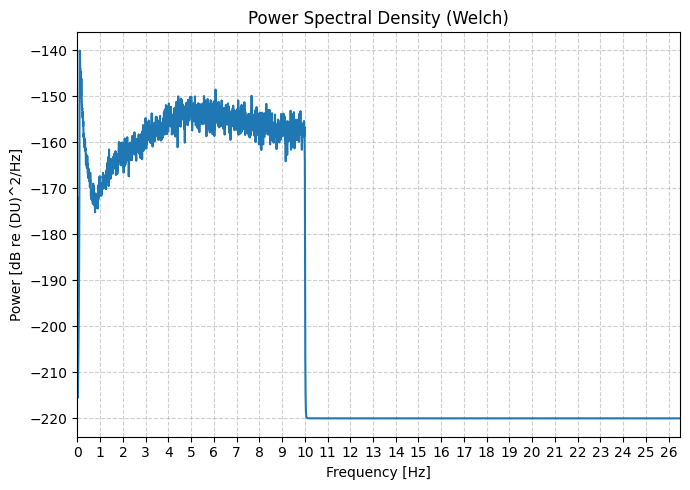

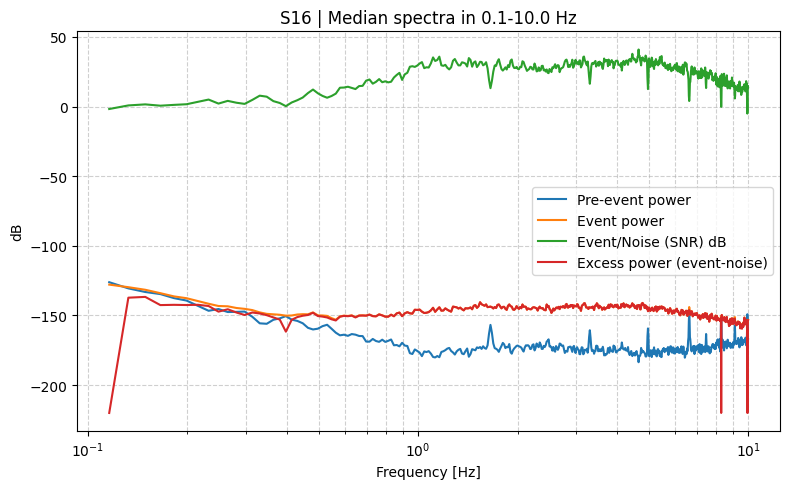


[Row 2] Station S14 | Request 1975-01-03T01:36:58.360000 → 1975-01-03T02:03:38.360000 | Dist=78.45263430465438 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1975-01-03T01:36:58.360000Z to 1975-01-03T02:03:38.360000Z  |  Event 1975-01-03T01:41:58.360000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


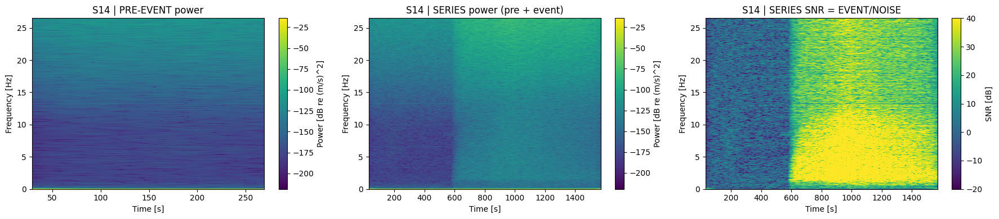

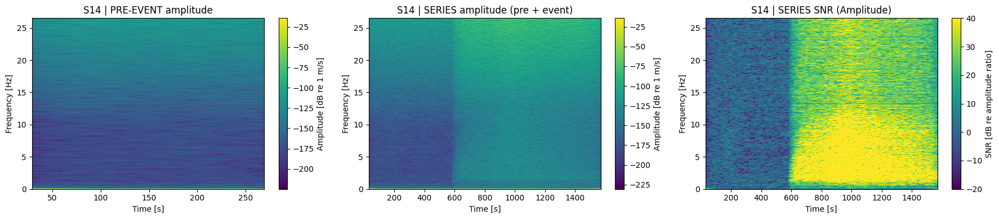

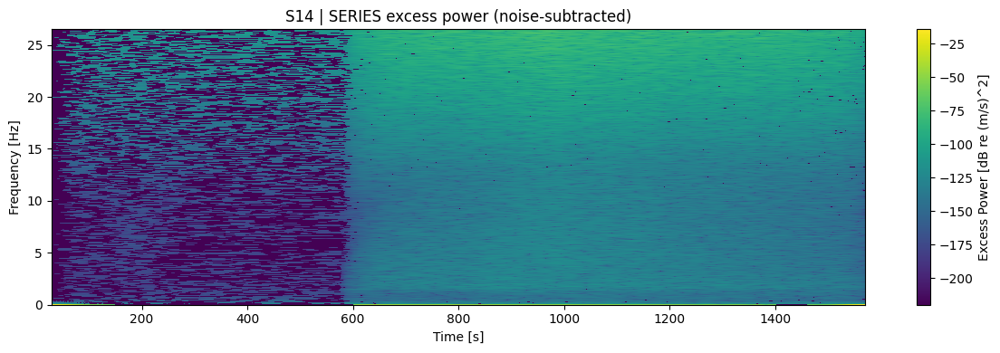

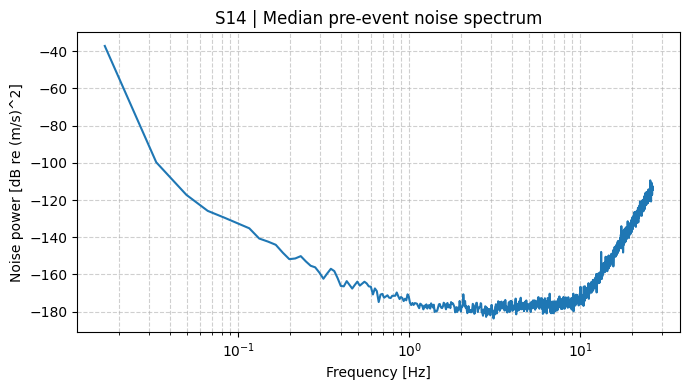

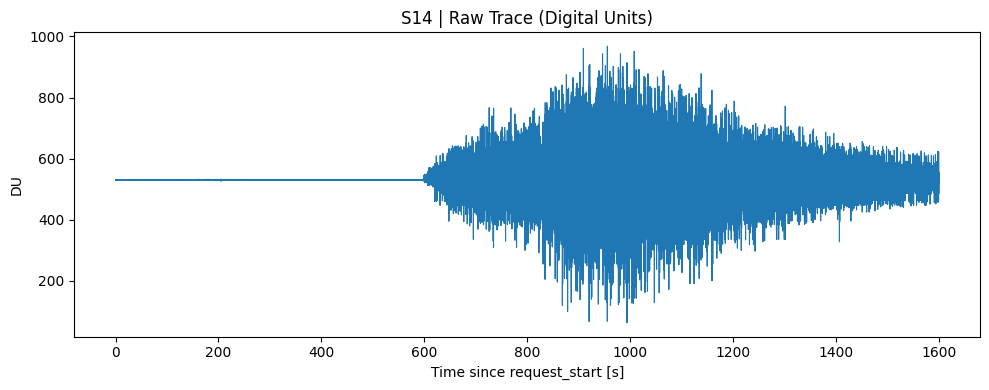

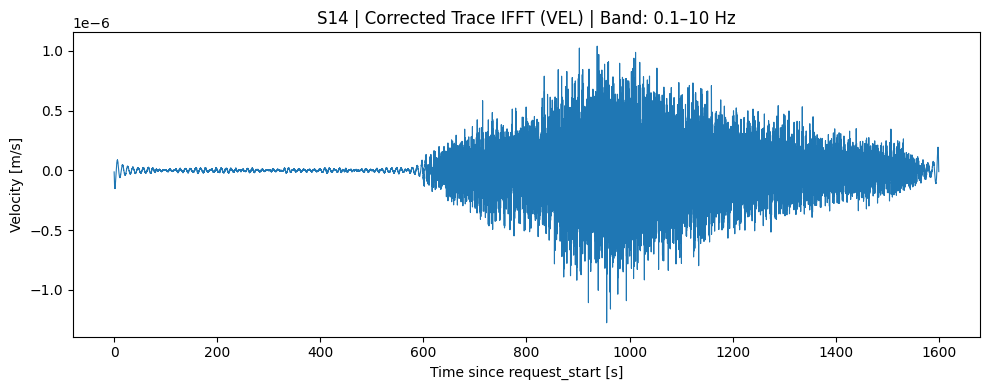

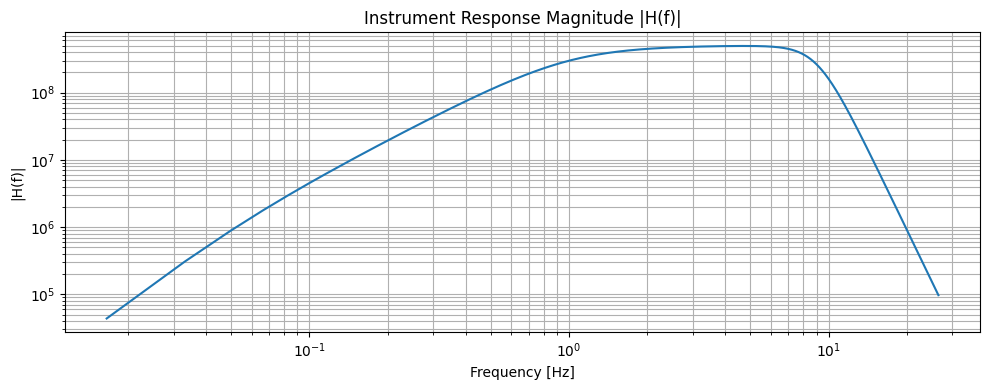

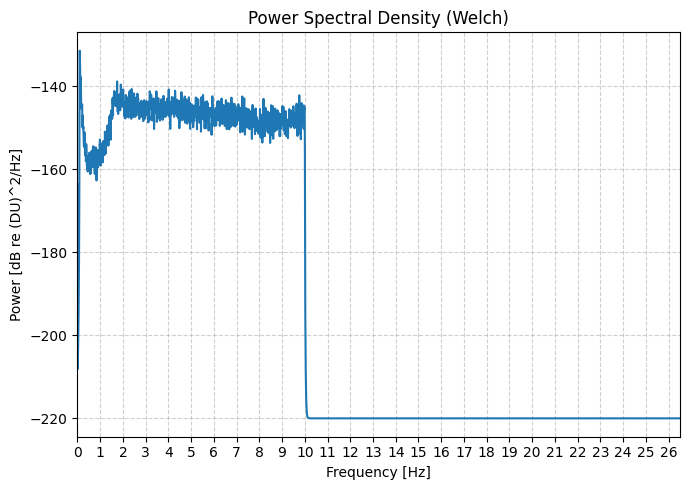

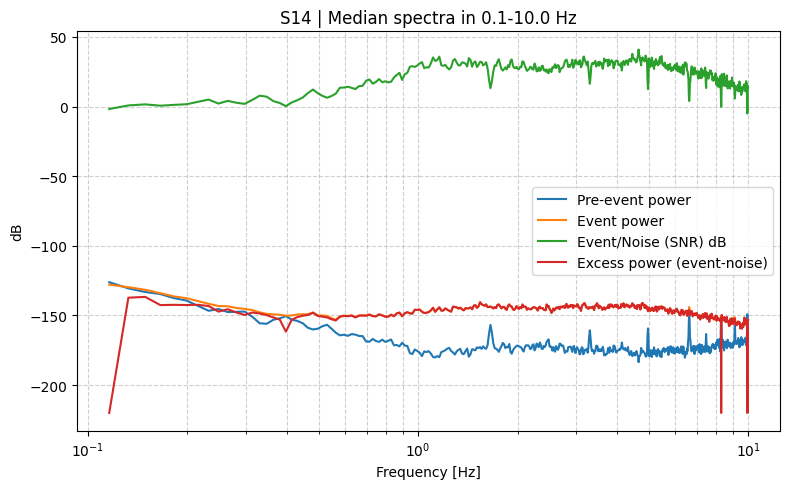


[Row 2] Station S15 | Request 1975-01-03T01:36:58.360000 → 1975-01-03T02:03:38.360000 | Dist=83.98238793583074 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84799, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1975-01-03T01:36:58.360000Z to 1975-01-03T02:03:38.360000Z  |  Event 1975-01-03T01:41:58.360000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 620


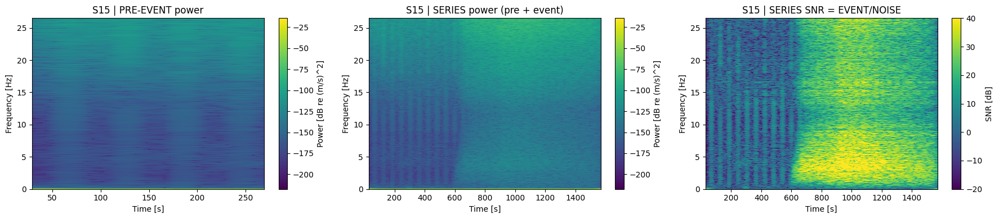

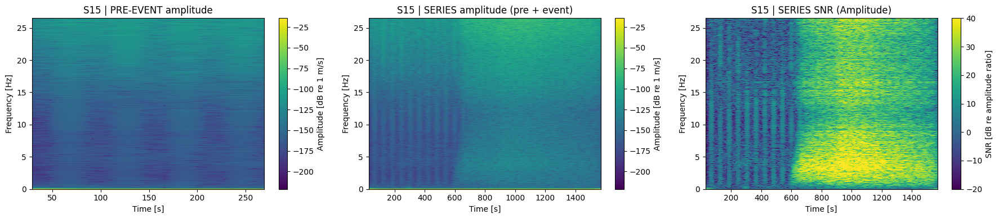

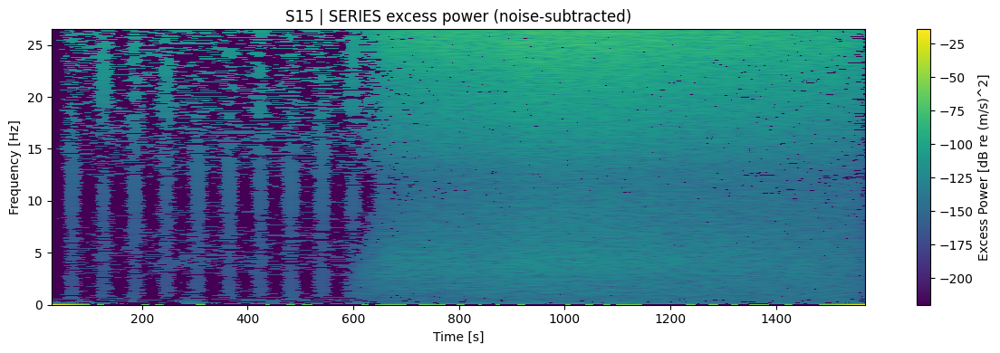

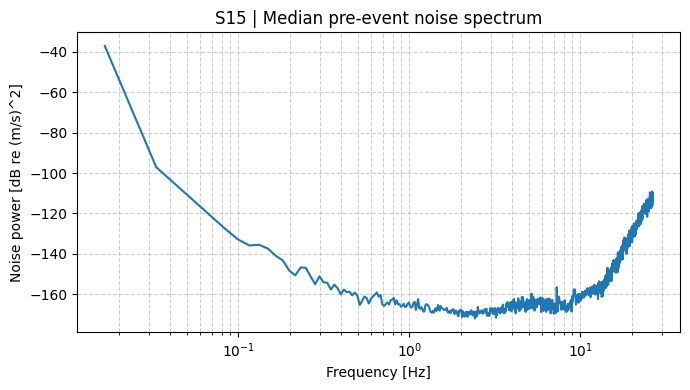

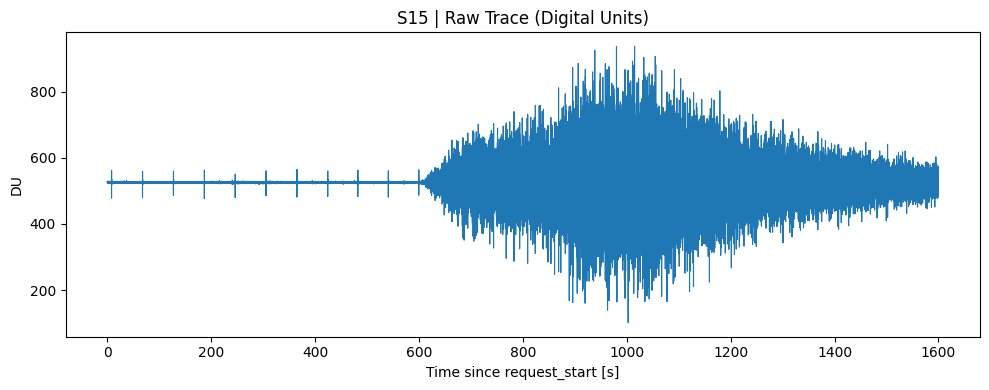

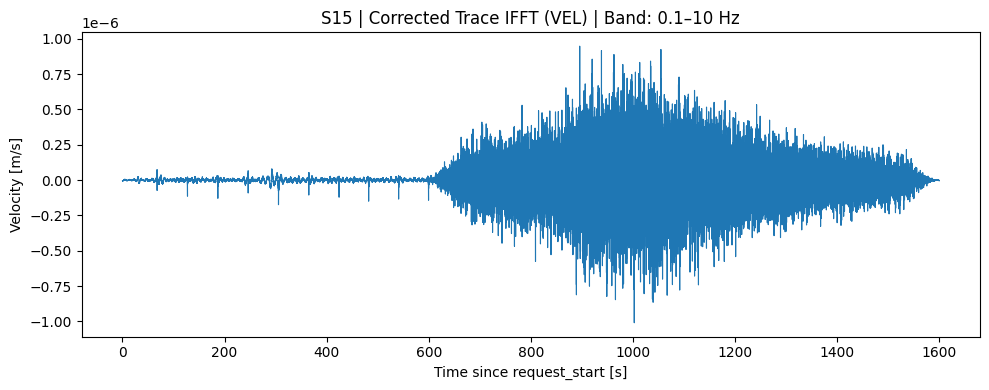

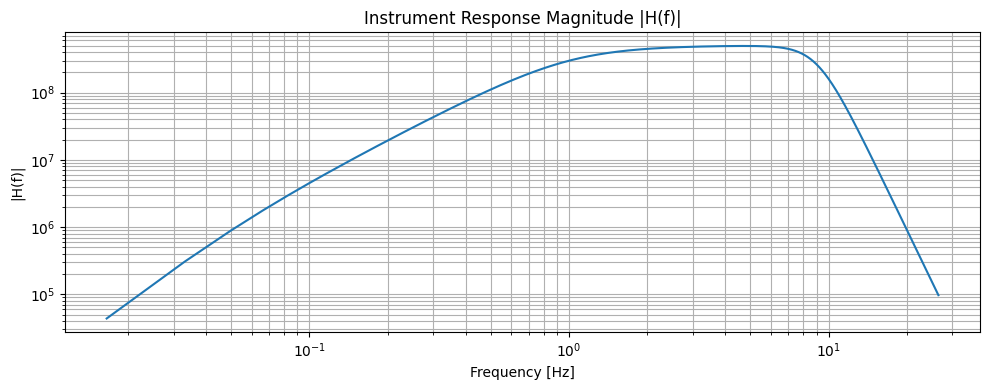

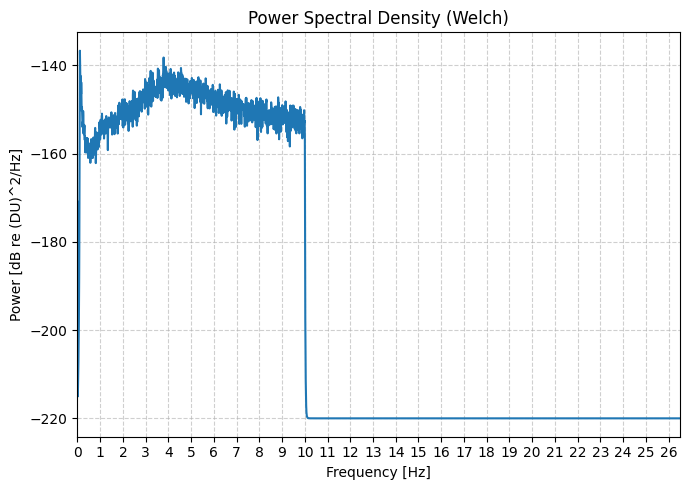

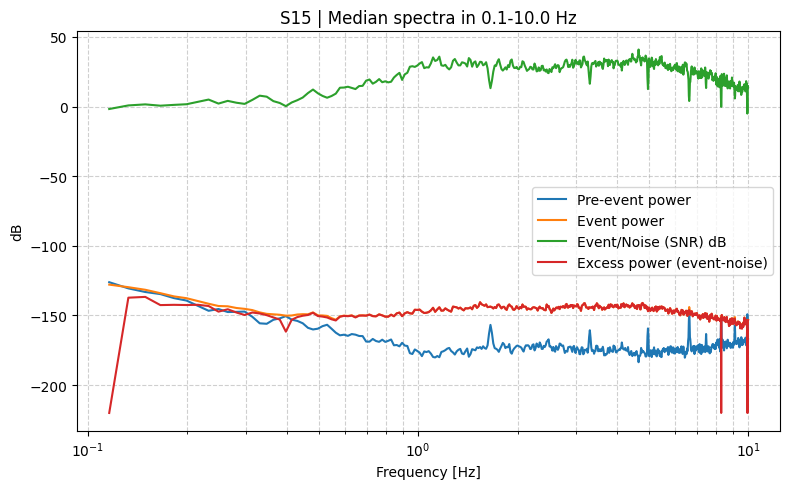


[Row 2] Station S16 | Request 1975-01-03T01:36:58.360000 → 1975-01-03T02:03:38.360000 | Dist=110.22303059623158 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1975-01-03T01:36:58.360000Z to 1975-01-03T02:03:38.360000Z  |  Event 1975-01-03T01:41:58.360000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


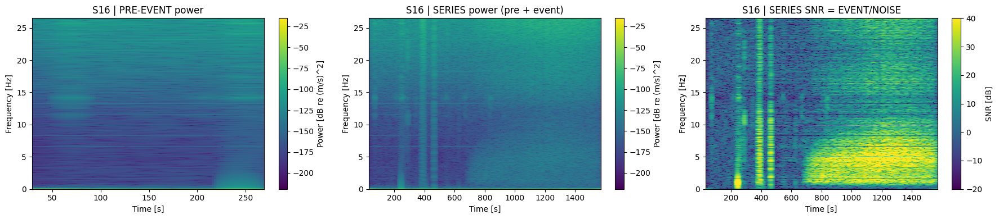

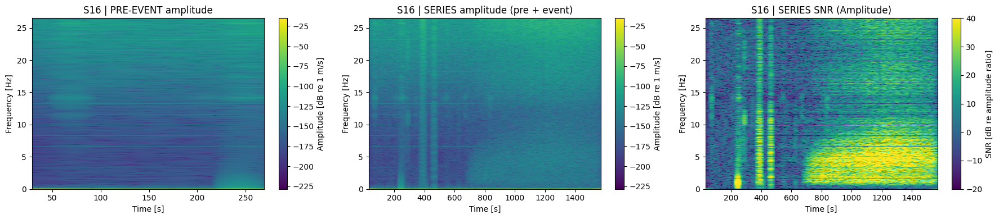

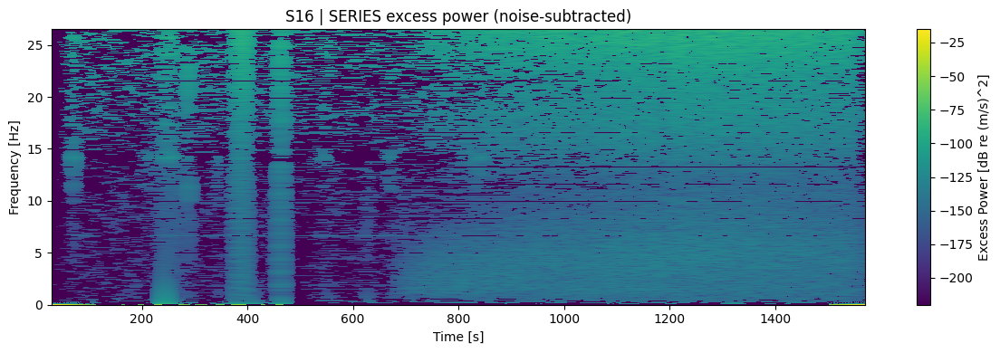

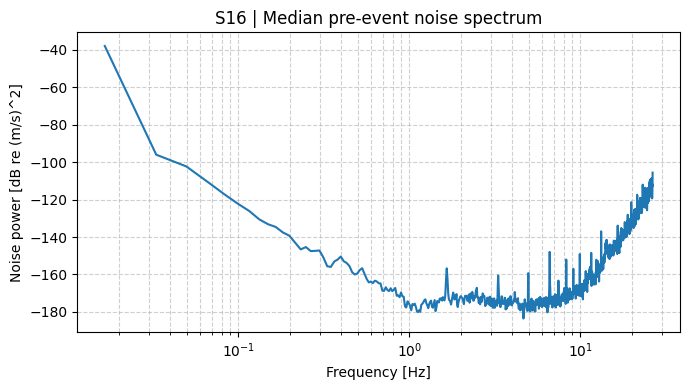

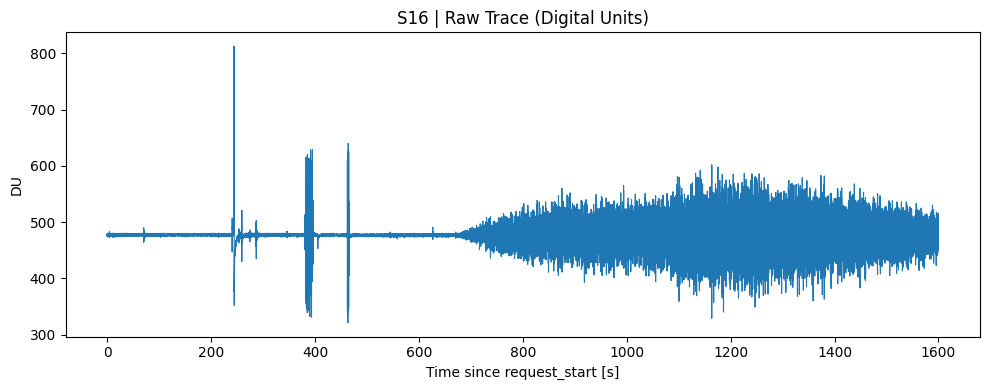

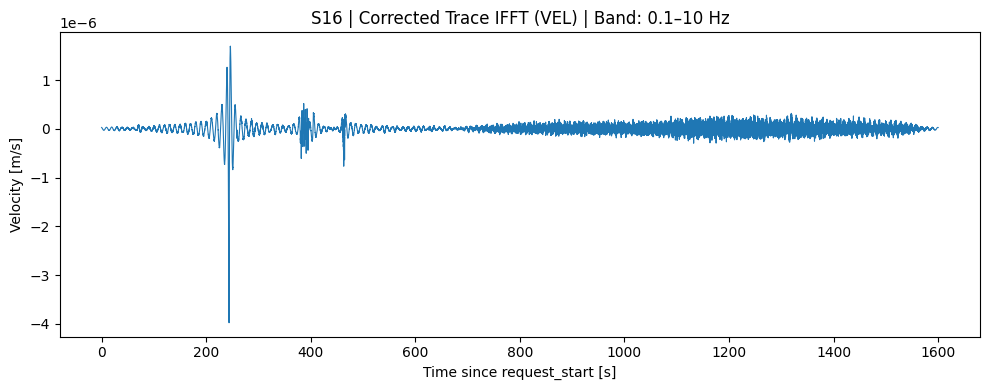

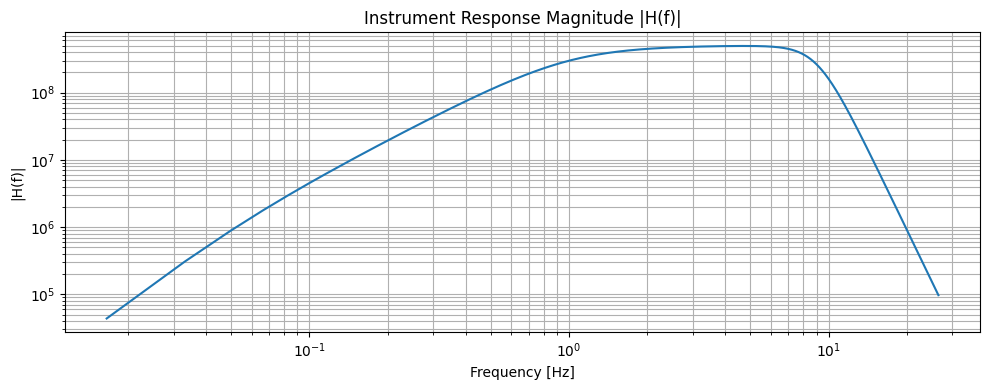

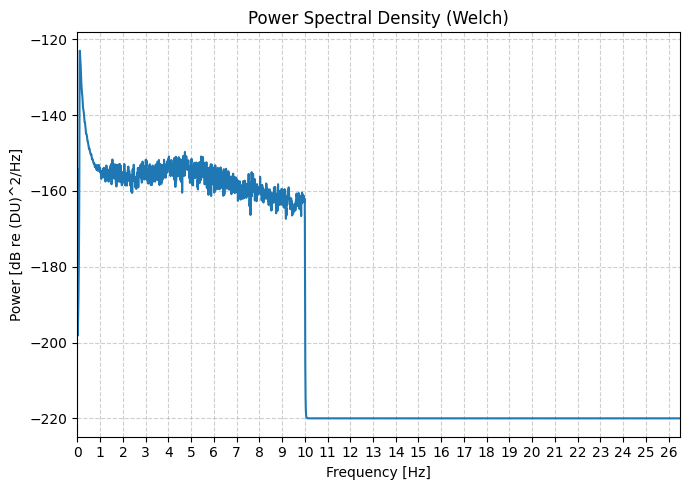

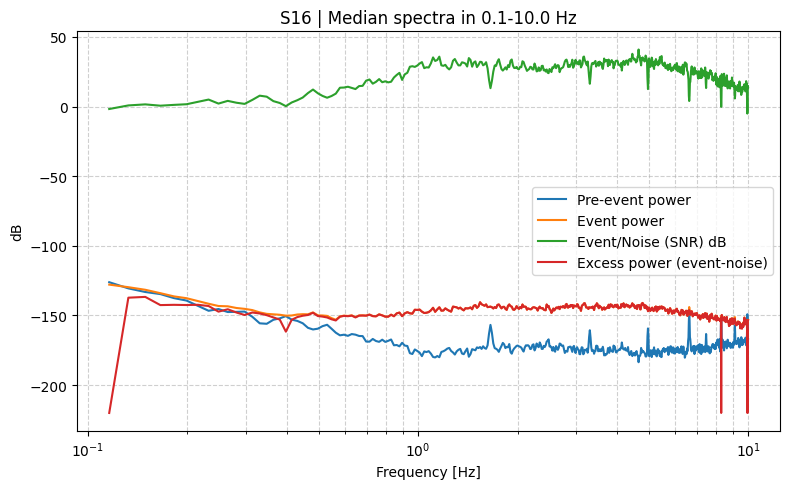


[Row 3] Station S14 | Request 1975-01-12T03:08:51.740000 → 1975-01-12T03:35:31.740000 | Dist=87.80561587644877 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1975-01-12T03:08:51.740000Z to 1975-01-12T03:35:31.740000Z  |  Event 1975-01-12T03:13:51.740000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


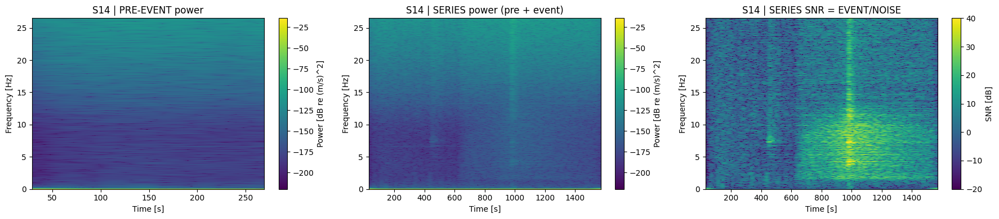

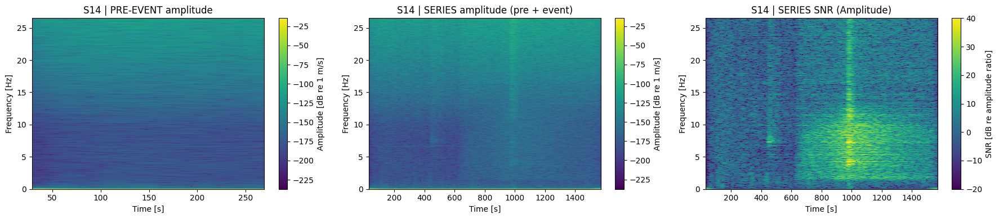

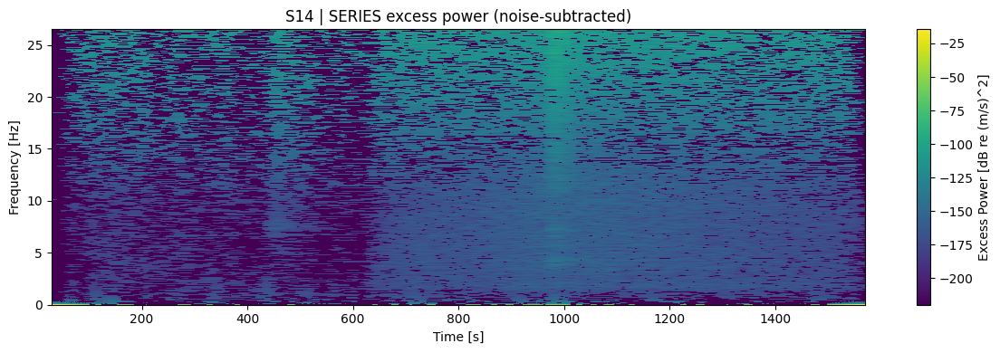

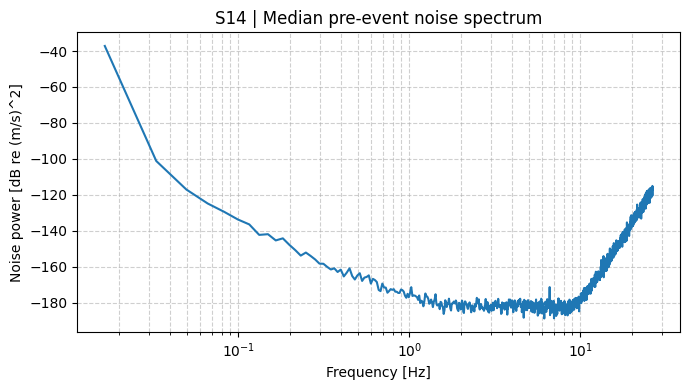

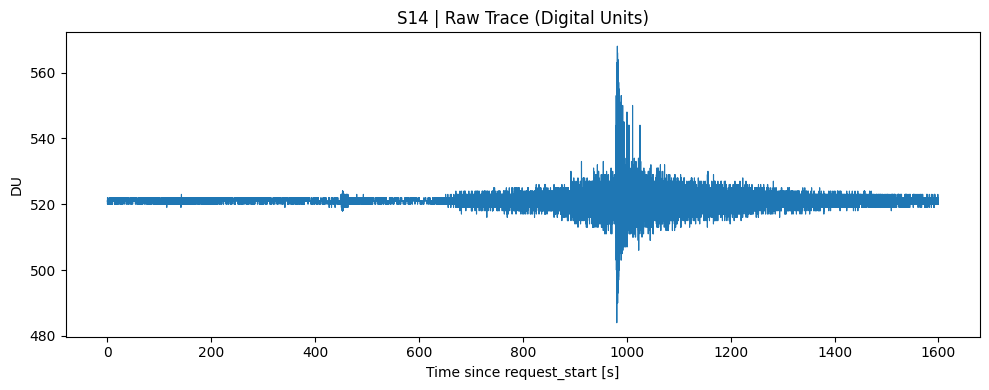

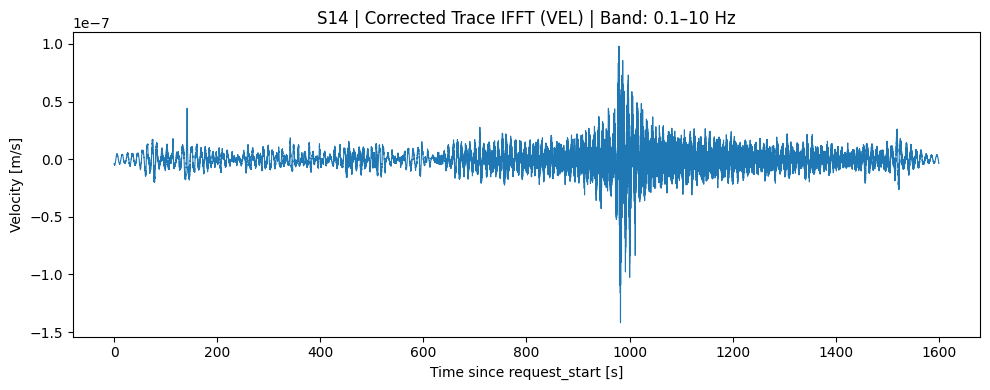

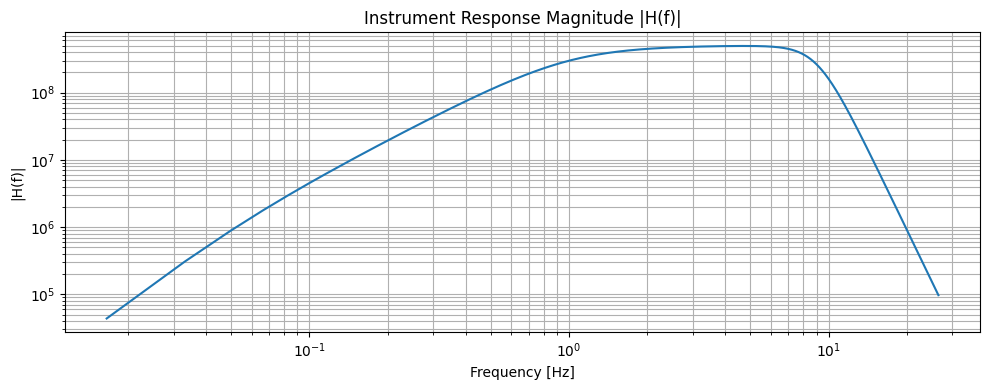

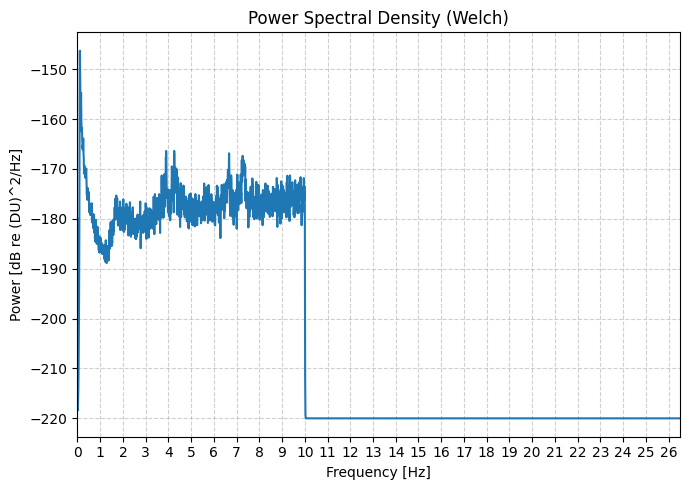

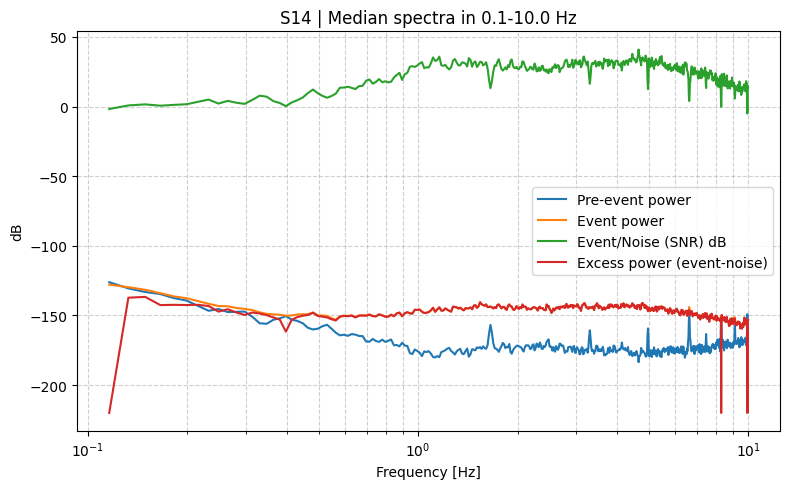


[Row 3] Station S15 | Request 1975-01-12T03:08:51.740000 → 1975-01-12T03:35:31.740000 | Dist=52.1226357958131 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84799, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1975-01-12T03:08:51.740000Z to 1975-01-12T03:35:31.740000Z  |  Event 1975-01-12T03:13:51.740000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 620


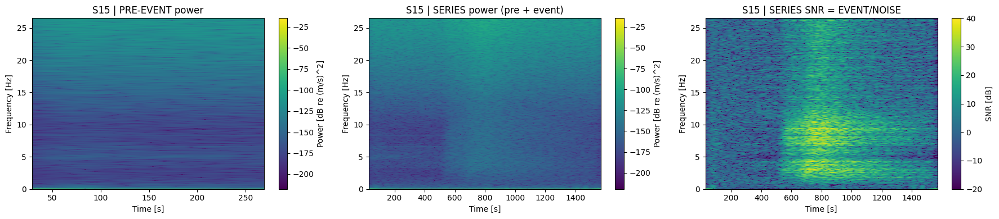

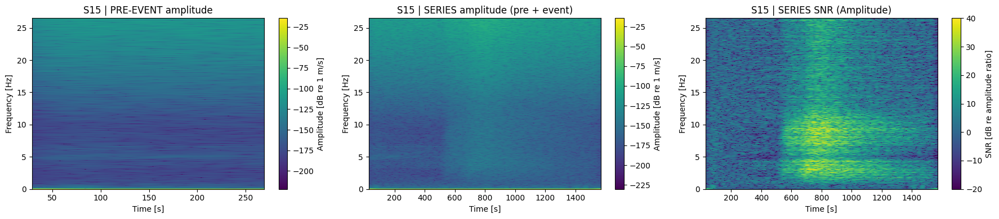

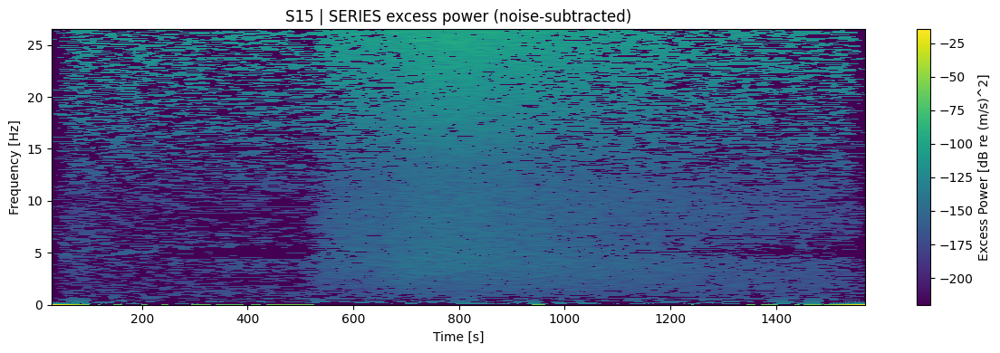

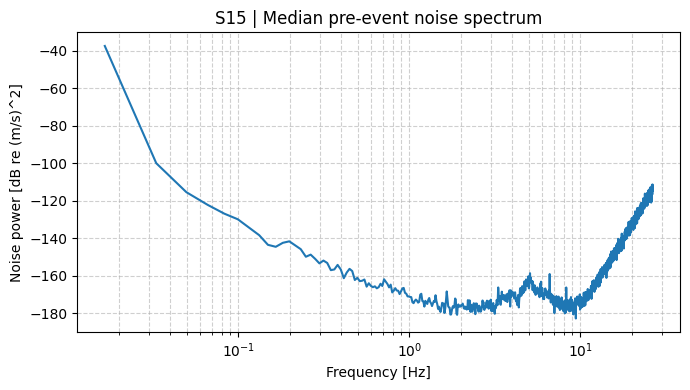

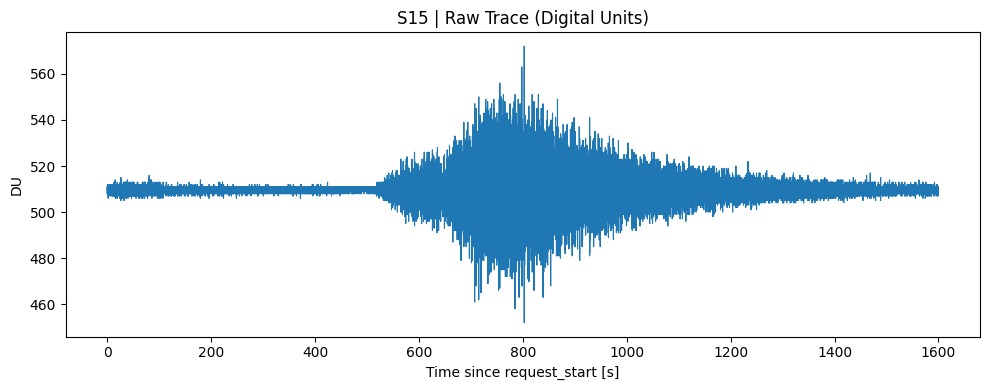

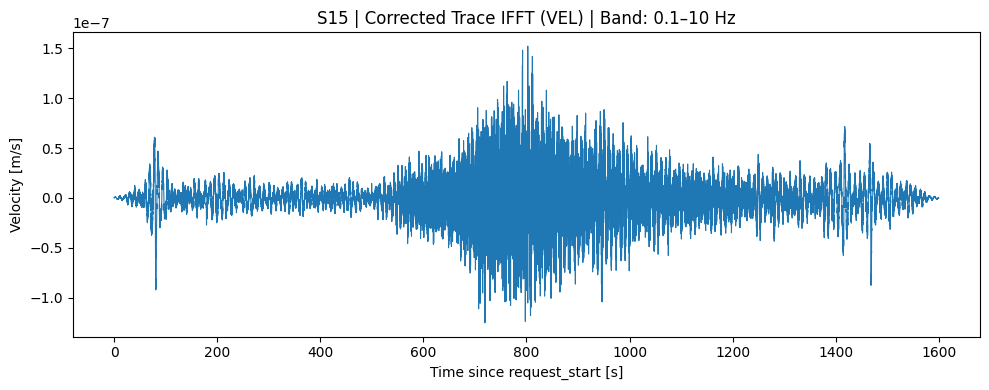

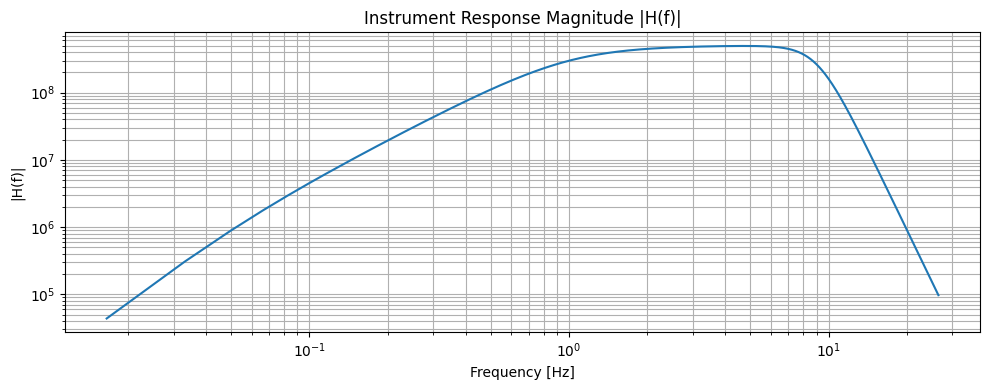

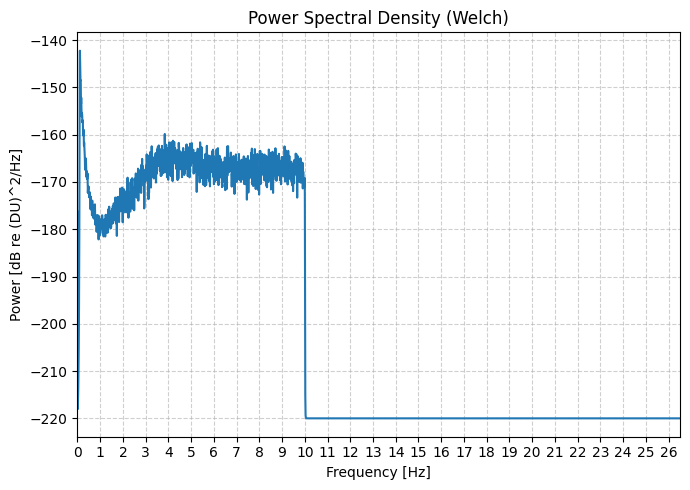

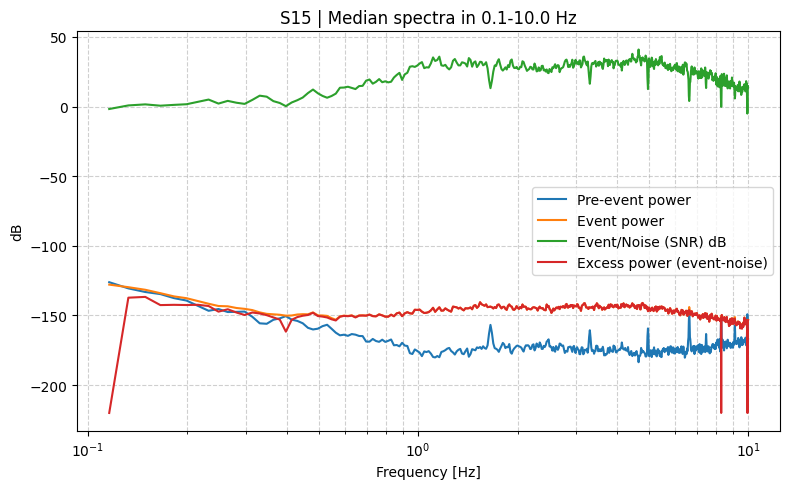


[Row 3] Station S16 | Request 1975-01-12T03:08:51.740000 → 1975-01-12T03:35:31.740000 | Dist=80.33389788692666 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84799, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1975-01-12T03:08:51.740000Z to 1975-01-12T03:35:31.740000Z  |  Event 1975-01-12T03:13:51.740000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 620


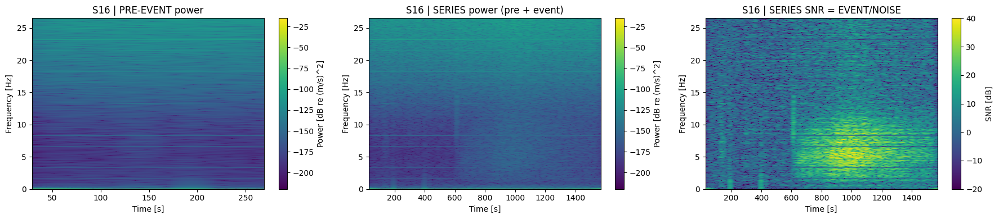

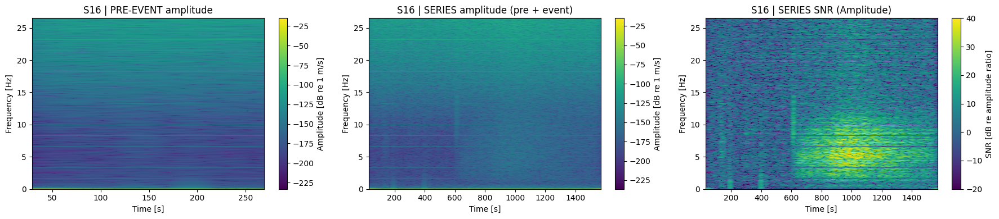

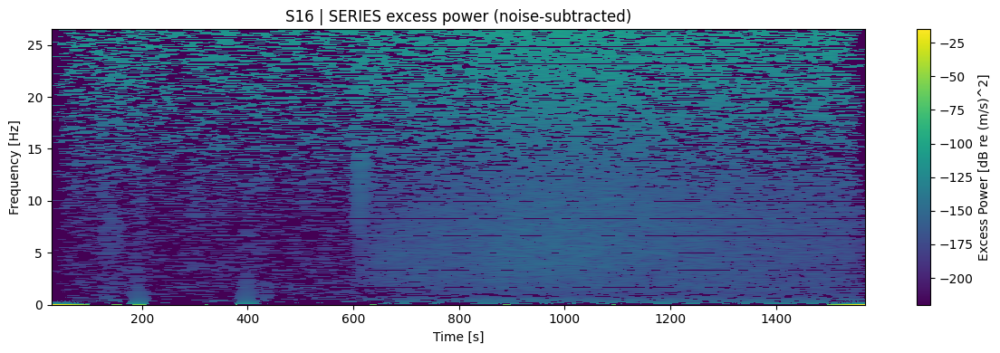

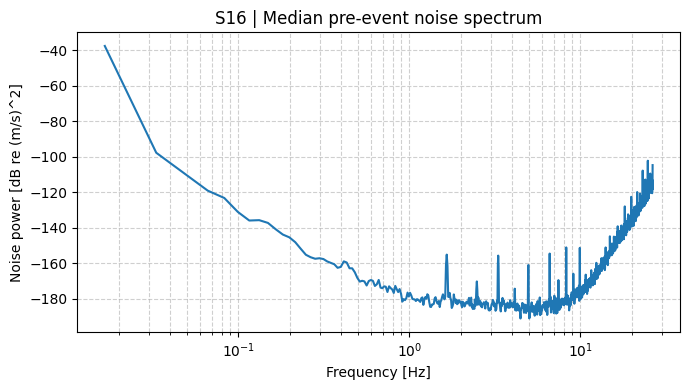

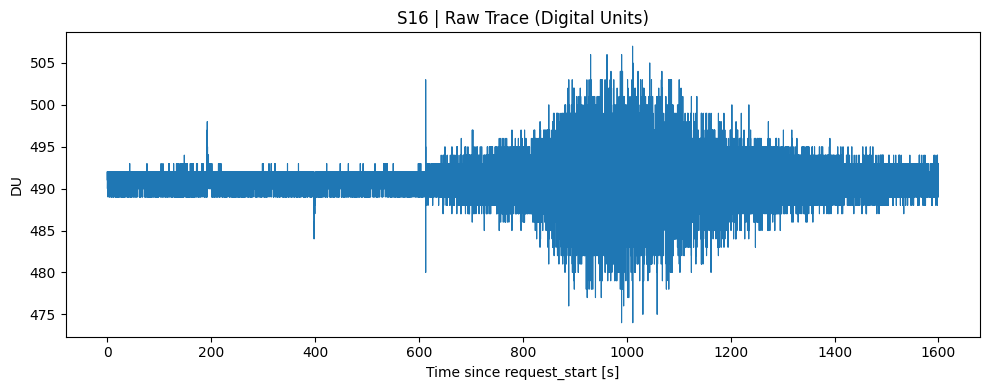

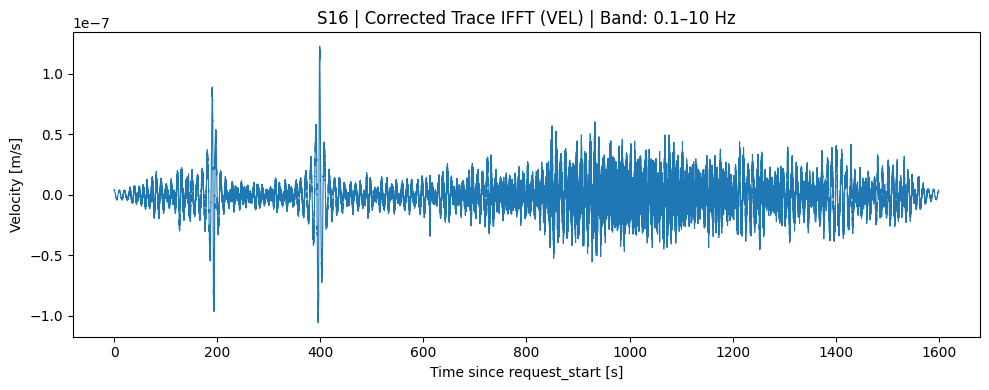

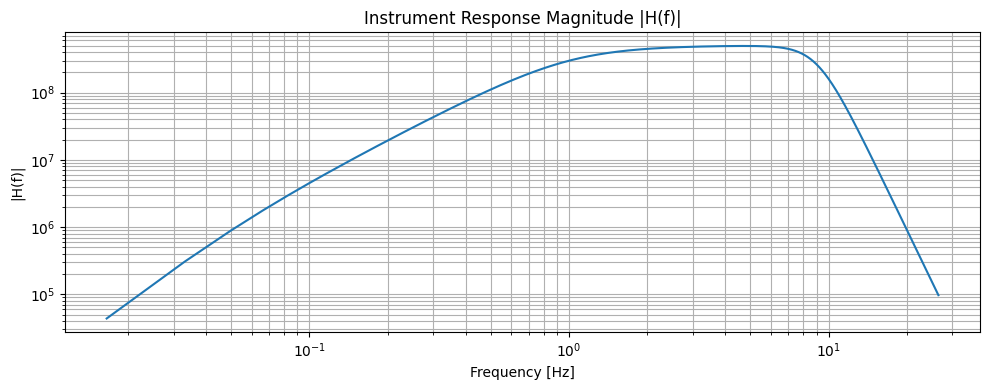

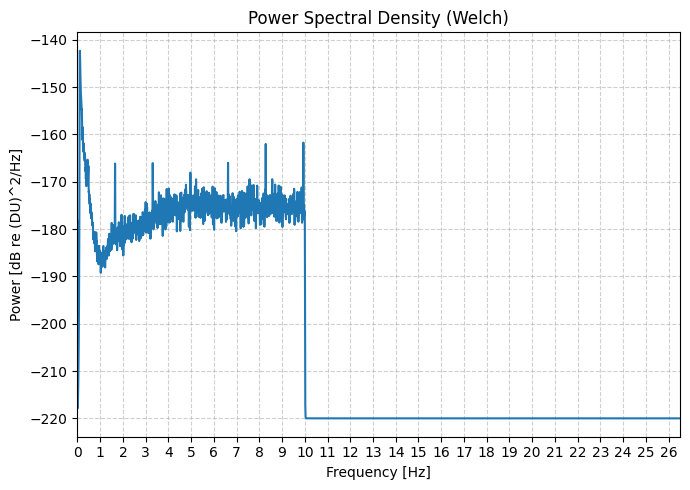

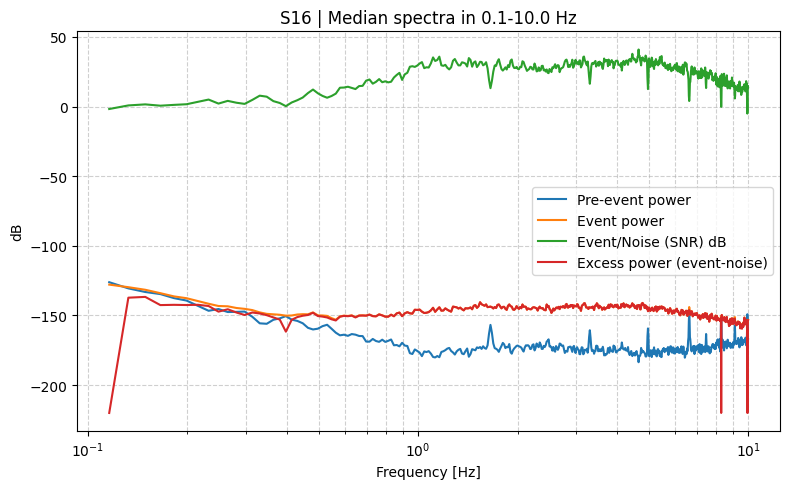


[Row 4] Station S14 | Request 1975-02-13T21:58:50.780000 → 1975-02-13T22:25:30.780000 | Dist=15.825418140461752 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1975-02-13T21:58:50.780000Z to 1975-02-13T22:25:30.780000Z  |  Event 1975-02-13T22:03:50.780000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


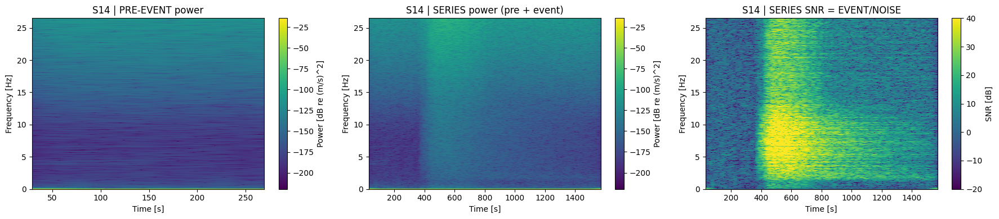

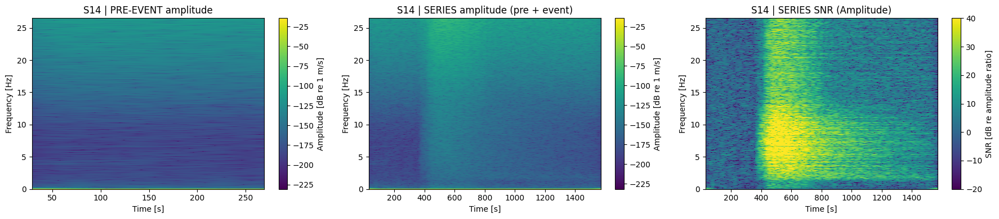

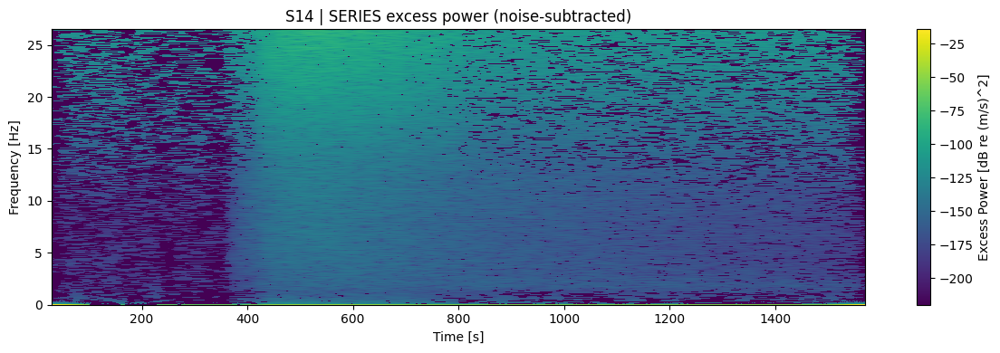

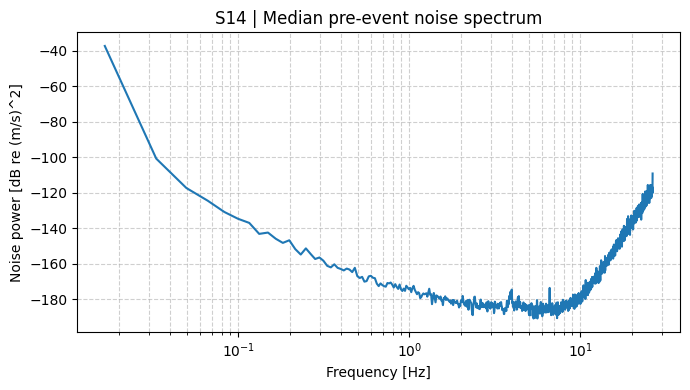

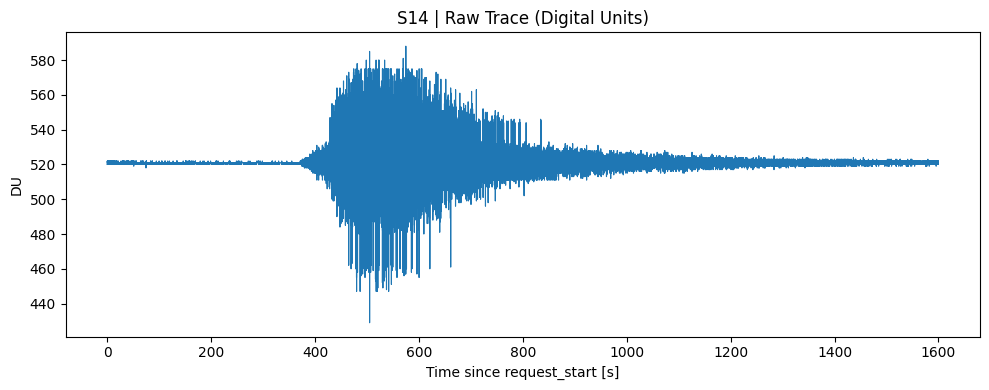

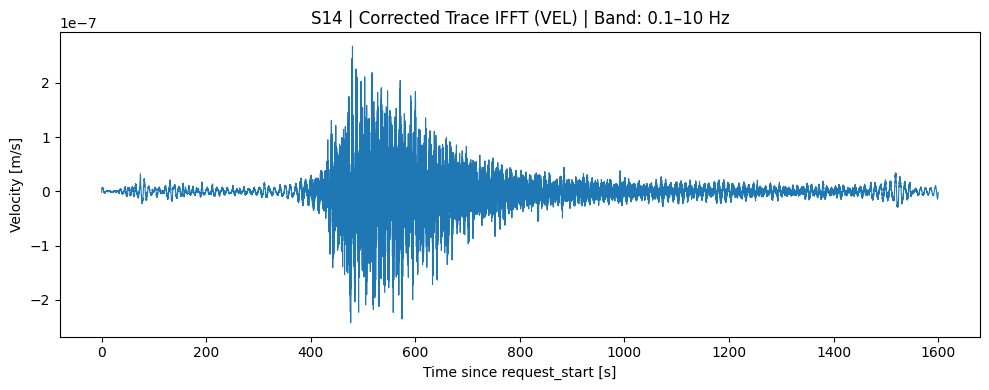

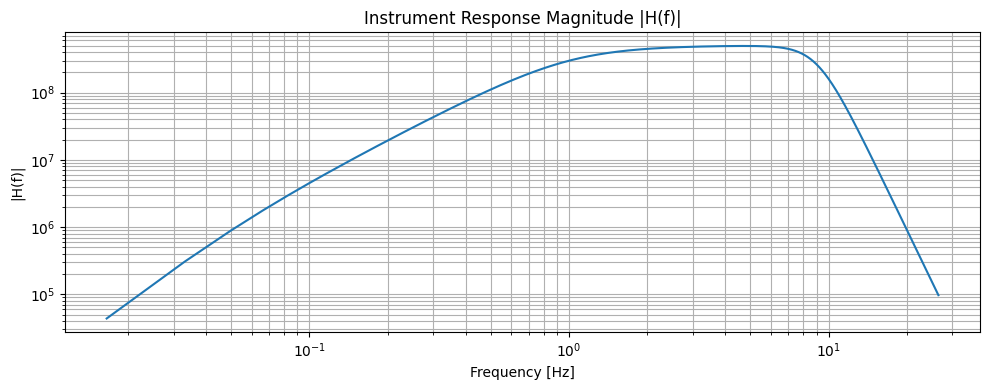

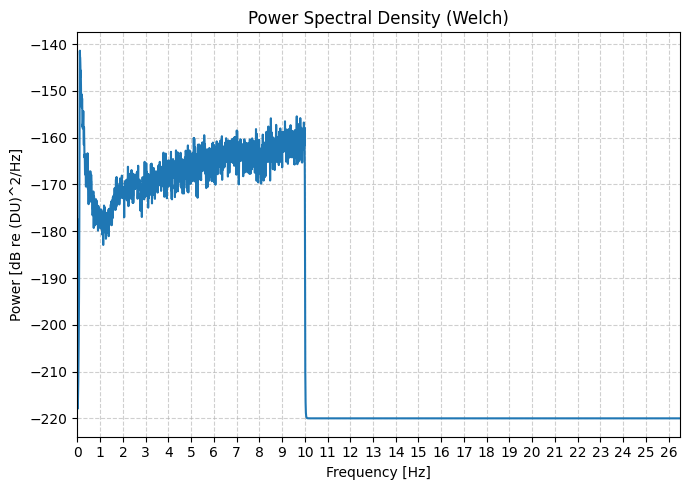

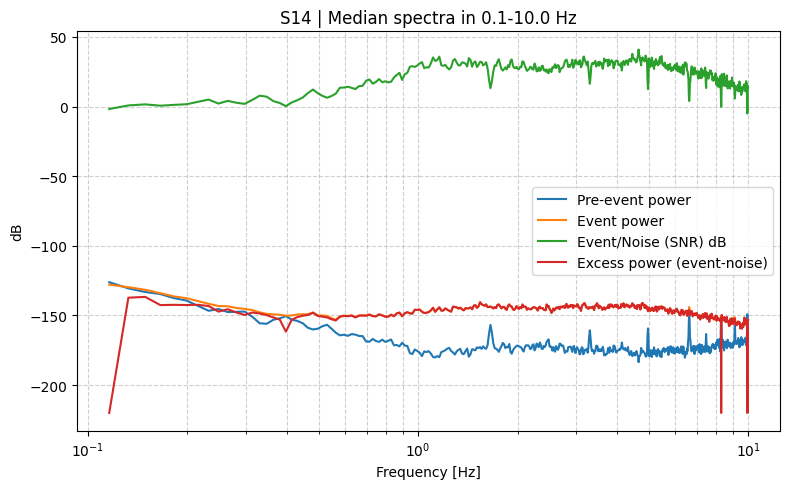


[Row 4] Station S15 | Request 1975-02-13T21:58:50.780000 → 1975-02-13T22:25:30.780000 | Dist=51.92091110555371 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84799, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1975-02-13T21:58:50.780000Z to 1975-02-13T22:25:30.780000Z  |  Event 1975-02-13T22:03:50.780000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 620


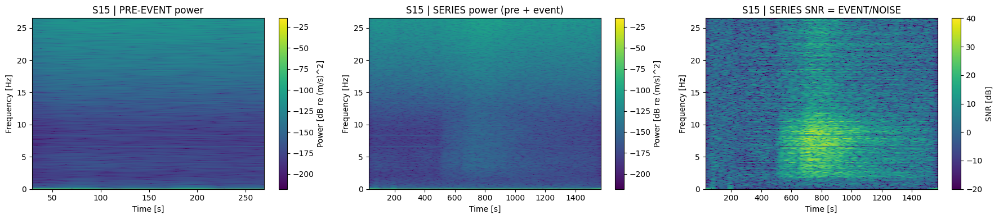

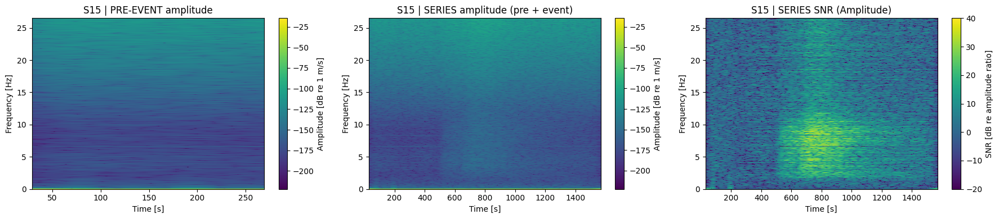

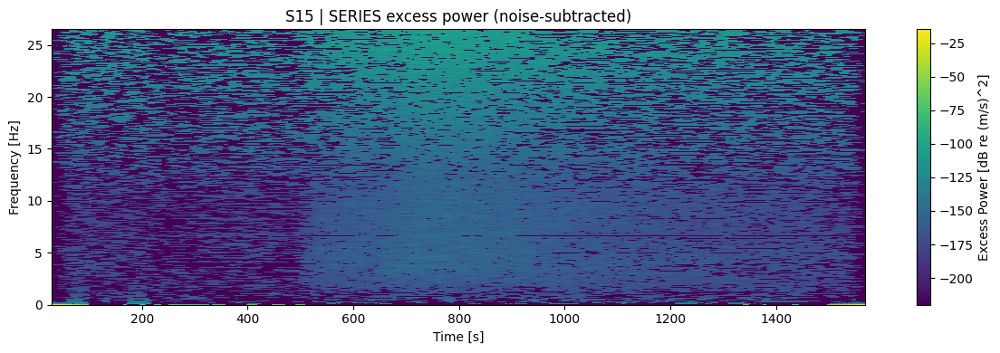

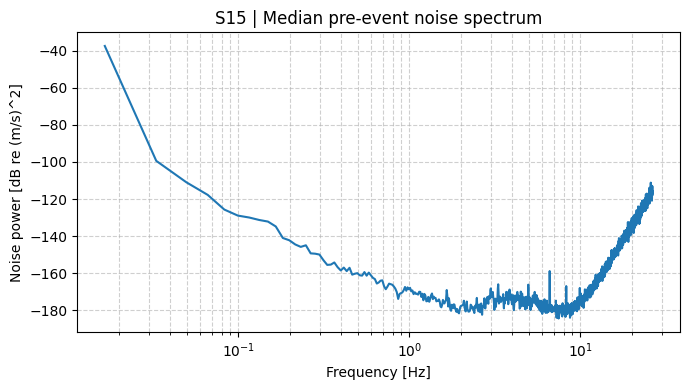

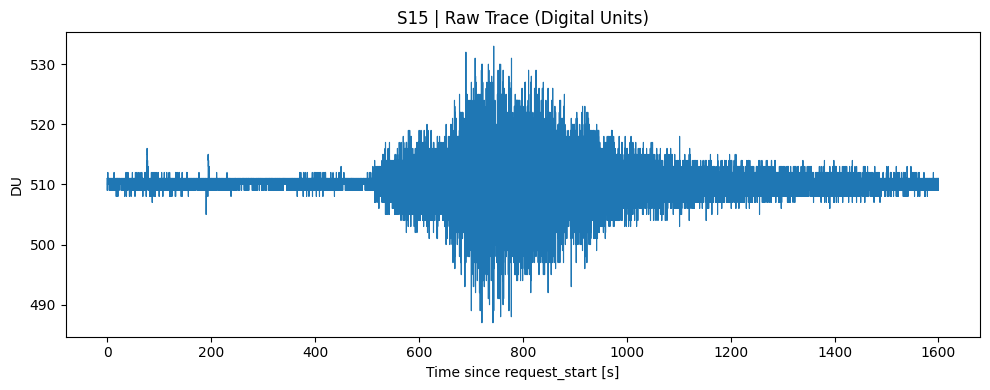

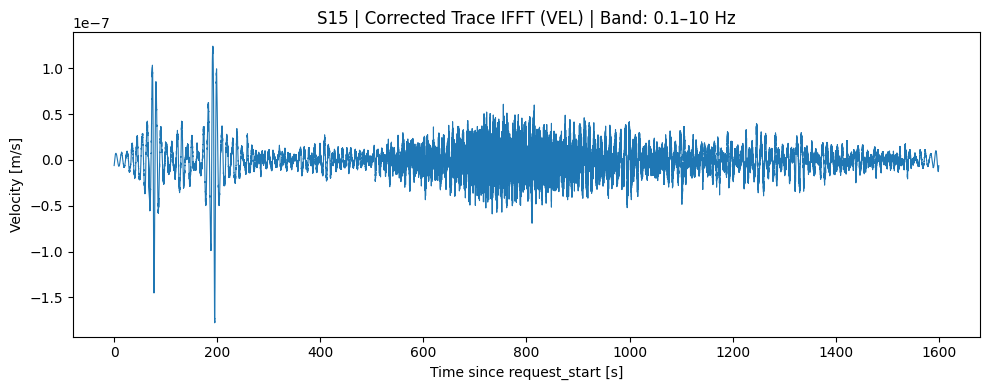

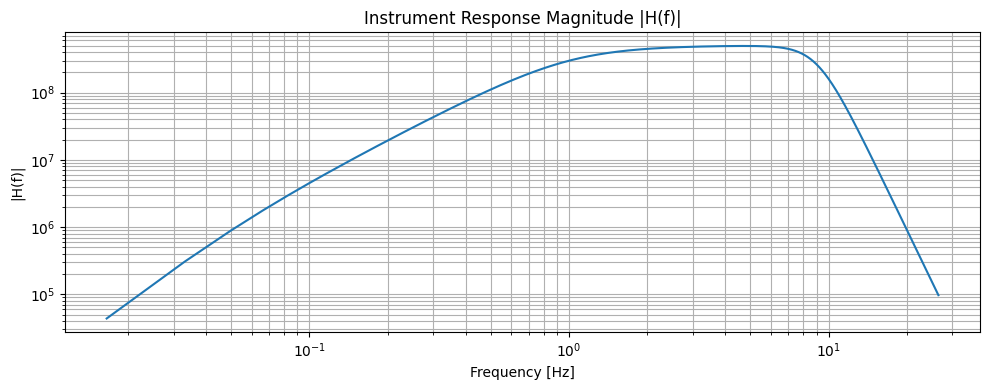

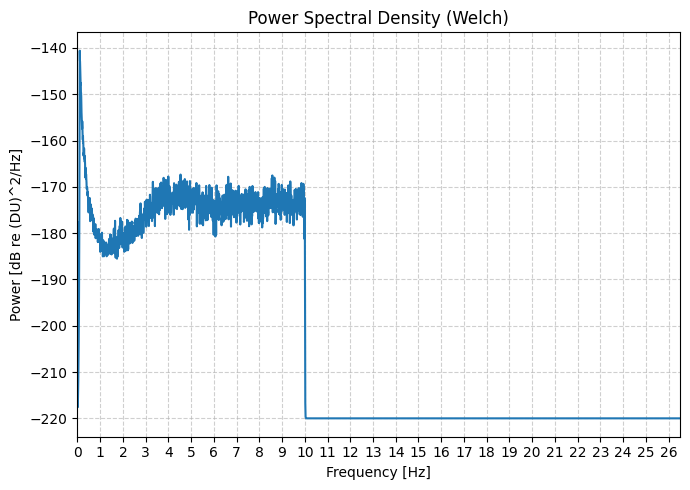

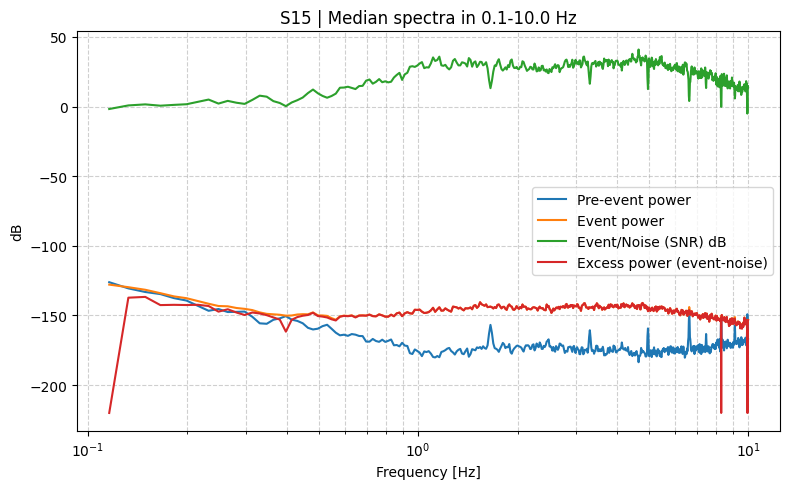


[Row 4] Station S16 | Request 1975-02-13T21:58:50.780000 → 1975-02-13T22:25:30.780000 | Dist=41.23674597933441 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1975-02-13T21:58:50.780000Z to 1975-02-13T22:25:30.780000Z  |  Event 1975-02-13T22:03:50.780000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


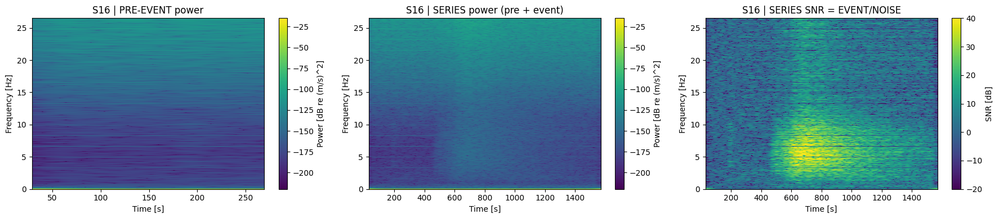

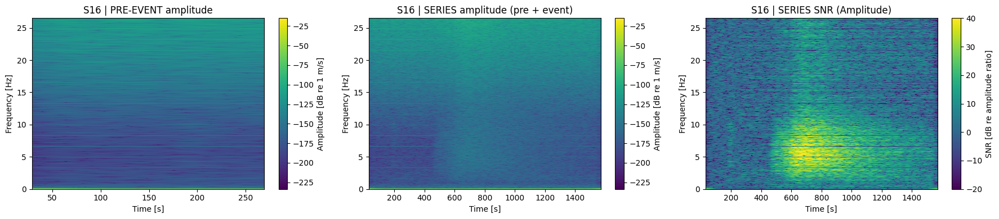

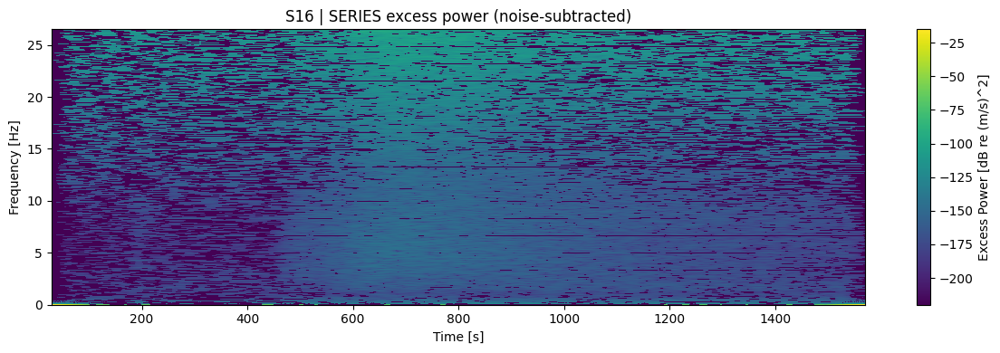

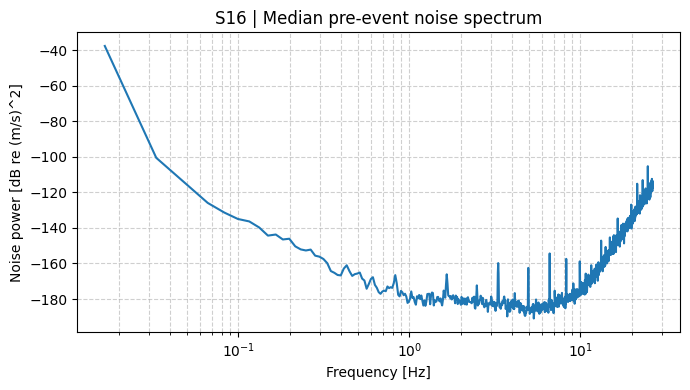

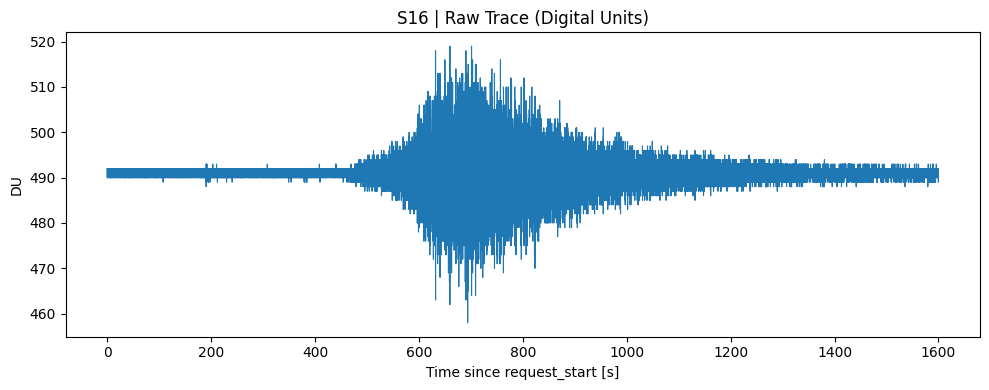

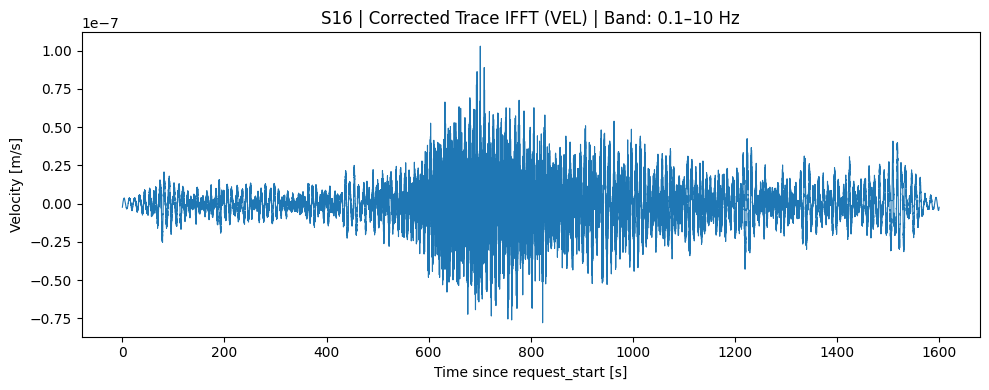

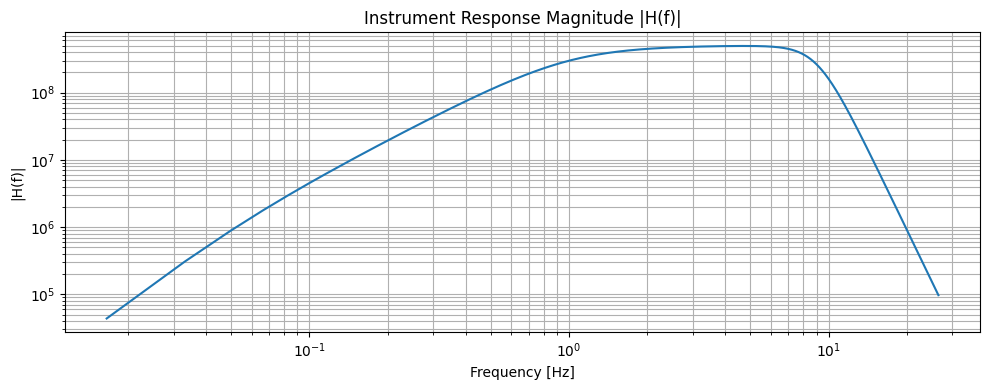

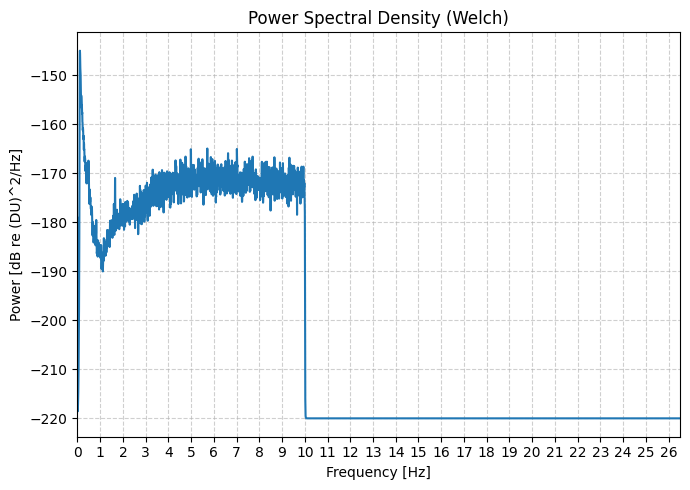

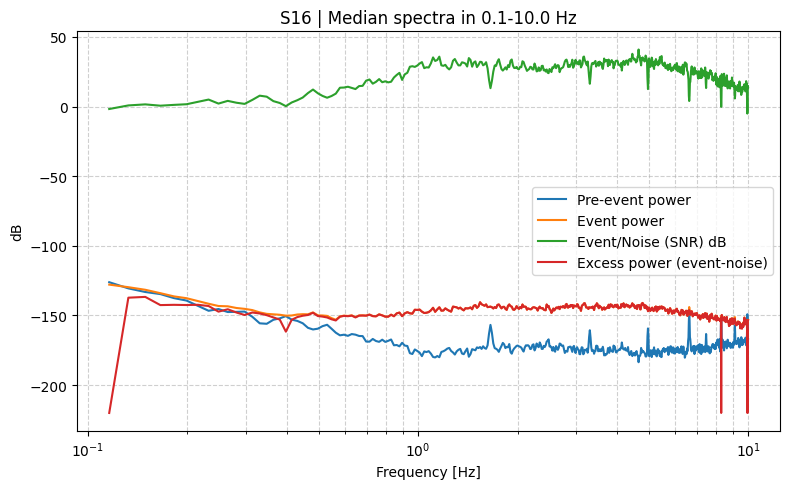


[Row 5] Station S14 | Request 1976-01-04T11:13:54.920000 → 1976-01-04T11:40:34.920000 | Dist=66.2712959366044 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 4 segments; using longest
  n=45760, fs=53.00 Hz, duration=863.4 s
  STFT nfft=3200 for window=60.0s
Request: 1976-01-04T11:13:54.920000Z to 1976-01-04T11:40:34.920000Z  |  Event 1976-01-04T11:18:54.920000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 252


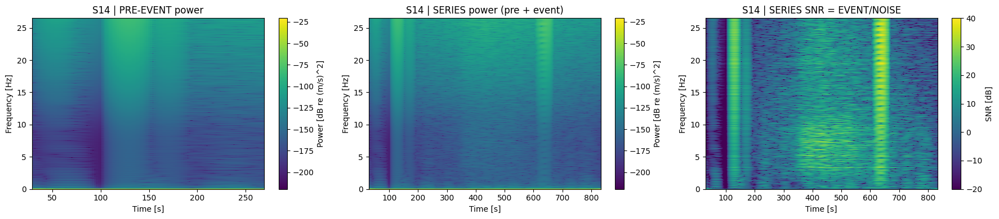

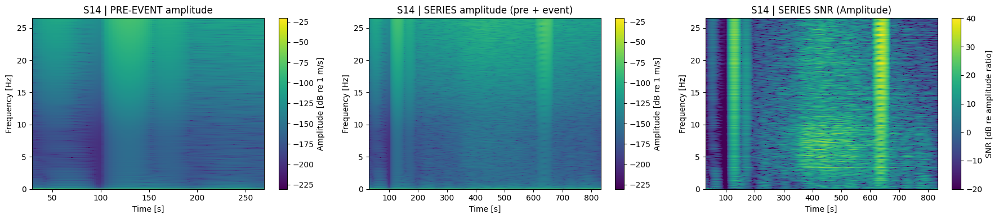

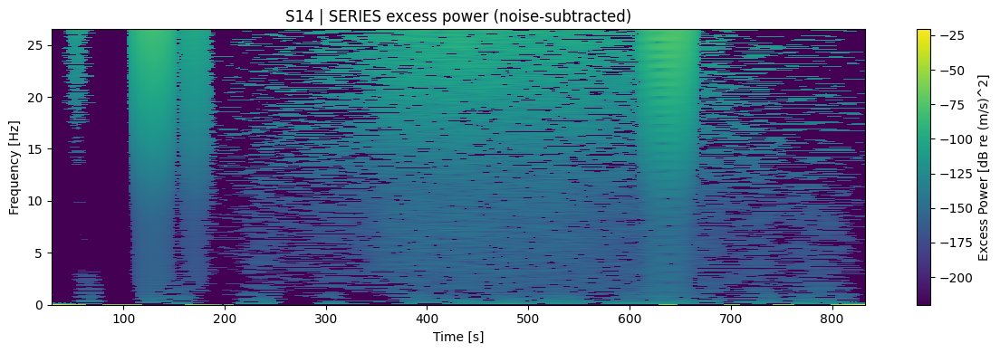

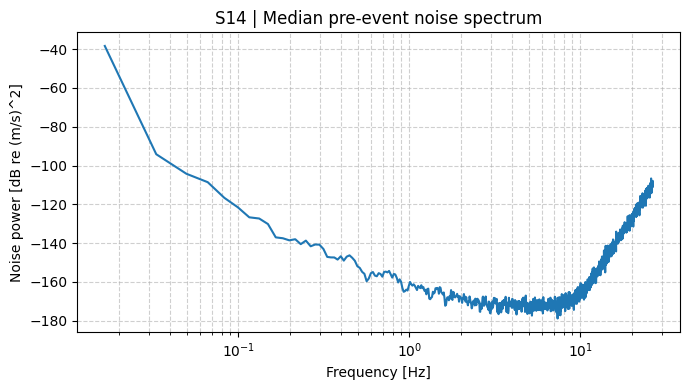

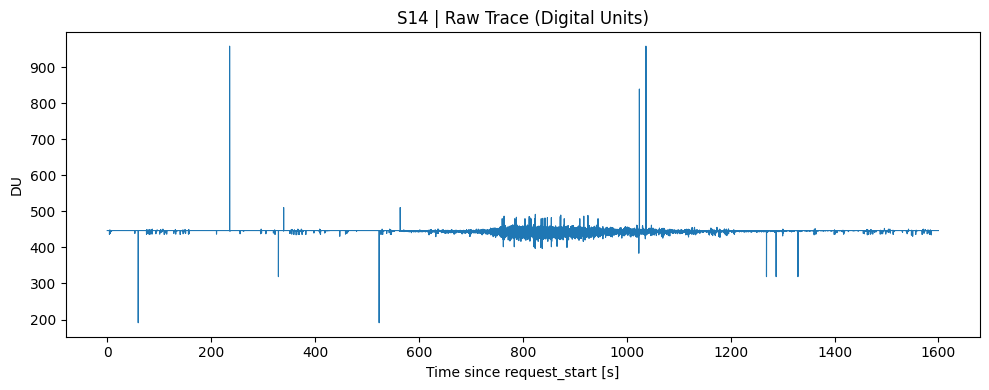

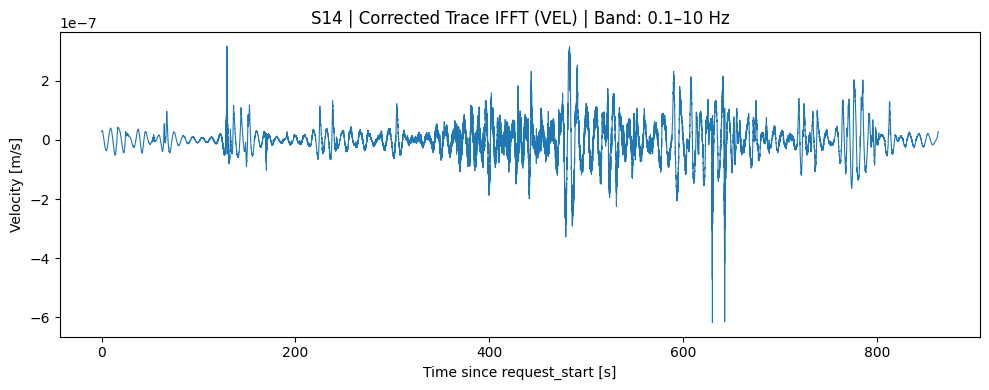

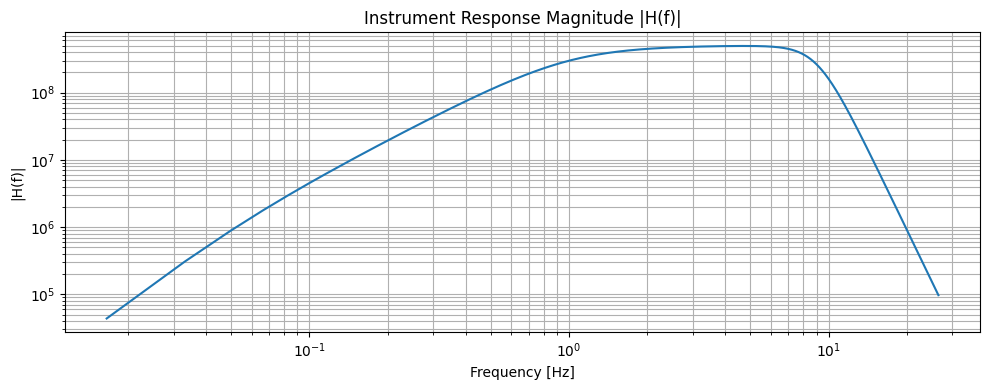

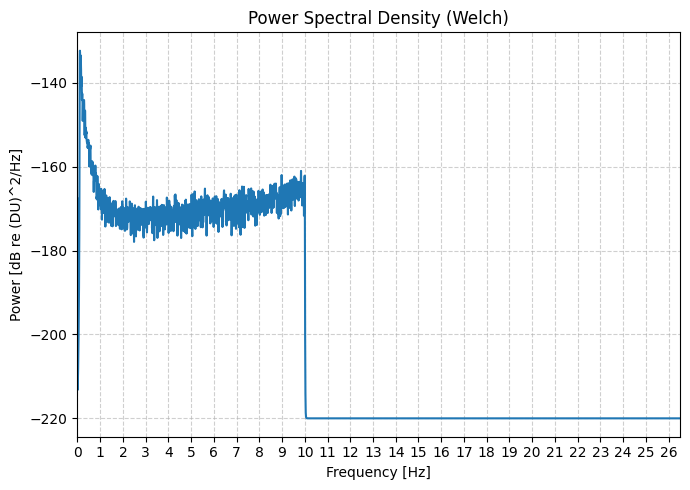

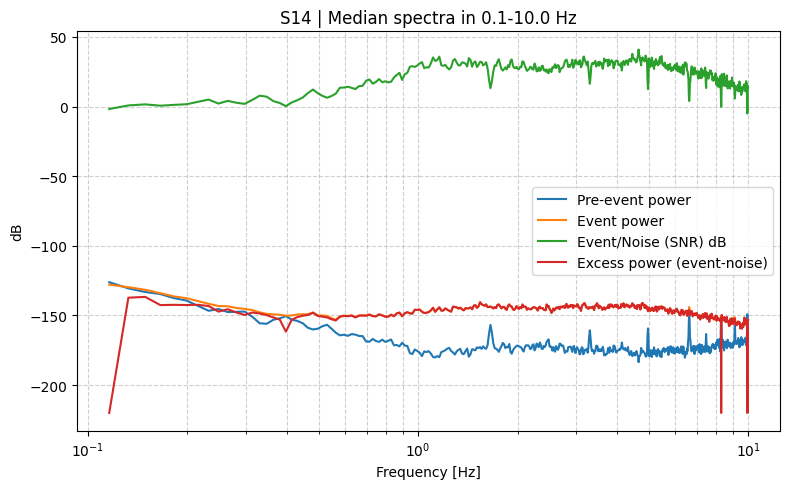


[Row 5] Station S15 | Request 1976-01-04T11:13:54.920000 → 1976-01-04T11:40:34.920000 | Dist=30.37022875341051 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1976-01-04T11:13:54.920000Z to 1976-01-04T11:40:34.920000Z  |  Event 1976-01-04T11:18:54.920000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


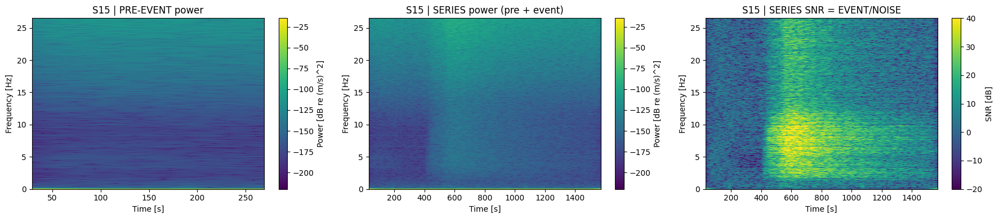

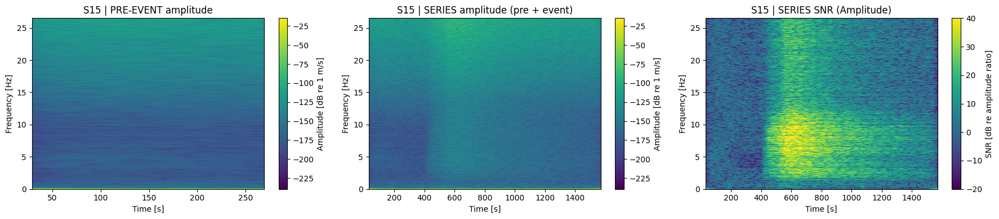

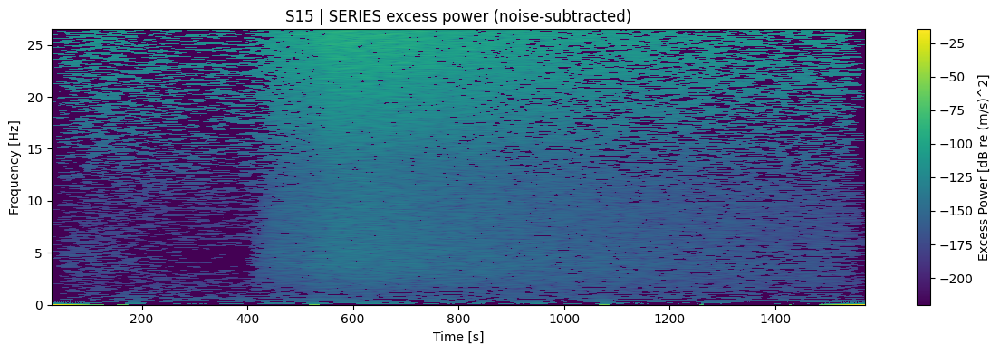

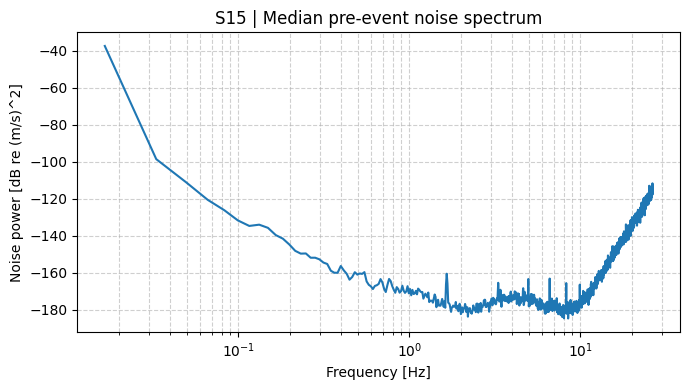

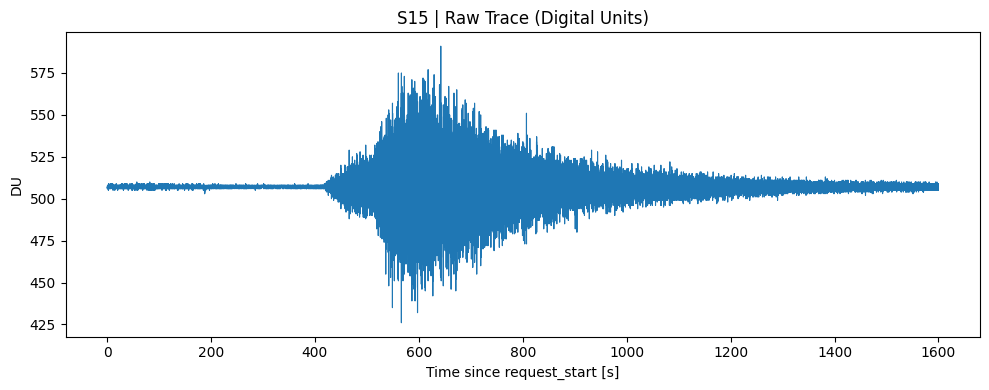

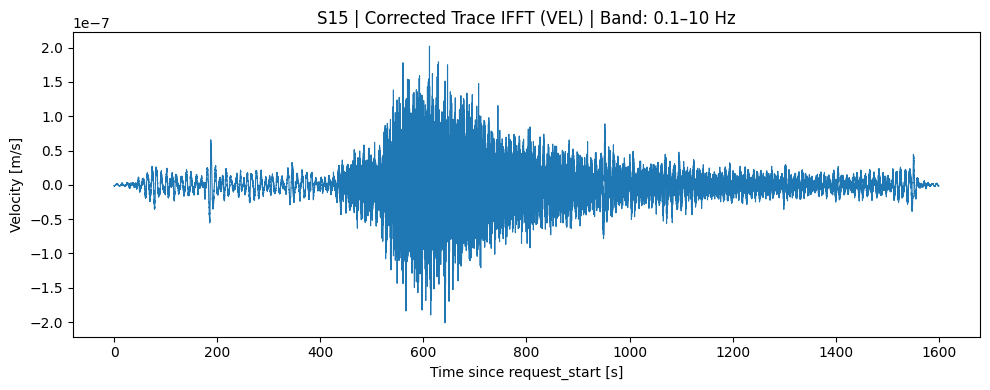

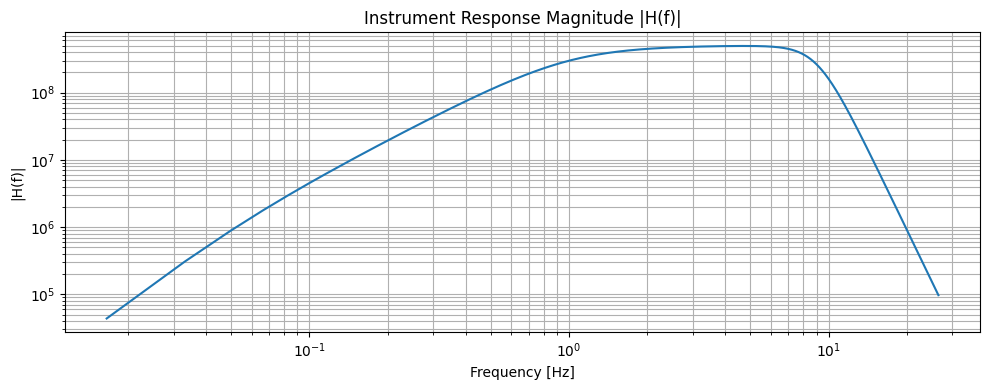

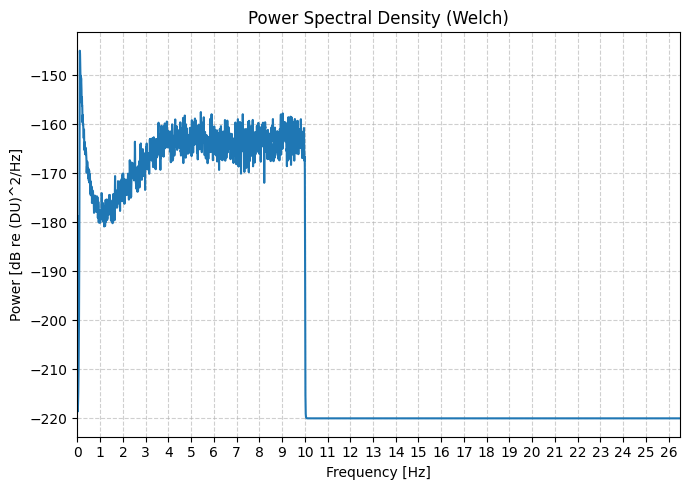

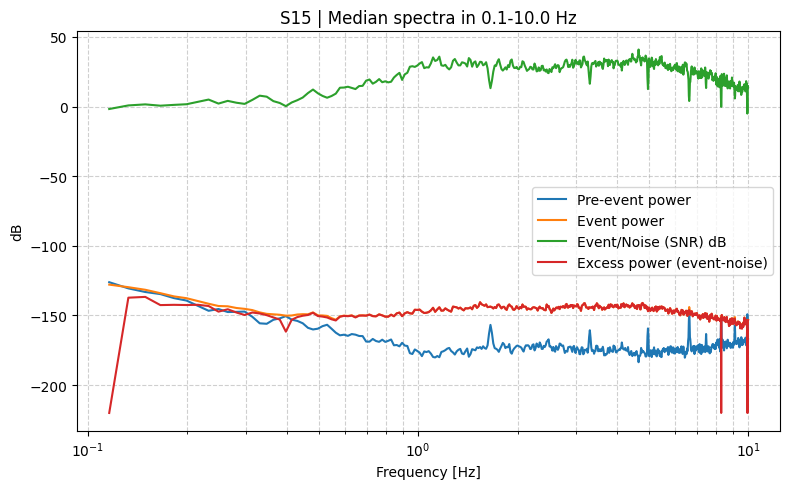


[Row 5] Station S16 | Request 1976-01-04T11:13:54.920000 → 1976-01-04T11:40:34.920000 | Dist=55.66049300424843 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 2 segments; using longest
  n=59575, fs=53.00 Hz, duration=1124.1 s
  STFT nfft=3200 for window=60.0s
Request: 1976-01-04T11:13:54.920000Z to 1976-01-04T11:40:34.920000Z  |  Event 1976-01-04T11:18:54.920000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 383


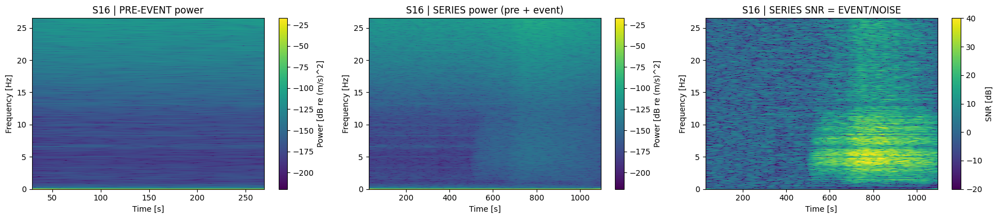

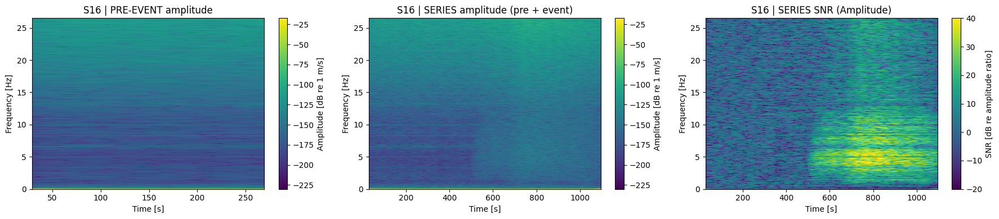

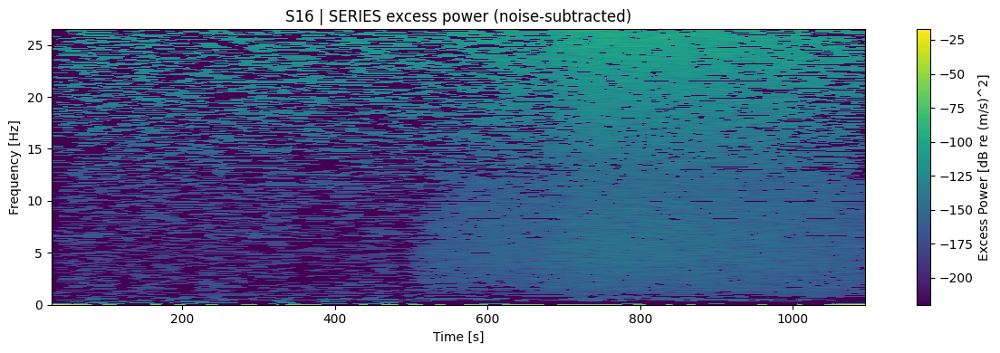

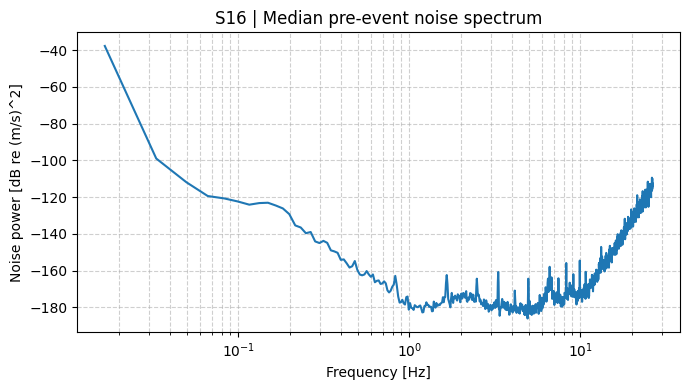

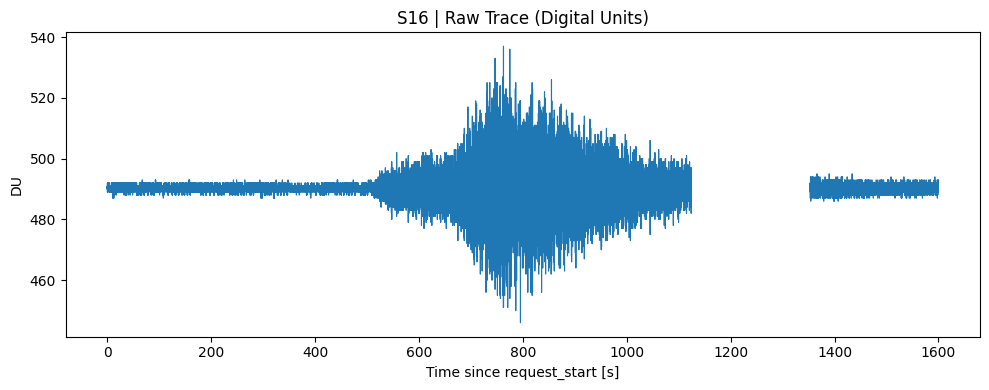

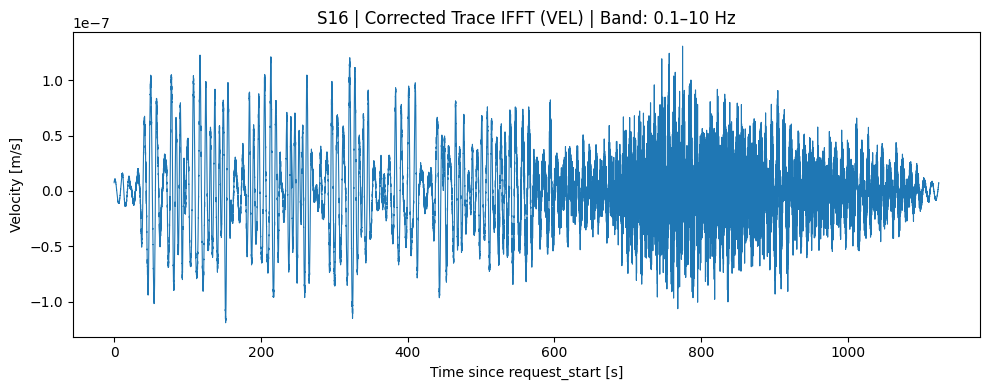

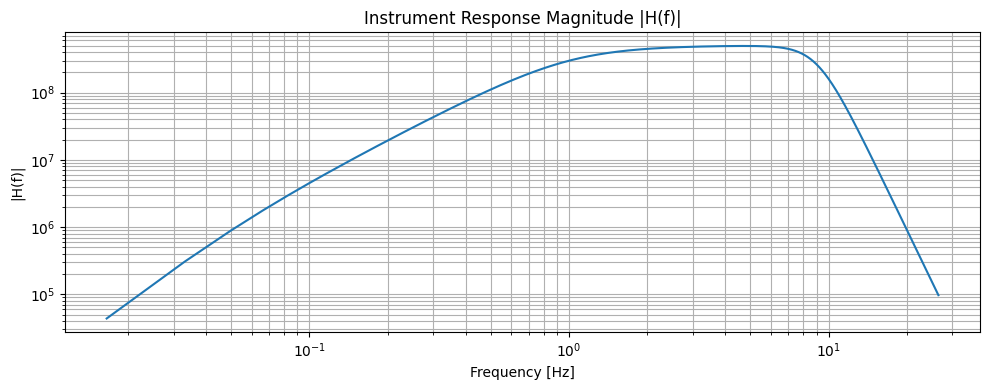

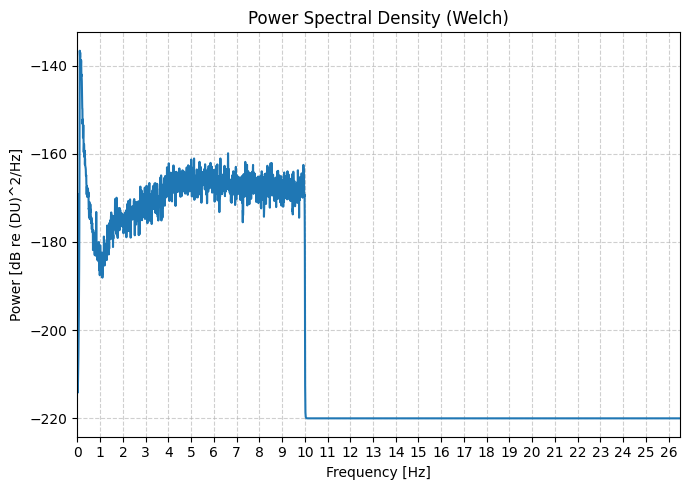

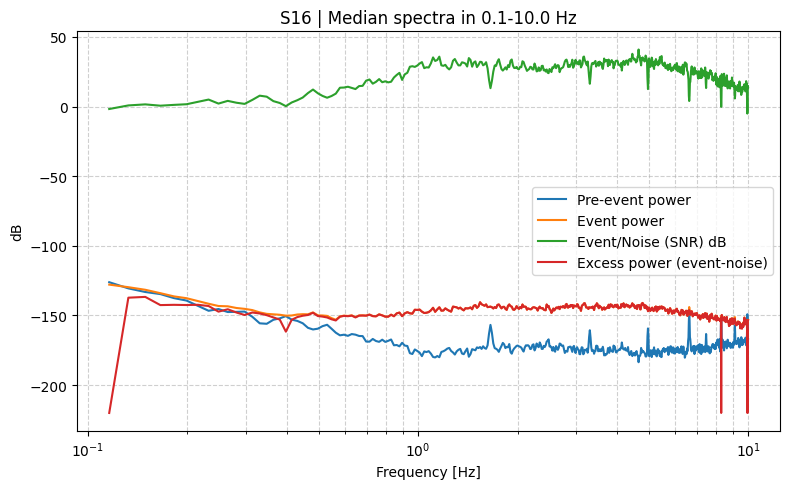


[Row 6] Station S14 | Request 1976-03-06T10:07:22.080000 → 1976-03-06T10:34:02.080000 | Dist=56.58839608428507 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 2 segments; using longest
  n=72439, fs=53.00 Hz, duration=1366.8 s
  STFT nfft=3200 for window=60.0s
Request: 1976-03-06T10:07:22.080000Z to 1976-03-06T10:34:02.080000Z  |  Event 1976-03-06T10:12:22.080000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 504


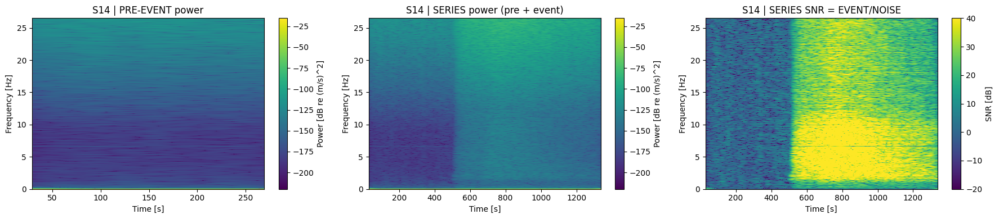

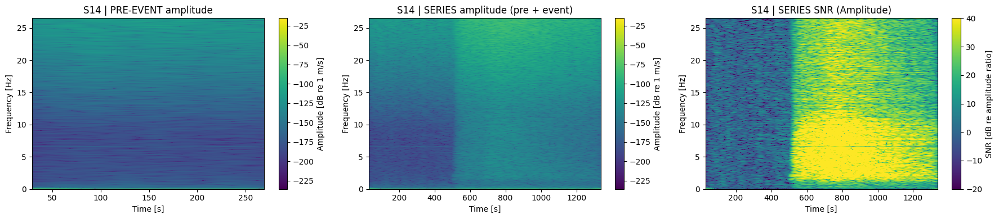

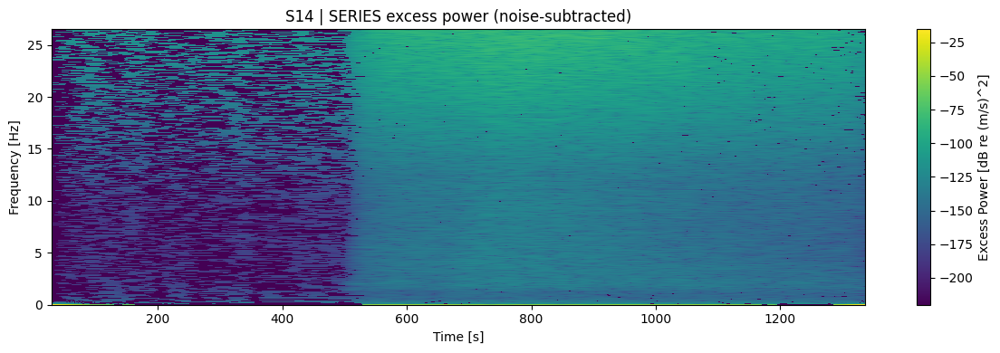

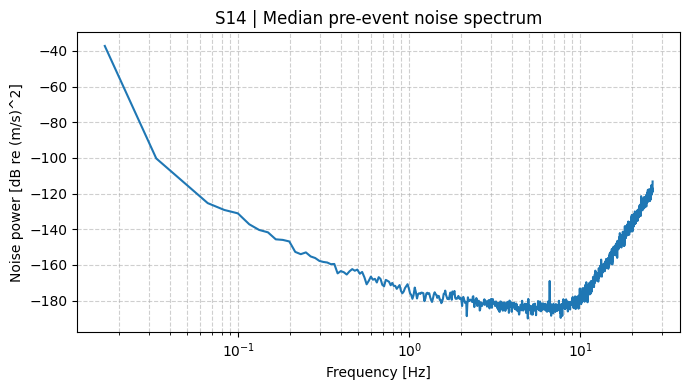

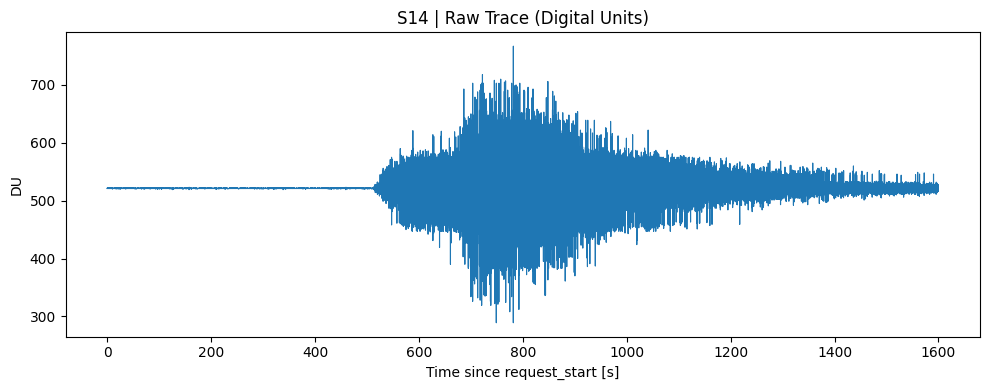

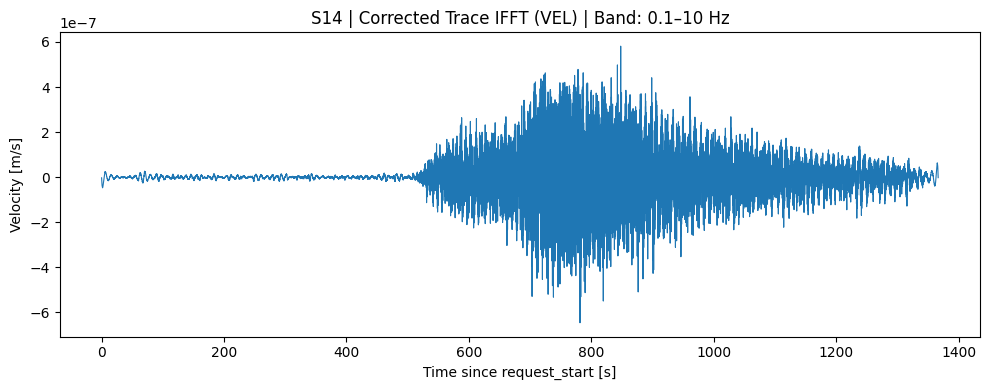

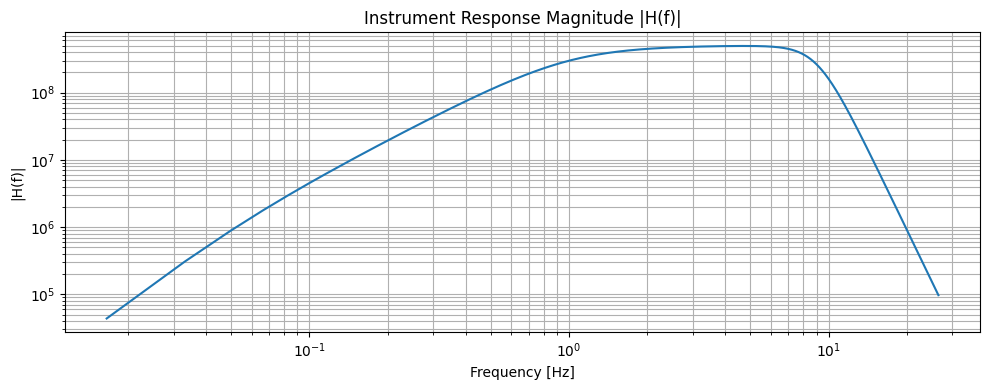

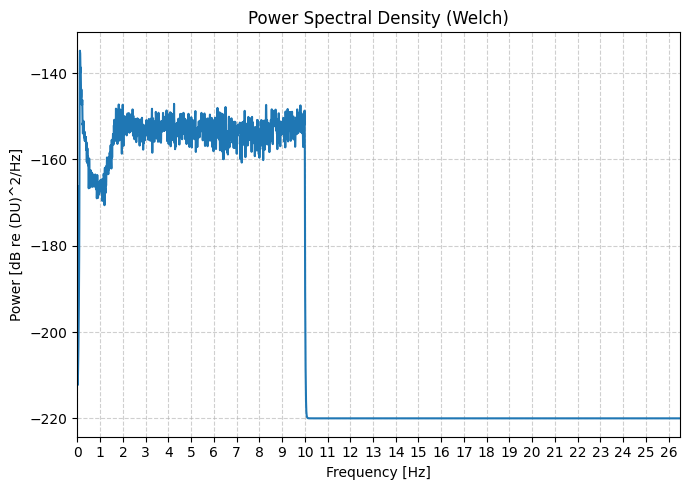

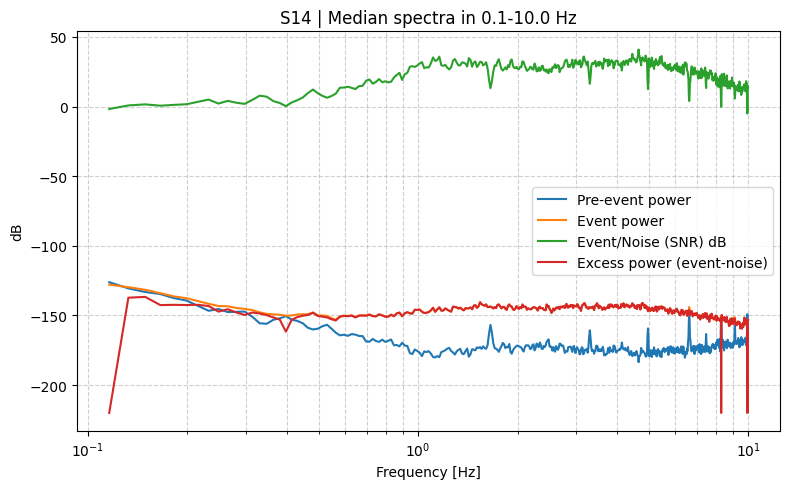


[Row 6] Station S15 | Request 1976-03-06T10:07:22.080000 → 1976-03-06T10:34:02.080000 | Dist=34.36898518245977 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84799, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1976-03-06T10:07:22.080000Z to 1976-03-06T10:34:02.080000Z  |  Event 1976-03-06T10:12:22.080000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 620


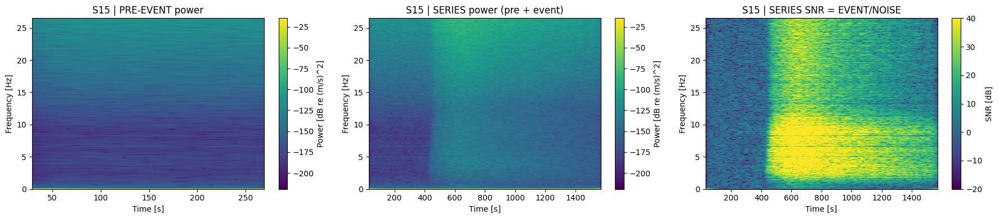

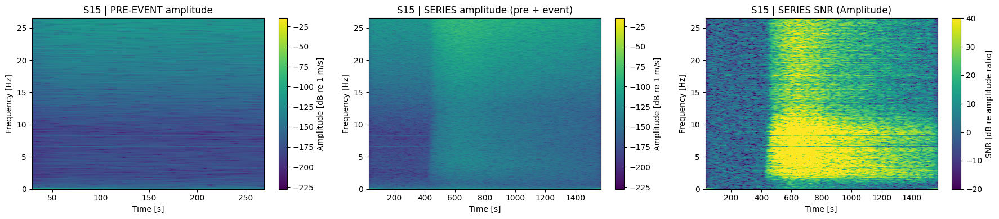

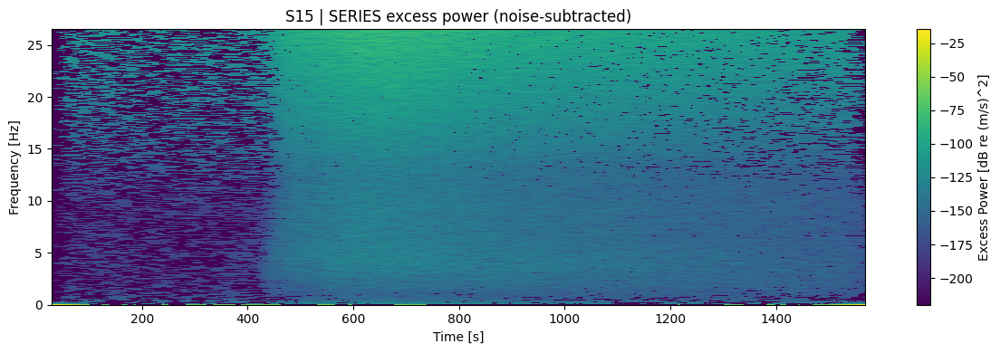

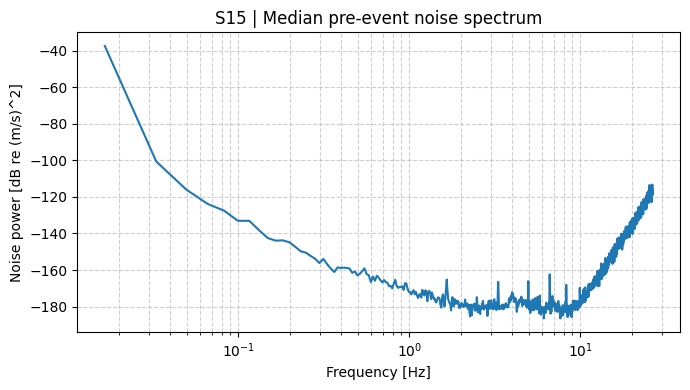

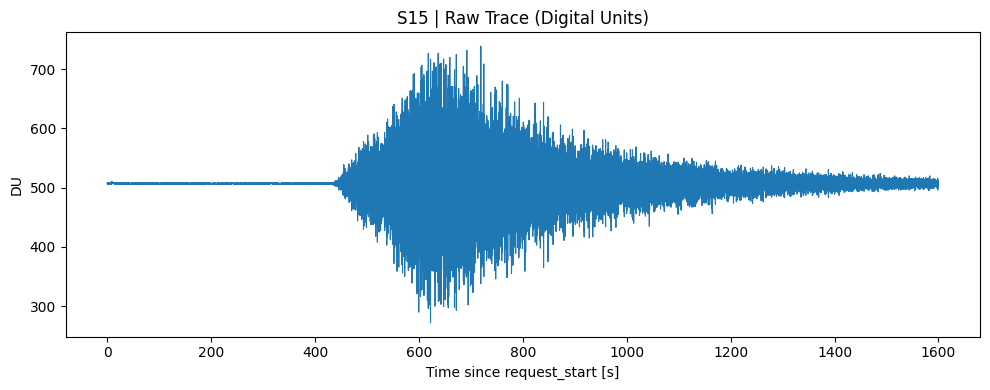

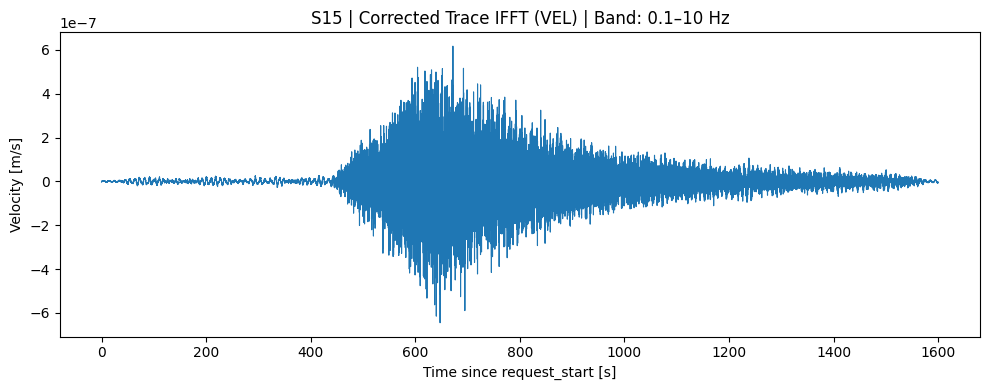

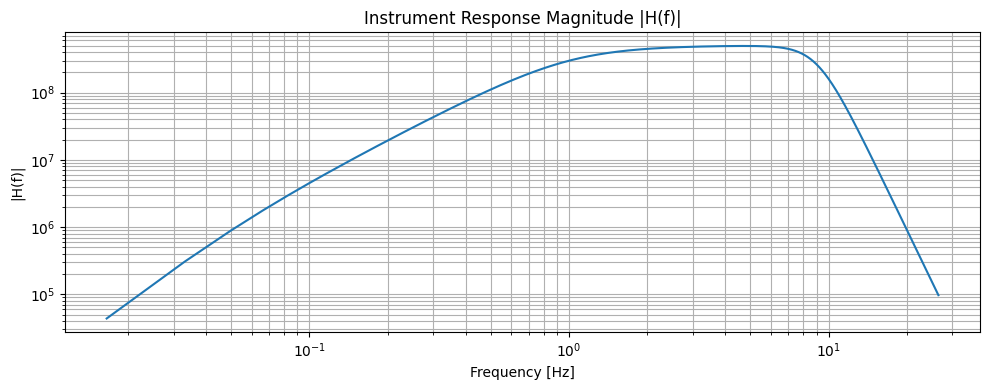

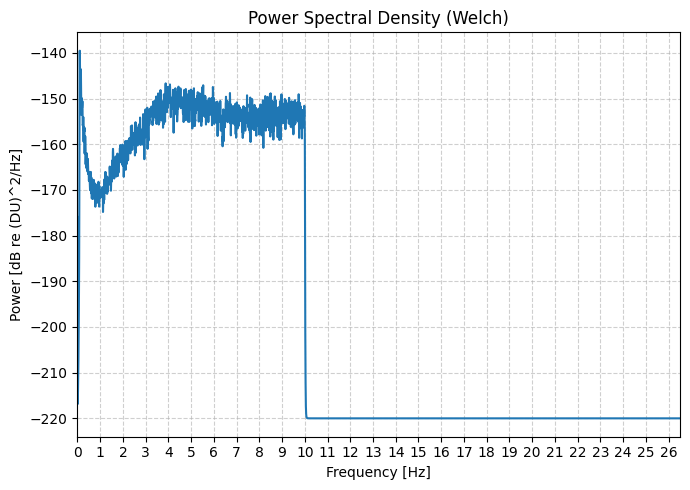

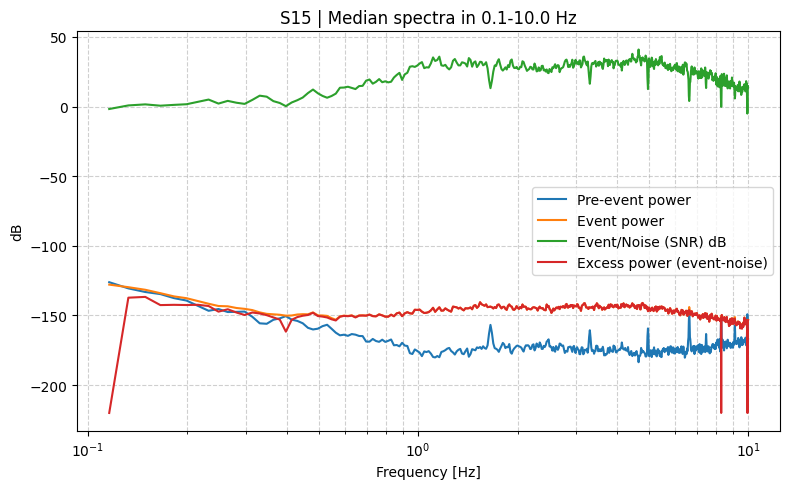


[Row 6] Station S16 | Request 1976-03-06T10:07:22.080000 → 1976-03-06T10:34:02.080000 | Dist=70.85455515572247 deg


/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/src/heterogeneities/processing.py:31: FutureWarning: The 'downcast' keyword in Series.interpolate is deprecated and will be removed in a future version. Call result.infer_objects(copy=False) on the result instead.
  s.interpolate(
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: divide by zero encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:48: RuntimeWarning: invalid value encountered in divide
  mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
/var/folders/_b/zk3mw_fs0bz5l7wcb96c8x_h0000gr/T/ipykernel_77075/4087618742.py:250: RuntimeWarning: invalid value encountered in divide
  SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power 

    Masked trace -> split into 1 segments; using longest
  n=84800, fs=53.00 Hz, duration=1600.0 s
  STFT nfft=3200 for window=60.0s
Request: 1976-03-06T10:07:22.080000Z to 1976-03-06T10:34:02.080000Z  |  Event 1976-03-06T10:12:22.080000Z  |  event_offset=300.0s
Pre frames: 120, Event frames: 621


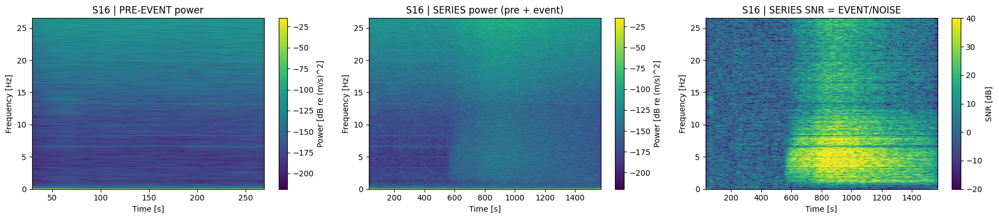

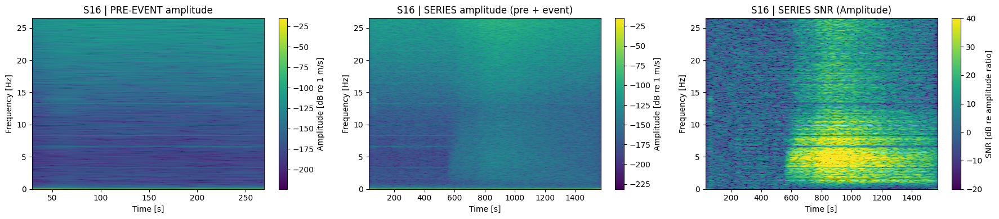

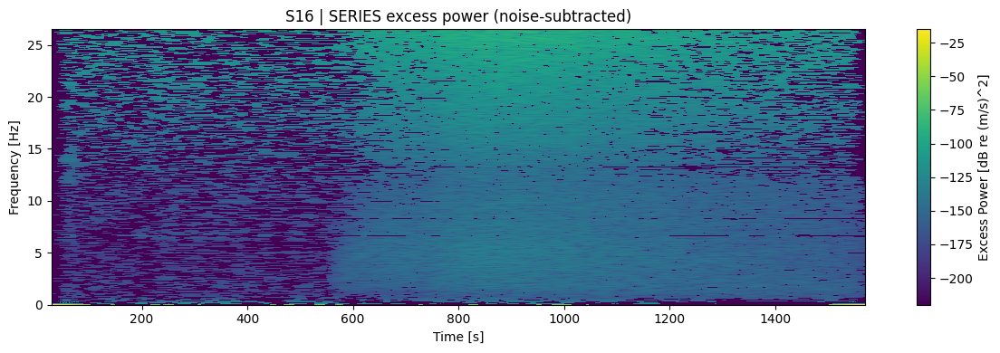

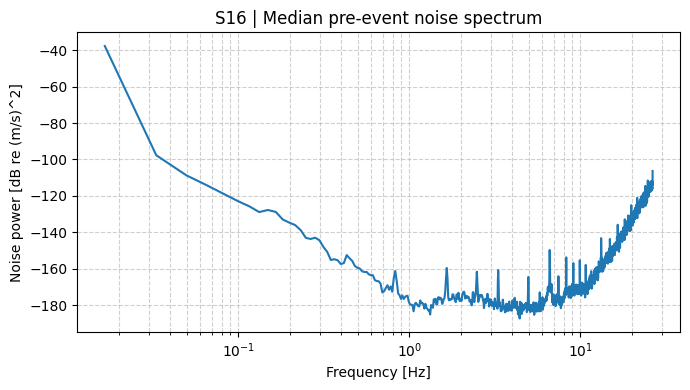

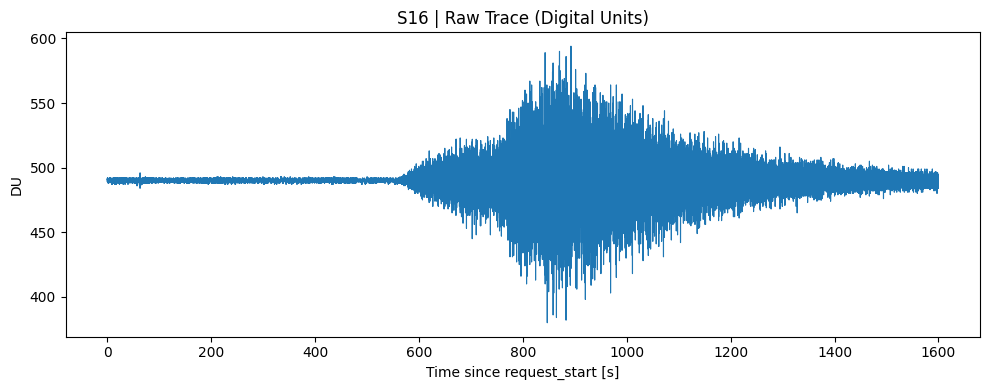

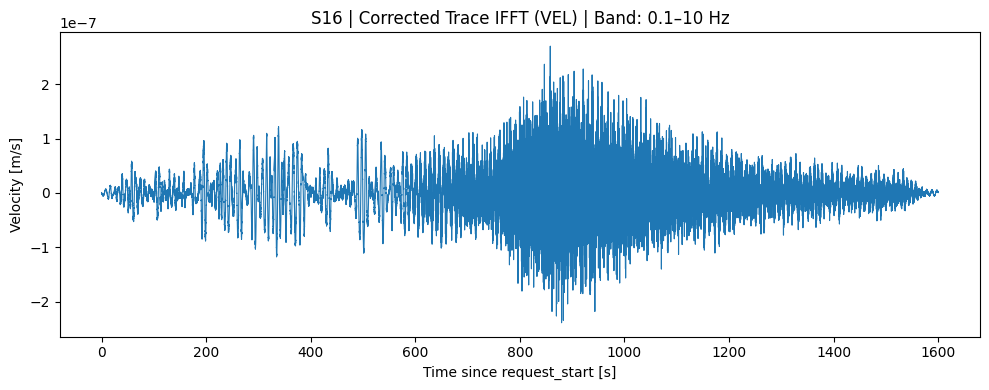

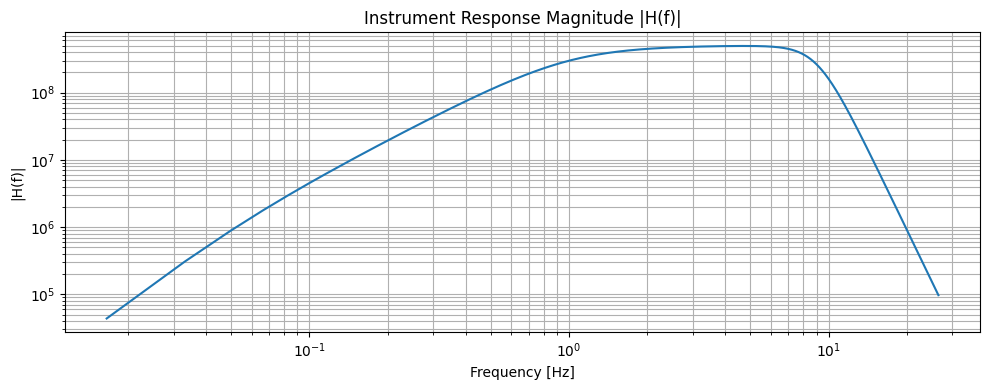

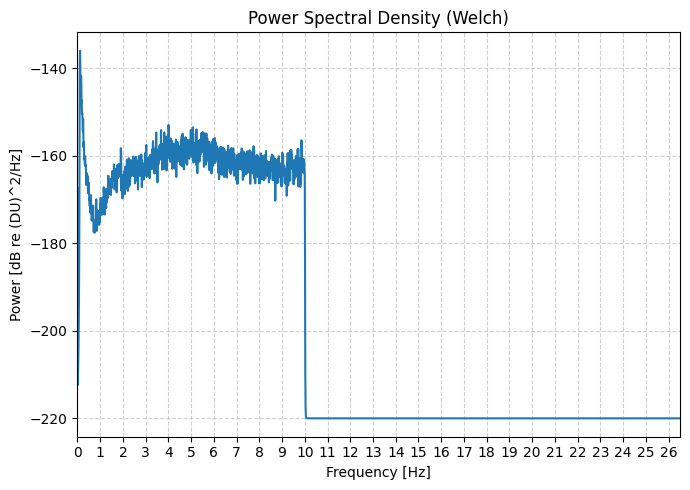

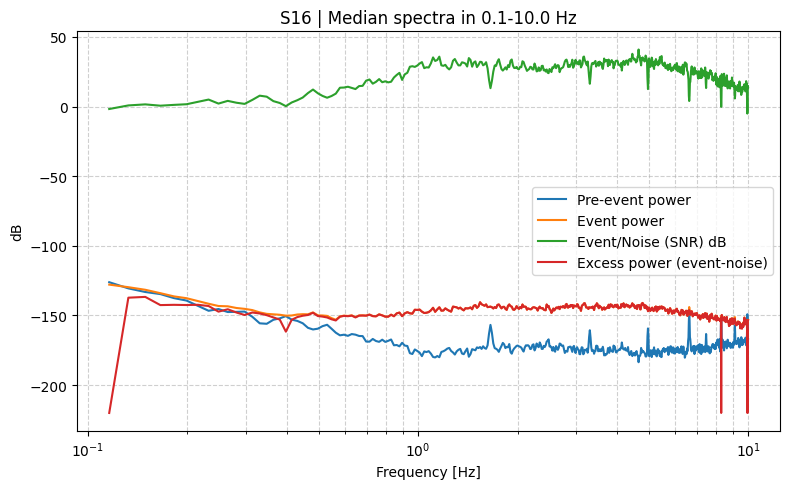

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from numpy.fft import rfft, rfftfreq
from scipy.signal import get_window, welch
from obspy import UTCDateTime, Trace
from obspy.clients.fdsn.client import Client
from heterogeneities.processing import linear_interpolation
from pathlib import Path
from scipy.fft import next_fast_len
from matplotlib.ticker import MultipleLocator

# ------------------- TF helpers -------------------
def tf_map_divide_H(
    x, fs, H,
    win_sec=1.0, step_sec=0.5,
    window_type="hann", detrend=False,
    n_fft=None, eps=1e-22, db=False
):
    """
    Sliding STFT magnitude of x, deconvolved by H (instrument response).
    Returns: times [s], freqs [Hz], S where S has shape (n_freqs, n_frames).
    If db=False, S is linear amplitude in physical units (e.g., m/s).
    If db=True, S is amplitude in dB re 1 physical unit (20*log10).
    """
    x = np.asarray(x, dtype=float)
    N = len(x)
    win_len = int(round(win_sec * fs))
    hop = int(round(step_sec * fs))
    if n_fft is None:
        n_fft = next_fast_len(win_len)


    # windowing
    w = get_window(window_type, win_len, fftbins=True).astype(float)
    w_norm = np.linalg.norm(w)

    # frequency axis for rfft
    freqs = rfftfreq(n_fft, d=1.0/fs)

    H = np.asarray(H, dtype=complex)
    times, cols = [], []
    for start in range(0, N - win_len + 1, hop):
        seg = x[start:start + win_len]
        if detrend:
            seg = seg - seg.mean()
        X = rfft(seg * w, n=n_fft) / (w_norm + 1e-18)  # amplitude spectrum (DU scaled by window norm)
        mag = np.abs(X / H)  # divide by instrument response -> physical amplitude (e.g., m/s)
        if db:
            mag = 20.0 * np.log10(mag + eps)
        cols.append(mag)
        # frame center in seconds from trace start
        times.append((start + win_len/2) / fs)

    S = np.stack(cols, axis=1)  # (n_freqs, n_frames)
    return np.asarray(times), freqs, S


def deconvolve_full_trace_by_H(x, fs, H, n_fft=None, eps=1e-22,
                               hp_cut=None, lp_cut=None):
    """
    Full-trace deconvolution by response H in frequency domain.
    Returns time-series 'u' in physical units (matching H's output).
    """
    x = np.asarray(x, dtype=float)
    N = len(x)
    if n_fft is None:
        n_fft = N

    freqs = rfftfreq(n_fft, d=1.0/fs)

    H = np.asarray(H, dtype=complex)
    U = rfft(x, n=n_fft) / (H + eps)
    if hp_cut is not None:
        U[freqs < hp_cut] = 0
    if lp_cut is not None:
        U[freqs > lp_cut] = 0

    u = np.fft.irfft(U, n=n_fft)[:N]
    t = np.arange(N) / fs
    return u, t


# ------------------- MAIN -------------------
if __name__ == "__main__":
    # Where to store spectrogram matrices (npz files)
    spectro_dir = Path("./spectrogram_cache_npz")
    spectro_dir.mkdir(parents=True, exist_ok=True)

    # Load your CSV
    df = pd.read_csv(
        "/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/data/raw/lognonne2003_table3_partial_with_dist_with_dist_with_epidist.csv"
    )

    # Map station -> distance column (these are degrees in your table)
    station_to_distcol = {
        "S14": "epi_dist_A14_deg",
        "S15": "epi_dist_A15_deg",
        "S16": "epi_dist_A16_deg",
    }

    network = "XA"
    channel = "SHZ"
    output_physical = "VEL"   # "DISP" | "VEL" | "ACC"
    request_length_sec = 1600 # total request length (includes pre_pad)
    pre_pad = 300.0           # seconds of noise to fetch before the event
    window = 60.0             # STFT window length [s]
    step = 2.0                # STFT step [s]
    eps = 1e-22

    client = Client("IRIS")

    for idx, row in df.iterrows():
        # Parse event time
        try:
            event_time = UTCDateTime(str(row["starttime"]))  # catalog event time
        except Exception as e:
            print(f"[Row {idx}] Skipping: could not parse starttime ({row.get('starttime')}): {e}")
            continue

        # Fetch from (event - pre_pad) for request_length_sec
        request_start = event_time - pre_pad
        request_end   = request_start + request_length_sec

        # for client calls
        starttime = request_start
        endtime   = request_end

        for station, dist_col in station_to_distcol.items():
            # distance (deg) if present
            try:
                dist_deg = float(row[dist_col])
            except Exception:
                dist_deg = np.nan

            print(f"\n[Row {idx}] Station {station} | Request {starttime.isoformat()} → {endtime.isoformat()} | Dist={dist_deg} deg")

            try:
                # --- Inventory and waveform
                inv = client.get_stations(
                    starttime=starttime, endtime=endtime,
                    network=network, station=station, location="*", channel=channel,
                    level="response"
                )
                st = client.get_waveforms(
                    network=network, station=station, location="*", channel=channel,
                    starttime=starttime, endtime=endtime
                )
                if len(st) == 0:
                    print("  No waveforms returned.")
                    continue

                tr = st[0].copy()
                tr_raw = tr.copy()
                _ = linear_interpolation(tr_raw, interpolation_limit=1)

                # Raw plotting array with NaNs for gaps
                if np.ma.isMaskedArray(tr_raw.data):
                    tr_raw_plot = np.ma.filled(tr_raw.data, np.nan)
                else:
                    tr_raw_plot = tr_raw.data.astype(float, copy=False)

                # Working trace: interpolate small gaps
                _ = linear_interpolation(tr, interpolation_limit=1)

                # If still masked, keep longest contiguous segment
                if np.ma.isMaskedArray(tr.data):
                    segs = tr.split()
                    if len(segs) == 0:
                        print("    No contiguous segments after split(); skipping")
                        continue
                    tr = max(segs, key=lambda tt: tt.stats.npts)
                    print(f"    Masked trace -> split into {len(segs)} segments; using longest")

                # Force-unmask if needed
                if np.ma.isMaskedArray(tr.data):
                    tr.data = np.ma.filled(tr.data, 0.0)

                fs = tr.stats.sampling_rate
                n  = tr.stats.npts
                t  = np.arange(n) / fs

                fs_raw = tr_raw.stats.sampling_rate
                n_raw  = tr_raw.stats.npts
                t_raw  = np.arange(n_raw) / fs_raw

                print(f"  n={n}, fs={fs:.2f} Hz, duration={n/fs:.1f} s")

                # Detrend/taper for FFT/deconv
                tr_detr = tr.copy()
                tr_detr.taper(max_percentage=0.05, type="cosine")
                tr_detr.detrend("demean")
                tr_detr.detrend("linear")

                data = tr_detr.data.astype(np.float64, copy=False)

                # --- Instrument response on exact FFT grids
                resp = inv.get_response(tr_detr.id, tr_detr.stats.starttime)

                # STFT grid
                nfft_stft = next_fast_len(int(round(window * fs)))
                print(f"  STFT nfft={nfft_stft} for window={window}s")
                H_stft, f_stft = resp.get_evalresp_response(
                    t_samp=1.0/fs, nfft=nfft_stft, output=output_physical
                )

                # Full-trace deconvolution grid
                nfft_full = n
                H_full, f_full = resp.get_evalresp_response(
                    t_samp=1.0/fs, nfft=nfft_full, output=output_physical
                )

                # --- STFT (LINEAR amplitude for math) ---
                times, freqs, S_amp = tf_map_divide_H(
                    data, fs, H_stft,
                    win_sec=window, step_sec=step,
                    window_type="hann", detrend=False,
                    n_fft=nfft_stft, db=False
                )
                P = S_amp**2  # power in (m/s)^2 if output_physical == "VEL"

                # Event position in STFT time axis
                event_offset = float(event_time - request_start)  # ~ pre_pad

                # Analyze only the event window (exclude pre noise from analysis)
                analysis_duration = request_length_sec - pre_pad
                analysis_end = event_offset + analysis_duration

                # Keep frames fully inside/outside the event (avoid leakage of the window)
                pre_t1   = max(0.0, event_offset - window/2.0)  # last frame fully before event
                event_t0 = event_offset + window/2.0            # first frame fully after event

                pre_mask          = (times >= 0.0) & (times < pre_t1)
                event_window_mask = (times >= event_t0) & (times < analysis_end)

                if not np.any(pre_mask):
                    raise ValueError(f"No pre-event frames (pre_t1={pre_t1:.2f}s). Increase pre_pad or reduce window.")
                if not np.any(event_window_mask):
                    raise ValueError(
                        f"No event frames in analysis window "
                        f"(event_t0={event_t0:.2f}s, analysis_end={analysis_end:.2f}s). "
                        "Increase request_length_sec."
                    )

                P_N_col = np.median(P[:, pre_mask], axis=1, keepdims=True)
                P_N_col = np.maximum(P_N_col, eps)

                S_amp_pre_db = 20.0 * np.log10(S_amp[:, pre_mask] + eps)
                S_amp_db_full = 20.0 * np.log10(S_amp + eps)
                SNR_Amp_db = 20.0 * np.log10((S_amp + eps) / np.sqrt(P_N_col + eps))  # amplitude ratio = sqrt(power ratio)


                times_pre = times[pre_mask]
                P_pre_db        = 10.0 * np.log10(P[:, pre_mask] + eps)
                P_db_full       = 10.0 * np.log10(P + eps)             # full-series power [dB re (m/s)^2]

                # SNR and dB-amplitude for display
                SNR_db          = 10.0 * np.log10((P + eps) / P_N_col)  # dB (dimensionless)

                P_excess_full   = np.maximum(P - P_N_col, 0.0)
                P_excess_db_full= 10.0 * np.log10(P_excess_full + eps) # full-series excess power

                print(f"Request: {request_start} to {request_end}  |  Event {event_time}  |  event_offset={event_offset:.1f}s")
                print(f"Pre frames: {np.count_nonzero(pre_mask)}, Event frames: {np.count_nonzero(event_window_mask)}")

                # --------- PLOTS ----------

            
                # --- 3-panel overview: pre-event, full power, full SNR ---
                plt.figure(figsize=(18,4))

                plt.subplot(1,3,1)
                plt.pcolormesh(times_pre, freqs, P_pre_db, shading="auto", cmap="viridis")
                plt.title(f"{station} | PRE-EVENT power")
                plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
                plt.colorbar(label="Power [dB re (m/s)^2]")

                # (2) FULL SERIES POWER (pre + event)
                plt.subplot(1,3,2)
                plt.pcolormesh(times, freqs, P_db_full, shading="auto", cmap="viridis")
                plt.title(f"{station} | SERIES power (pre + event)")
                plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
                plt.colorbar(label="Power [dB re (m/s)^2]")

                # (3) FULL SERIES SNR (pre + event)
                plt.subplot(1,3,3)
                plt.pcolormesh(times, freqs, SNR_db, shading="auto", cmap="viridis", vmin=-20, vmax=40)
                plt.title(f"{station} | SERIES SNR = EVENT/NOISE")
                plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
                plt.colorbar(label="SNR [dB]")

                plt.tight_layout(); plt.show()

                # --- AMPLITUDE-BASED 3-PANEL (re 1 m/s) ---
                plt.figure(figsize=(18,4))

                # (1) PRE-EVENT amplitude

                plt.subplot(1,3,1)
                plt.pcolormesh(times_pre, freqs, S_amp_pre_db, shading="auto", cmap="viridis")
                plt.title(f"{station} | PRE-EVENT amplitude")
                plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
                plt.colorbar(label="Amplitude [dB re 1 m/s]")

                # (2) FULL SERIES amplitude (pre + event)

                plt.subplot(1,3,2)
                plt.pcolormesh(times, freqs, S_amp_db_full, shading="auto", cmap="viridis")
                plt.title(f"{station} | SERIES amplitude (pre + event)")
                plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
                plt.colorbar(label="Amplitude [dB re 1 m/s]")

                # (3) FULL SERIES SNR (in amplitude ratio)

                plt.subplot(1,3,3)
                plt.pcolormesh(times, freqs, SNR_Amp_db, shading="auto", cmap="viridis", vmin=-20, vmax=40)
                plt.title(f"{station} | SERIES SNR (Amplitude)")
                plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
                plt.colorbar(label="SNR [dB re amplitude ratio]")

                plt.tight_layout(); plt.show()


                plt.figure(figsize=(12,4))
                plt.pcolormesh(times, freqs, P_excess_db_full, shading="auto", cmap="viridis")
                plt.title(f"{station} | SERIES excess power (noise-subtracted)")
                plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
                plt.colorbar(label="Excess Power [dB re (m/s)^2]")
                plt.tight_layout(); plt.show()

                # --- Optional: median pre-event noise spectrum ---
                P_N = np.median(P[:, pre_mask], axis=1)
                plt.figure(figsize=(7,4))
                plt.semilogx(freqs, 10*np.log10(P_N + eps))
                plt.xlabel("Frequency [Hz]"); plt.ylabel("Noise power [dB re (m/s)^2]")
                plt.title(f"{station} | Median pre-event noise spectrum")
                plt.grid(True, which="both", ls="--", alpha=0.6)
                plt.tight_layout(); plt.show()


                # --------- SAVE NPZ ----------
                safe_start = starttime.isoformat().replace(':','').replace('-','').replace('.','')
                npz_path = spectro_dir / f"S_{station}_{safe_start}.npz"

                np.savez_compressed(
                    npz_path,
                    S_amp=S_amp,             # linear amplitude (m/s if VEL)
                    S_db=S_amp_db_full,               # dB amplitude re 1 m/s
                    SNR_db=SNR_db,           # SNR in dB
                    times=times, freqs=freqs,
                    station=station,
                    start_iso=starttime.isoformat(),     # request_start
                    event_offset_sec=event_offset,       # location of event on 'times' axis
                    analysis_end_sec=analysis_end,
                    pre_pad_sec=pre_pad,
                    window_sec=window,
                    step_sec=step,
                    dist_deg=float(dist_deg),
                    units_amplitude="m/s" if output_physical=="VEL" else ("m" if output_physical=="DISP" else "m/s^2"),
                    units_power="(m/s)^2" if output_physical=="VEL" else ("m^2" if output_physical=="DISP" else "(m/s^2)^2")
                )

                # --------- OPTIONAL EXTRAS ----------
                # Raw trace (digital units) for context
                plt.figure(figsize=(10,4))
                plt.plot(t_raw, tr_raw_plot, linewidth=0.8)
                plt.title(f"{station} | Raw Trace (Digital Units)")
                plt.xlabel("Time since request_start [s]")
                plt.ylabel("DU")
                plt.tight_layout(); plt.show()

                # Full-trace deconvolution (physical units) + bandpass by zeroing in F-domain
                fmin, fmax = 0.1, 10.0
                u, t_proc = deconvolve_full_trace_by_H(
                    data, fs, H_full, n_fft=nfft_full, hp_cut=fmin, lp_cut=fmax
                )
                tr_u_deconvoluted = Trace(data=u, header=tr.stats)
                plt.figure(figsize=(10,4))
                plt.plot(t_proc, tr_u_deconvoluted.data, linewidth=0.8)
                plt.title(f"{station} | Corrected Trace IFFT ({output_physical}) | Band: 0.1–10 Hz")
                plt.xlabel("Time since request_start [s]")
                plt.ylabel("Velocity [m/s]" if output_physical=="VEL" else
                           ("Displacement [m]" if output_physical=="DISP" else "Acceleration [m/s^2]"))
                plt.tight_layout(); plt.show()

                # |H(f)| check on STFT grid
                mask = f_stft > 0
                plt.figure(figsize=(10,4))
                plt.loglog(f_stft[mask], np.abs(H_stft)[mask])
                plt.title('Instrument Response Magnitude |H(f)|')
                plt.xlabel('Frequency [Hz]'); plt.ylabel('|H(f)|')
                plt.grid(True, which="both"); plt.tight_layout(); plt.show()

                # PSD of detrended raw (digital units)
                f_psd, Pxx = welch(tr_u_deconvoluted.data, fs=fs, window="hann", nperseg=8192, noverlap=4096)
                plt.figure(figsize=(7,5))
                plt.plot(f_psd, 10*np.log10(Pxx + eps))
                plt.xlabel("Frequency [Hz]")
                plt.ylabel("Power [dB re (DU)^2/Hz]")
                plt.title("Power Spectral Density (Welch)")
                plt.grid(True, which="both", ls="--", alpha=0.6)
                ax = plt.gca()
                ax.xaxis.set_major_locator(MultipleLocator(1))
                plt.xlim(0, fs/2)  # up to Nyquist
                plt.tight_layout(); plt.show()


                # --- 1D median spectra over a band or full band ---
                plt.figure(figsize=(8,5))
                plt.semilogx(freqs[band], pre_med_spec_db,   label="Pre-event power")
                plt.semilogx(freqs[band], event_med_spec_db, label="Event power")
                plt.semilogx(freqs[band], snr_med_db,        label="Event/Noise (SNR) dB")
                plt.semilogx(freqs[band], excess_med_spec_db,label="Excess power (event-noise)")
                plt.xlabel("Frequency [Hz]")
                plt.ylabel("dB")
                plt.title(f"{station} | Median spectra in {fmin}-{fmax} Hz")
                plt.grid(True, which="both", ls="--", alpha=0.6)
                plt.legend()
                plt.tight_layout()
                plt.show()

            except Exception as e:
                print(f"  [Row {idx} | {station}] Skipped due to error: {e}")
                continue


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

data = np.load("/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/notebooks/spectrogram_cache_npz/S_S16_19750103T013658360000.npz")
print(data.files)  # Shows available keys

S_amp = data["S_amp"]  # Linear amplitude spectrogram
times = data["times"]
freqs = data["freqs"]
station = data["station"].item()
eps = 1e-22  # small value to avoid log(0), division by

window = float(data["window_sec"])
event_offset = float(data["event_offset_sec"])
analysis_end = float(data["analysis_end_sec"])

P = S_amp**2  # (m/s)^2

# Define pre-event and event masks using event_offset and window
pre_t1 = max(0.0, event_offset - window/2.0)
pre_mask = (times >= 0.0) & (times < pre_t1)

event_t0 = event_offset + window/2.0
event_mask = (times >= event_t0) & (times < analysis_end)

if not np.any(pre_mask):
    raise ValueError("No pre-event frames. Increase prepadding or reduce window.")
if not np.any(event_mask):
    raise ValueError("No event frames after event_t0. Increase request length or check timing.")

# Noise spectrum from pre-event only (column vector)
P_N_col = np.median(P[:, pre_mask], axis=1, keepdims=True)  # (n_freqs, 1)
P_N_col = np.maximum(P_N_col, eps)

# FULL-RECORD SNR (dimensionless, dB)
SNR_db_full = 10.0 * np.log10((P + eps) / P_N_col)  # shape: (n_freqs, n_frames)

# Slice pre-event and event only
times_pre   = times[pre_mask]
times_event = times[event_mask]
P_pre       = P[:, pre_mask]              # (n_freqs, n_pre_frames)
P_event     = P[:, event_mask]            # (n_freqs, n_event_frames)

P_db        = 10.0 * np.log10(P + eps)                               # dB re (m/s)^2
P_pre_db    = 10.0 * np.log10(P_pre   + eps)                         # dB re (m/s)^2
P_event_db  = 10.0 * np.log10(P_event + eps)                         # dB re (m/s)^2
SNR_event_db = 10.0 * np.log10((P[:, event_mask] + eps) / P_N_col)   # dB, dimensionless
P_excess_event = np.maximum(P[:, event_mask] - P_N_col, 0.0)         # (m/s)^2
P_excess_event_db = 10.0 * np.log10(P_excess_event + eps)            # dB re (m/s)^2

# Optional: set consistent color limits from percentiles
pmin, pmax = np.percentile(np.concatenate([P_pre_db.ravel(), P_event_db.ravel()]), [5, 95])

# --- 3-panel TF plots: pre, full power, full SNR ---
plt.figure(figsize=(18,4))

# 1) PRE-EVENT ONLY (own x-axis)
plt.subplot(1,3,1)
plt.pcolormesh(times_pre, freqs, P_pre_db, shading="auto", cmap="viridis",
               vmin=pmin, vmax=pmax)
plt.title(f"{station} | PRE-EVENT power")
plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
plt.colorbar(label="Power [dB re (m/s)^2]")

# 2) FULL RECORD POWER
plt.subplot(1,3,2)
plt.pcolormesh(times, freqs, P_db, shading="auto", cmap="viridis",
               vmin=pmin, vmax=pmax)
plt.title(f"{station} | Series power (full)")
plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
plt.colorbar(label="Power [dB re (m/s)^2]")

# 3) FULL RECORD SNR
plt.subplot(1,3,3)
plt.pcolormesh(times, freqs, SNR_db_full, shading="auto", cmap="viridis",
               vmin=None, vmax=None)
plt.title(f"{station} | EVENT / NOISE (SNR, full)")
plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
plt.colorbar(label="SNR [dB]")

plt.tight_layout(); plt.show()

# --- Optional: Excess power during event ---
plt.figure(figsize=(9,4))
plt.pcolormesh(times_event, freqs, P_excess_event_db, shading="auto", cmap="viridis")
plt.title(f"{station} | EVENT excess power (noise-subtracted)")
plt.xlabel("Time [s]"); plt.ylabel("Frequency [Hz]")
plt.colorbar(label="Excess Power [dB re (m/s)^2]")
plt.tight_layout(); plt.show()

# --- 1D median spectra over a band or full band ---
fmin, fmax = 0.1, 10.0
band = (freqs >= fmin) & (freqs <= fmax)

pre_med_spec_db    = 10 * np.log10(np.median(P[band][:, pre_mask],   axis=1) + eps)
event_med_spec_db  = 10 * np.log10(np.median(P[band][:, event_mask], axis=1) + eps)
excess_med_spec_db = 10 * np.log10(np.median(P_excess_event[band],    axis=1) + eps)
snr_med_db         = event_med_spec_db - 10 * np.log10(np.median(P[band][:, pre_mask], axis=1) + eps)

plt.figure(figsize=(8,5))
plt.semilogx(freqs[band], pre_med_spec_db,   label="Pre-event power")
plt.semilogx(freqs[band], event_med_spec_db, label="Event power")
plt.semilogx(freqs[band], snr_med_db,        label="Event/Noise (SNR) dB")
plt.semilogx(freqs[band], excess_med_spec_db,label="Excess power (event-noise)")
plt.xlabel("Frequency [Hz]"); plt.ylabel("dB")
plt.title(f"{station} | Median spectra in {fmin}-{fmax} Hz")
plt.grid(True, which="both", ls="--", alpha=0.6)
plt.legend()
plt.tight_layout(); plt.show()

In [ ]:
import numpy as np
data = np.load("/Users/ramonmargarit/Phd/Projects/Heterogeneities_Mantle/Heterogeneities-project/notebooks/spectrogram_cache_npz/S_S14_19721206T230333400000.npz")
print(data.files)